# Self Case Study: CareerCon 2019: Help navigate Robots

## EDA

ML Formulation of the problem:

1. Given the orientation, linear acceleration and angular velocity values measured by an IMU sensor as 128 long time series units, predict the surface the robot is on.

2. Precision or accuracy can be used as an error metric as it is more important that the model performs well and less importance on erroneous prediction and more on the correct prediction by the model.

3. AUC score can also serve as a second metric.

4. Low latency would be required while prediction such that robot can get to know the surface prediction as soon as possible. (In terms of msecs)

5. Signal processing required for noise reduction, and identification of a pattern in the signal (if it is a periodic signal), and calculation of metrics in frequency domain.

6. Interpretability may not be that high since given a certain set of values, they have noise present which makes it difficult to interpret.

### This notebook has the following sections: 
    - Plot the distribution of output classes
    - Correlations between each feature
    - Density plots for each feature
    - Plot the time series values of the signal for each feature
    - Denoising the signals
    - Calculate FFT, PSD and ACF plots of the signal
        
    - Statistical features: Features to be calculated for each series_id:
        - mean
        - min
        - max
        - std
        - max to min change
        - absolute change in mean
        - change in absolute change
        - absolute max
        - absolute min
        - kurtosis
        
    - Frequency domain features: Calculate the following features for each series_id:
        -FFT spectrum peak amplitudes and frequencies
        -PSD spectrum peak amplitudes and frequencies
        
    -ACF plot peak amplitudes and frequencies
    
    - Rolling window and expanding window features
            
    - Find the most important features
    

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.fft import fft, fftfreq, fftshift
import peakutils
import statsmodels.api as sm
import warnings
warnings.filterwarnings('ignore')
import peakutils

### Extract data from the zipfile and read the data into a dataframe

In [2]:
#Read input train data
data = pd.read_csv('X_train.csv')
data.head(5)

,row_id,series_id,measurement_number,orientation_X,orientation_Y,orientation_Z,orientation_W,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z
0,0_0,0,0,-0.75853,-0.63435,-0.10488,-0.10597,0.107650,0.017561,0.000767,-0.74857,2.1030,-9.7532
1,0_1,0,1,-0.75853,-0.63434,-0.10490,-0.10600,0.067851,0.029939,0.003386,0.33995,1.5064,-9.4128
2,0_2,0,2,-0.75853,-0.63435,-0.10492,-0.10597,0.007275,0.028934,-0.005978,-0.26429,1.5922,-8.7267
3,0_3,0,3,-0.75852,-0.63436,-0.10495,-0.10597,-0.013053,0.019448,-0.008974,0.42684,1.0993,-10.0960
4,0_4,0,4,-0.75852,-0.63435,-0.10495,-0.10596,0.005135,0.007652,0.005245,-0.50969,1.4689,-10.4410


In [3]:
data.dtypes

row_id                    object
series_id                  int64
measurement_number         int64
orientation_X            float64
orientation_Y            float64
orientation_Z            float64
orientation_W            float64
angular_velocity_X       float64
angular_velocity_Y       float64
angular_velocity_Z       float64
linear_acceleration_X    float64
linear_acceleration_Y    float64
linear_acceleration_Z    float64
dtype: object

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 487680 entries, 0 to 487679
Data columns (total 13 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   row_id                 487680 non-null  object 
 1   series_id              487680 non-null  int64  
 2   measurement_number     487680 non-null  int64  
 3   orientation_X          487680 non-null  float64
 4   orientation_Y          487680 non-null  float64
 5   orientation_Z          487680 non-null  float64
 6   orientation_W          487680 non-null  float64
 7   angular_velocity_X     487680 non-null  float64
 8   angular_velocity_Y     487680 non-null  float64
 9   angular_velocity_Z     487680 non-null  float64
 10  linear_acceleration_X  487680 non-null  float64
 11  linear_acceleration_Y  487680 non-null  float64
 12  linear_acceleration_Z  487680 non-null  float64
dtypes: float64(10), int64(2), object(1)
memory usage: 48.4+ MB


In [5]:
#Read output train data
result = pd.read_csv("y_train_.csv")
result.head(5)

,series_id,group_id,surface
0,0,13,fine_concrete
1,1,31,concrete
2,2,20,concrete
3,3,31,concrete
4,4,22,soft_tiles


In [6]:
#Unique values and counts of output classes
result['surface'].value_counts()

concrete                  779
soft_pvc                  732
wood                      607
tiled                     514
fine_concrete             363
hard_tiles_large_space    308
soft_tiles                297
carpet                    189
hard_tiles                 21
Name: surface, dtype: int64

### Plot the distribution of output classes

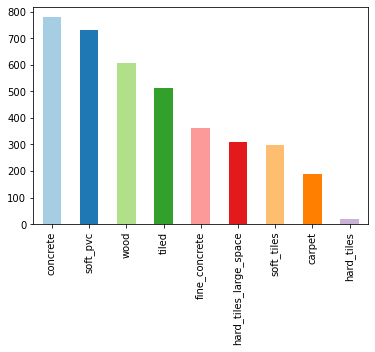

In [7]:
#Bar plot
sizes = [i for i in result['surface'].value_counts()]
fig, ax = plt.subplots()
result['surface'].value_counts().plot.bar(ax = ax, color=plt.cm.Paired(np.arange(len(result['surface'].value_counts()))))

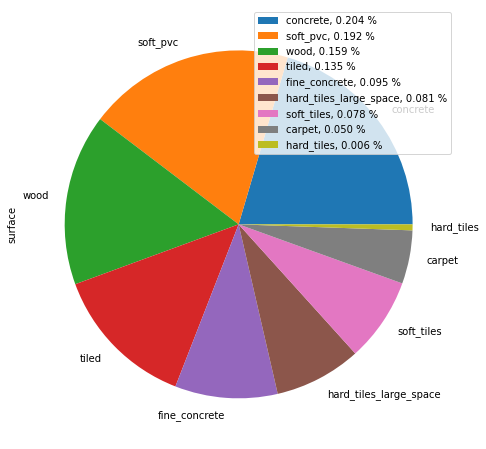

In [8]:
#Pie plot
percentage = [i/sum(result['surface'].value_counts()) for i in result['surface'].value_counts()]
labels = ['concrete','soft_pvc','wood','tiled','fine_concrete','hard_tiles_large_space','soft_tiles','carpet','hard_tiles']

fig, ax = plt.subplots()
result['surface'].value_counts().plot.pie(ax= ax, figsize=(8, 8))
ax.legend(['%s, %0.03f %%' % (l, p) for l, p in zip(labels, percentage)])

As can be observed from the above plots, the dataset is imbalanced and 'hard_tiles' has the least percentage within the datapoints, while maximum percentage of the surface is 'concrete'. 

### Correlations between each feature 

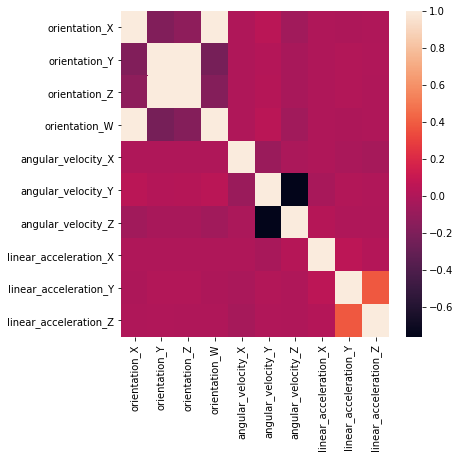

In [9]:
import seaborn as sns
#correlations = data.corr(method='pearson')

fig, ax = plt.subplots(figsize=(6,6))   
sns.heatmap(data.drop(columns = ['series_id', 'measurement_number']).corr())

- We should expect minimum correlation between the features and as can be observed from the above, correlation is almost 0 for most features
- Correlation between 'angular_velocity_Y' and 'angular_velocity_Z' is almost =<-0.6 indicating negative relationship
- Features 'orientation_X' and 'orientation_W' also seem positively correlated and so are 'orientation_Y' and 'orientation_Z' with correlation coefficient equal to almost 1

Since the Orientation features seem correlated, we try to plot correlation heatmap using the Euler angles istead.

In [10]:
# https://stackoverflow.com/questions/54214698/quaternion-to-yaw-pitch-roll
#https://www.kaggle.com/wolfy73/robots-need-help

import math
def calculate_yaw(qx, qy, qz, qw):
    yaw = math.atan2(2.0*(qy*qz + qw*qx), qw*qw - qx*qx - qy*qy + qz*qz)
    return yaw

def calculate_pitch(qx, qy, qz, qw):
    t = -qx*qz + qw*qy
    t = 1 if t>1 else t
    t = -1 if t<-1 else t
    pitch = math.asin(2.0*(t))
    return pitch

def calculate_roll(qx, qy, qz, qw):
    roll = math.atan2(2.0*(qx*qy + qw*qz), qw*qw + qx*qx - qy*qy - qz*qz)
    return roll

In [11]:
yaw = [calculate_yaw(qx,qy,qz,qw) for qx,qy,qz,qw in zip(data['orientation_X'], data['orientation_Y'],data['orientation_Z'],data['orientation_W']) ]
pitch = [calculate_pitch(qx,qy,qz,qw) for qx,qy,qz,qw in zip(data['orientation_X'], data['orientation_Y'],data['orientation_Z'],data['orientation_W']) ]
roll = [calculate_roll(qx,qy,qz,qw) for qx,qy,qz,qw in zip(data['orientation_X'], data['orientation_Y'],data['orientation_Z'],data['orientation_W']) ]

In [12]:
data['euler_angle_X'] = roll
data['euler_angle_Y'] = pitch
data['euler_angle_Z'] = yaw

In [13]:
data_ = data.drop(columns = ['orientation_X','orientation_Y','orientation_Z', 'orientation_W'])

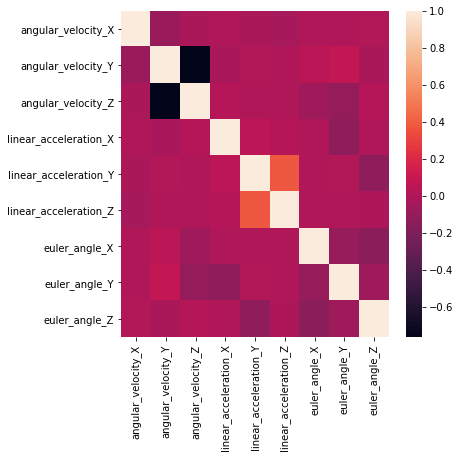

In [14]:
fig, ax = plt.subplots(figsize=(6,6))   
sns.heatmap(data_.drop(columns = ['series_id', 'measurement_number']).corr())

Thus we use the Euler angles instead of the orientation values since correlation between them is much lesser.

### Density plots for each feature 

In [15]:
#Reference: https://stackoverflow.com/questions/17071871/how-to-select-rows-from-a-dataframe-based-on-column-values

def density_plots(data,result, feature, ax):
    #Plot density plots for all the output classes for each feature
    data[data['series_id'].isin(result[result['surface'] == 'concrete']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'soft_pvc']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'wood']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'tiled']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'fine_concrete']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'hard_tiles_large_space']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'soft_tiles']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'carpet']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'hard_tiles']['series_id'])][feature].plot.density(ax = ax)
    ax.legend(['concrete','soft_pvc','wood','tiled','fine_concrete','hard_tiles_large_space','soft_tiles','carpet','hard_tiles'])
    ax.set(xlabel=feature, ylabel='density')
    

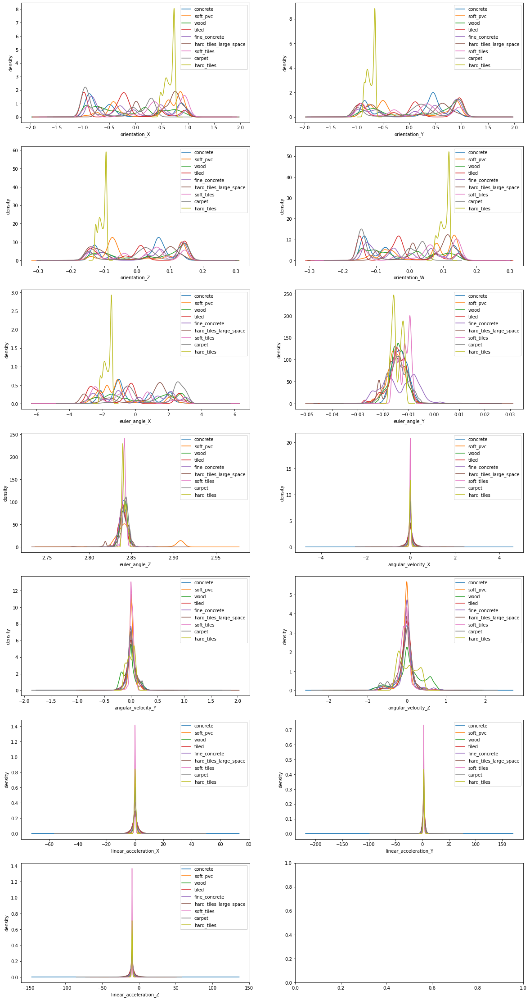

Wall time: 2min 45s


In [16]:
%%time

#https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html
#https://python.tutorialink.com/how-to-fix-numpy-ndarray-object-has-no-attribute-get_figure-when-plotting-subplots/

feature = ['orientation_X','orientation_Y','orientation_Z', 'orientation_W','euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']

fig, ax = plt.subplots(nrows = 7, ncols= 2, figsize =(20, 40))
ax = ax.ravel()

for j in range(0, len(feature)):
    density_plots(data, result, feature[j], ax[j])
    
plt.show()

Observations :
- We can clearly observe some peaks in the orientation channels for the output class 'hard_tiles', but most of the other distributions seem correlated over a certain bandwidth.
- Angular velocity distributions for all the classes show some deviations for angular_velocity_Z, but the distributions are mostly overlapping for all the classes for angular_velocity_X and angular_velocity_Y.
- Linear acceleration channels present almost overlapping distributions for all the classes.

### Plot the time series values of the signal for each feature

In [17]:
def plot_time_series(units, feature, ax):
    for  i in range(0, units):
        line = data[data['series_id'] == i+1][feature].plot( kind = 'line', ax =ax)
    ax.set(xlabel = 'time', ylabel = feature)
    ax.legend(['series_id_{}'.format(i) for i in range(0,units)])

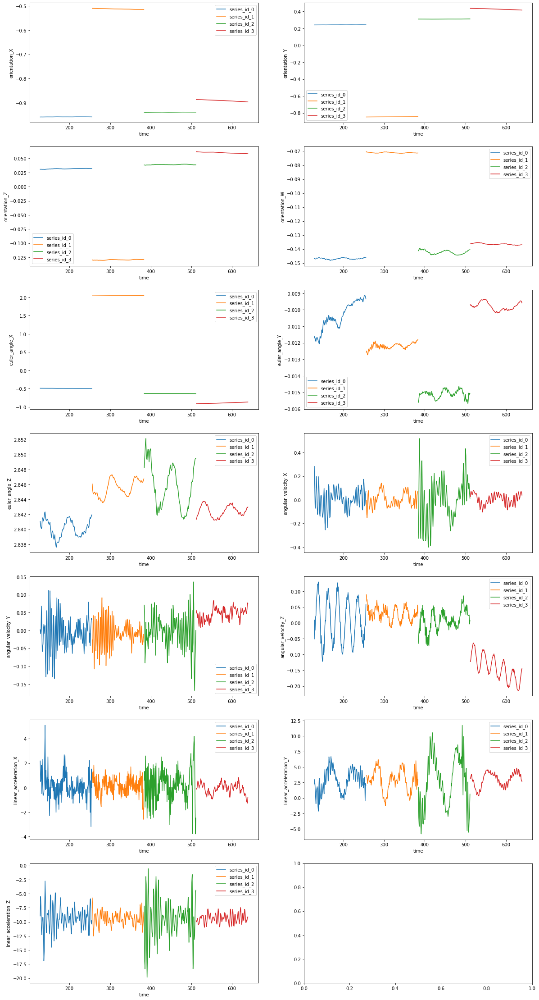

In [18]:
fig, ax = plt.subplots(nrows = 7, ncols= 2, figsize =(20,40))
ax = ax.ravel()

for j in range(0, len(feature)):
    plot_time_series(4, feature[j], ax[j])
    
plt.show()

### Calculate stats for the signal

In [21]:
data_1 = data.drop(columns = ['series_id', 'measurement_number'])
data_1.describe()

,orientation_X,orientation_Y,orientation_Z,orientation_W,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z,euler_angle_X,euler_angle_Y,euler_angle_Z
count,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000,487680.000000
mean,-0.018050,0.075062,0.012458,-0.003804,0.000178,0.008338,-0.019184,0.129281,2.886468,-9.364886,-0.278371,-0.014035,2.842559
std,0.685696,0.708226,0.105972,0.104299,0.117764,0.088677,0.229153,1.870600,2.140067,2.845341,1.802029,0.003923,0.012617
min,-0.989100,-0.989650,-0.162830,-0.156620,-2.371000,-0.927860,-1.268800,-36.067000,-121.490000,-75.386000,-3.141588,-0.032360,2.778661
25%,-0.705120,-0.688980,-0.089466,-0.106060,-0.040752,-0.033191,-0.090743,-0.530833,1.957900,-10.193000,-1.752289,-0.016353,2.837915
50%,-0.105960,0.237855,0.031949,-0.018704,0.000084,0.005412,-0.005335,0.124980,2.879600,-9.365300,-0.798362,-0.014006,2.841058
75%,0.651803,0.809550,0.122870,0.097215,0.040527,0.048068,0.064604,0.792263,3.798800,-8.522700,1.423355,-0.011416,2.844004
max,0.989100,0.988980,0.155710,0.154770,2.282200,1.079100,1.387300,36.797000,73.008000,65.839000,3.141576,0.010733,2.917180


In [20]:
result.describe()

,series_id,group_id
count,3810.000000,3810.000000
mean,1904.500000,37.601312
std,1099.996591,20.982743
min,0.000000,0.000000
25%,952.250000,19.000000
50%,1904.500000,39.000000
75%,2856.750000,55.000000
max,3809.000000,72.000000


### Take FFT of the signals

#### Take FFT and PSD of signal 

In [21]:
#https://dsp.stackexchange.com/questions/60470/minimum-sample-frequency-of-imu-accelerometer-and-gyroscope

def plot_fft_signal(i, feature, ax):
    line = data[data['series_id'] == i][feature]
    SAMPLE_RATE = 128                 #Number of samples in one second
    N = 128                           #Length of the signal
    xf = fftshift(fftfreq(N, 1 / SAMPLE_RATE))
    yf = fftshift(fft(np.asarray(line)))        #FFT 
    
    PSD = yf*np.conj(yf)/N            #PSD

    plt.plot(xf, yf, label = 'fft')
    plt.plot(xf, PSD, label = 'PSD')
    
    plt.title('series_id {} of '.format(i)+feature)
    plt.xlabel('frequency')
    plt.ylabel(feature)
    plt.legend()

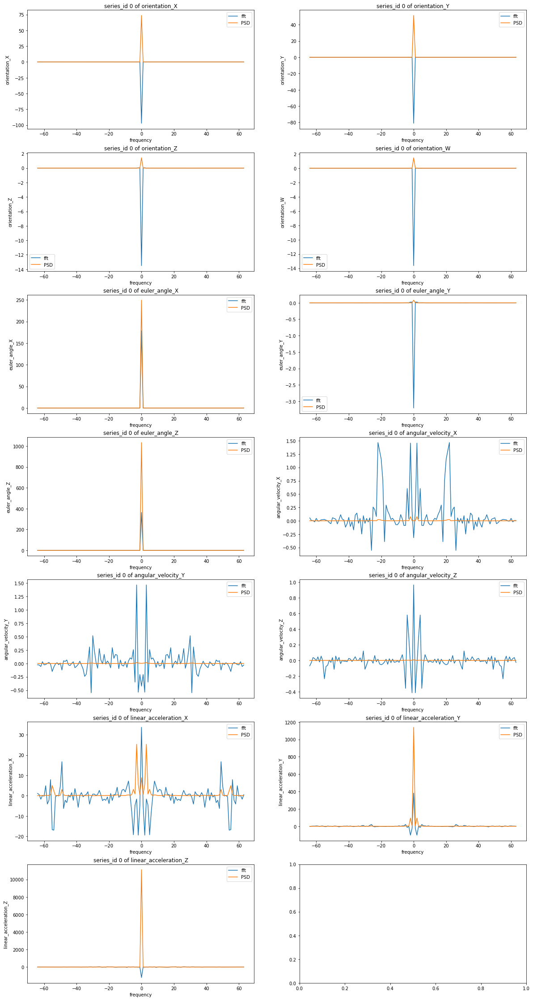

In [22]:
fig, ax = plt.subplots(nrows = 7, ncols= 2, figsize =(20,40))
ax = ax.ravel()

for j in range(0, len(feature)):
    plt.subplot(7,2,j+1)
    plot_fft_signal(0, feature[j], ax[j])
    
plt.show()

 Difference between FFT and PSD: https://dsp.stackexchange.com/questions/24780/power-spectral-density-vs-fft-bin-magnitude
 - PSD is the square of the conjugate of the DFT of the signal
 - PSD  considers only the real value and gives information about the energy of the signal i.e. amplitude squared value unlike FFT

Observations:
- FFT of the signal tells us about the information present at which frequency with frequency as the x axis
- As can be observed from the above plots, denoising the orientation channels is not required, since all the information is only present at a certain frequency

#### Plot FFT and the peaks 

In [140]:
#https://peakutils.readthedocs.io/en/latest/tutorial_a.html

def plot_fft_peaks_signal(i, feature, ax):
    
    line = data_[data_['series_id'] == i][feature]
    SAMPLE_RATE = 128  #Number of samples in one second
    N = 128   #Length of the signal
    xf = fftshift(fftfreq(N, 1/SAMPLE_RATE))
    yf = fftshift(fft(np.asarray(line)))
    plt.plot(xf, yf, label = 'fft')

    #Print the peaks
    fft_peaks = peakutils.indexes(yf, thres = 0.5)
    
    #Plot the peaks
    xf_ = list(xf)
    xf_1 = [xf[i] for i in fft_peaks]
    peaks = [yf[i] for i in fft_peaks]
    #if len(fft_peaks) < 15:
    #    for i in range(len(fft_peaks)):
    #        plt.plot(xf_1[i], peaks[i], label = 'fft peaks')
    
    plt.scatter(xf_1, peaks, s= 50, label = 'fft peaks', c = "red")
    
    plt.title('series_id {} of '.format(i)+feature)
    plt.xlabel('frequency')
    plt.ylabel(feature)
    plt.legend()
    
    return fft_peaks

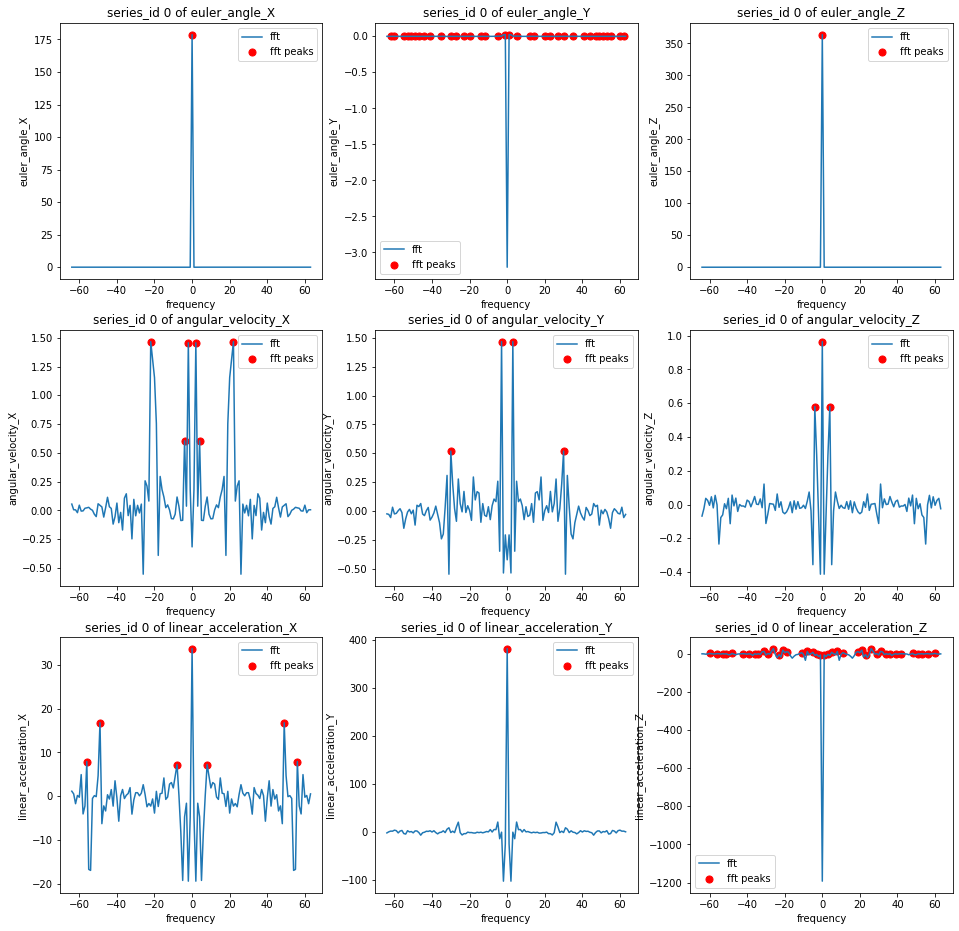

In [141]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(16,16))
ax = ax.ravel()
fft_peaks_feature = []

#Without orientation features
feature_ = ['euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']

for j in range(0, len(feature_)):
    plt.subplot(3,3,j+1)
    fft_peaks = plot_fft_peaks_signal(0, feature_[j], ax[j])
    fft_peaks_feature.append(fft_peaks)
    
plt.show()

In [85]:
for ind, i in enumerate(fft_peaks_feature):
    if len(i) <15:
        print('Peaks of feature,',feature_[ind],': ',i)

Peaks of feature, euler_angle_Z :  [64]
Peaks of feature, angular_velocity_X :  [38 42 45 60 62 66 68 83 86 90]
Peaks of feature, angular_velocity_Y :  [32 64 96]
Peaks of feature, linear_acceleration_Y :  [64]


Adding indices of FFT peaks as features

In [266]:
#Find the indices of the peaks
fft_indices = []
feature_ = ['euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']
for i in range(0, 3810):
    
    fft_indices_feature = {}
    
    for feature in feature_:
        line = data[data['series_id'] == i][feature]
        yf = fftshift(fft(np.asarray(line)))
        fft_peaks = peakutils.indexes(yf, thres = 0.5)
        if len(fft_peaks) <15:
            fft_indices_feature[feature] = fft_peaks
    
    fft_indices.append(fft_indices_feature)

In [267]:
fft_indices_ = pd.DataFrame(fft_indices)
fft_indices_.head()

,euler_angle_X,euler_angle_Z,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,euler_angle_Y,linear_acceleration_Z
0,[64],[64],"[42, 60, 62, 66, 68, 86]","[34, 61, 67, 94]","[60, 64, 68]","[8, 15, 56, 64, 72, 113, 120]",[64],NaN,NaN
1,NaN,[64],"[38, 43, 62, 66, 85, 90]",NaN,"[34, 53, 55, 61, 64, 67, 73, 75, 94]",NaN,[64],NaN,NaN
2,[64],[64],NaN,NaN,[64],"[9, 16, 49, 60, 64, 68, 79, 112, 119]",[64],NaN,NaN
3,NaN,[64],NaN,NaN,NaN,NaN,"[26, 38, 60, 64, 68, 90, 102]",NaN,NaN
4,NaN,[64],"[45, 62, 64, 66, 83]",[64],NaN,NaN,[64],NaN,NaN


All features except 'euler_angle_Y' and 'linear_acceleration_Y' seem to have peak magnitudes at regular intervals

In [268]:
fft_indices_ = fft_indices_.drop(columns = ['euler_angle_Y','linear_acceleration_Z'])
fft_indices_ = fft_indices_.fillna(0)

In [273]:
#Number of indices to add for each feature 
max_len = []
len_indices_col = {}
for ind, f in enumerate(fft_indices_.columns):
    len_indices = [int(len(list(fft_indices_[f].loc[i]))) if type(fft_indices_[f].loc[i]) == np.ndarray else 0 for i in range(0, 3810) ]
    max_len.append(max([ int(len(list(fft_indices_[f].loc[i]))) for i in range(0, 3810) if type(fft_indices_[f].loc[i]) == np.ndarray ]) )
    len_indices_col[f] = len_indices
print(max_len)


[14, 1, 14, 14, 14, 14, 11]


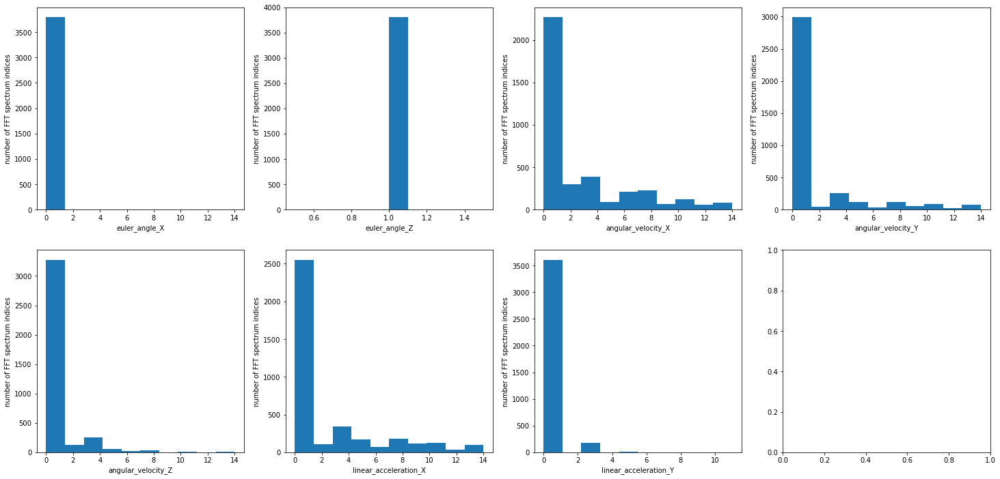

Wall time: 890 ms


In [276]:
#Histogram of the number of spectrum indices
%%time
len_indices_df = pd.DataFrame(len_indices_col)

feature_set = fft_indices_.columns

fig, ax = plt.subplots(nrows = 2, ncols= 4, figsize =(25,12))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    len_indices_df[feature_set[j]].plot.hist(ax = ax[j])
    ax[j].set(xlabel=feature_set[j], ylabel='number of FFT spectrum indices')
    
plt.show()

In [277]:
from collections import Counter

def find_most_occuring_element(feature,indice_array,y):
    full_list = []
    for i in indice_array[feature]:
        if type(i) == np.ndarray:
            full_list.extend(i)
    occurence_count = dict(Counter(full_list))
    return list(occurence_count)[:y]

In [282]:
#Find the values and indices
max_val = []
for ind, f in enumerate(fft_indices_.columns):
    max_val.append(find_most_occuring_element(f,fft_indices_,14))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]


#Create the main array and fill in the same indices
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(fft_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    for i in range(0, 3810):
        if type(fft_indices_[f].loc[i]) == np.ndarray:
            
            #print(f1_array[i, :])
            for j , index in enumerate(max_val[ind]):
                if index in fft_indices_[f].loc[i]:
                    f1_array[i, j] = max_val[ind][j]
            #print(f1_array[i, :])
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array

(3810, 14) 0
(3810, 1) 14
(3810, 14) 15
(3810, 14) 29
(3810, 14) 43
(3810, 14) 57
(3810, 14) 71


In [285]:
fft_indices_df = pd.DataFrame(main_array, columns = [f+'_fft_indices_'+str(i) for ind,f in enumerate(fft_indices_.columns) for i in range(0,max_len[ind]) ])
fft_indices_df.head(20)

,euler_angle_X_fft_indices_0,euler_angle_X_fft_indices_1,euler_angle_X_fft_indices_2,euler_angle_X_fft_indices_3,euler_angle_X_fft_indices_4,euler_angle_X_fft_indices_5,euler_angle_X_fft_indices_6,euler_angle_X_fft_indices_7,euler_angle_X_fft_indices_8,euler_angle_X_fft_indices_9,...,linear_acceleration_Y_fft_indices_4,linear_acceleration_Y_fft_indices_5,linear_acceleration_Y_fft_indices_6,linear_acceleration_Y_fft_indices_7,linear_acceleration_Y_fft_indices_8,linear_acceleration_Y_fft_indices_9,linear_acceleration_Y_fft_indices_10,linear_acceleration_Y_fft_indices_11,linear_acceleration_Y_fft_indices_12,linear_acceleration_Y_fft_indices_13
0,64.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,64.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,68.0,90.0,102.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,64.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Plot PSD of signal and its peaks 

In [186]:
def plot_psd_peaks_signal(i, feature, ax):
    
    line = data[data['series_id'] == i][feature]
    SAMPLE_RATE = 128              #Number of samples in one second
    N = 128                        #Length of the signal
    xf = fftshift(fftfreq(N, 1 / SAMPLE_RATE))
    yf = fftshift(fft(np.asarray(line)))
    PSD = yf*np.conj(yf)/N
    plt.plot(xf, PSD, label = 'PSD')

    #Print the peaks
    psd_peaks = peakutils.indexes(PSD, thres = 0.5)
    
    #Plot the peaks
    xf_ = list(xf)
    xf_1 = [xf[i] for i in psd_peaks]
    peaks = [PSD[i] for i in psd_peaks]
    
    plt.scatter(xf_1, peaks, s= 50, label = 'PSD peaks', c = "red")
    
    plt.title('series_id {} of '.format(i)+feature)
    plt.xlabel('frequency')
    plt.ylabel(feature)
    plt.legend()
    
    return psd_peaks

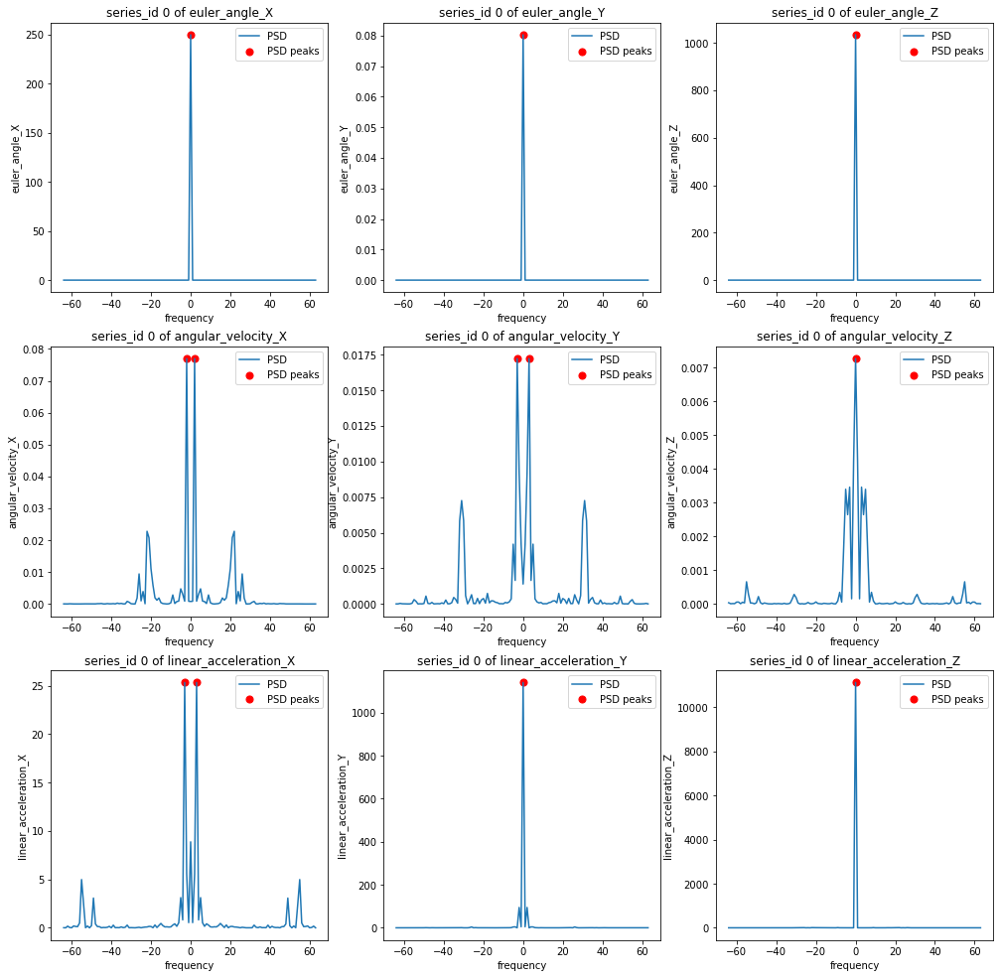

In [187]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(17,17))
ax = ax.ravel()
psd_peaks_feature = []
#Without orientation features
feature_ = ['euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']

for j in range(0, len(feature_)):
    plt.subplot(3,3,j+1)
    psd_peaks = plot_psd_peaks_signal(0, feature_[j], ax[j])
    psd_peaks_feature.append(psd_peaks)
    
plt.show()


In [188]:
for ind, i in enumerate(psd_peaks_feature):
    print('Peaks of feature,',feature[ind],': ',i)

Peaks of feature, l :  [64]
Peaks of feature, i :  [64]
Peaks of feature, n :  [64]
Peaks of feature, e :  [62 66]
Peaks of feature, a :  [61 67]
Peaks of feature, r :  [64]
Peaks of feature, _ :  [61 67]
Peaks of feature, a :  [64]
Peaks of feature, c :  [64]


In [189]:
psd_indices = []
N = 128
feature = ['orientation_X','orientation_Y','orientation_Z', 'orientation_W','euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']
for i in range(0, 3810):
    
    psd_indices_feature = {}
    
    for feature_ in feature:
        line = data[data['series_id'] == i][feature_]
        yf = fftshift(fft(np.asarray(line)))
        PSD = yf*np.conj(yf)/N
        psd_peaks = peakutils.indexes(PSD, thres = 0.5)
        if len(psd_peaks) <15:
            psd_indices_feature[feature_] = psd_peaks
    
    psd_indices.append(psd_indices_feature)

In [190]:
psd_indices_ = pd.DataFrame(psd_indices)
psd_indices_.head()

,orientation_X,orientation_Y,orientation_Z,orientation_W,euler_angle_X,euler_angle_Y,euler_angle_Z,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z
0,[64],[64],[64],[64],[64],[64],[64],"[62, 66]","[61, 67]",[64],"[61, 67]",[64],[64]
1,[64],[64],[64],[64],[64],[64],[64],"[43, 62, 66, 85]","[33, 95]","[59, 69]","[9, 119]",[64],[64]
2,[64],[64],[64],[64],[64],[64],[64],"[60, 62, 66, 68]","[34, 94]",[64],"[9, 119]",[64],[64]
3,[64],[64],[64],[64],[64],[64],[64],"[43, 62, 66, 85]","[33, 95]","[59, 62, 66, 69]","[9, 119]","[62, 64, 66]",[64]
4,[64],[64],[64],[64],[64],[64],[64],"[62, 66]",[64],[64],"[61, 67]",[64],[64]


In [192]:
#Drop columns that do not have enough PSD peaks and orientation features
psd_indices_ = psd_indices_.drop(columns = ['orientation_X','orientation_Y','orientation_Z','orientation_W'])
psd_indices_ = psd_indices_.fillna(0)

In [193]:
#Number of indices to add for each feature 
max_len = []
len_indices_col = {}
for ind, f in enumerate(psd_indices_.columns):
    len_indices = [int(len(list(psd_indices_[f].loc[i]))) if type(psd_indices_[f].loc[i]) == np.ndarray else 0 for i in range(0, 3810) ]
    max_len.append(max([ int(len(list(psd_indices_[f].loc[i]))) for i in range(0, 3810) if type(psd_indices_[f].loc[i]) == np.ndarray ]) )
    len_indices_col[f] = len_indices
print(max_len)

[2, 2, 1, 14, 13, 13, 14, 9, 3]


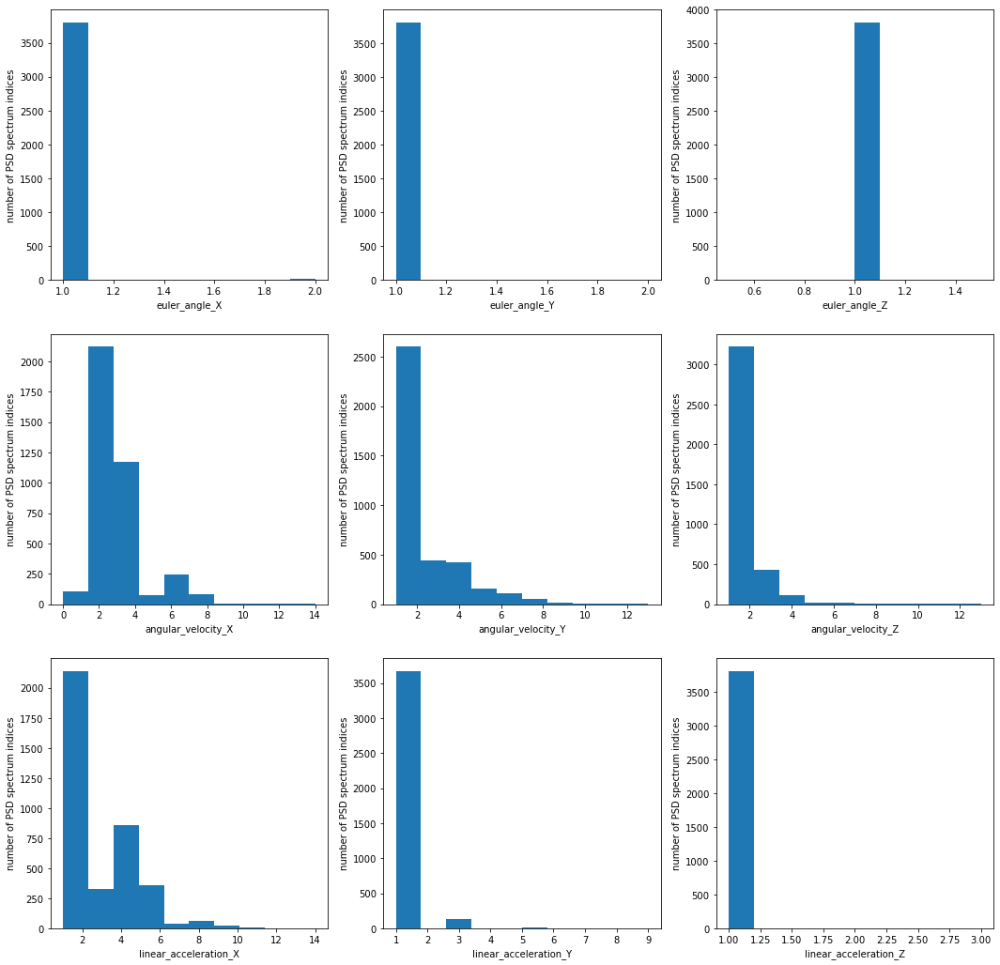

Wall time: 990 ms


In [198]:
%%time
len_indices_df = pd.DataFrame(len_indices_col)

feature_set = psd_indices_.columns

fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(18,18))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    len_indices_df[feature_set[j]].plot.hist(ax = ax[j])
    ax[j].set(xlabel=feature_set[j], ylabel='number of PSD spectrum indices')
    
plt.show()

In [206]:
#Find the most occuring spectrum indices
max_val = []
for ind, f in enumerate(psd_indices_.columns):
    max_val.append(find_most_occuring_element(f,psd_indices_,10))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]

#Fill the main array
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(psd_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    for i in range(0, 3810):
        if type(psd_indices_[f].loc[i]) == np.ndarray:
            
            for j , index in enumerate(max_val[ind]):
                if index in psd_indices_[f].loc[i]:
                    f1_array[i, j] = max_val[ind][j]
            #print(f1_array[i, :])
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array


(3810, 3) 0
(3810, 5) 3
(3810, 1) 8
(3810, 10) 9
(3810, 10) 19
(3810, 10) 29
(3810, 10) 39
(3810, 10) 49
(3810, 3) 59


In [209]:
psd_indices_df = pd.DataFrame(main_array, columns = [f+'_psd_indices_'+str(i) for ind, f in enumerate(psd_indices_.columns) for i in range(0,max_len[ind]) ])
psd_indices_df.head(20)

,euler_angle_X_psd_indices_0,euler_angle_X_psd_indices_1,euler_angle_X_psd_indices_2,euler_angle_Y_psd_indices_0,euler_angle_Y_psd_indices_1,euler_angle_Y_psd_indices_2,euler_angle_Y_psd_indices_3,euler_angle_Y_psd_indices_4,euler_angle_Z_psd_indices_0,angular_velocity_X_psd_indices_0,...,linear_acceleration_Y_psd_indices_3,linear_acceleration_Y_psd_indices_4,linear_acceleration_Y_psd_indices_5,linear_acceleration_Y_psd_indices_6,linear_acceleration_Y_psd_indices_7,linear_acceleration_Y_psd_indices_8,linear_acceleration_Y_psd_indices_9,linear_acceleration_Z_psd_indices_0,linear_acceleration_Z_psd_indices_1,linear_acceleration_Z_psd_indices_2
0,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
1,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
2,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
3,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
4,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
5,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
6,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
7,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
8,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0
9,64.0,0.0,0.0,64.0,0.0,0.0,0.0,0.0,64.0,62.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,0.0,0.0


#### Plot Autocorrelation of signal 

How to understand an autocorrelation plot python: https://www.geeksforgeeks.org/python-pandas-plotting-the-autocorrelation-plot/
- Autocorrelation plots are a commonly used tool for checking randomness in a data set. This randomness is ascertained by computing autocorrelation for data values at varying time lags. It shows the properties of a type of data known as a time series.
- Ranging from +1 (strong positive correlation) to -1 (strong negative correlation) at each lag value (plotted on x axis)

#### Plot peaks of an autocorrelation plot 

In [210]:
def plot_acf_peaks_signal(i, feature, ax):
    
    line = data[data['series_id'] == i][feature]
    acf = sm.tsa.acf(line)
    xf = range(0,len(acf))
    plt.plot(xf, acf, label = 'acf')

    #Print the peaks
    acf_peaks = peakutils.indexes(acf, thres = 0.25)
    
    #Plot the peaks
    xf_ = list(xf)
    xf_1 = [xf[i] for i in acf_peaks]
    peaks = [acf[i] for i in acf_peaks]
    
    plt.scatter(xf_1, peaks, s= 50, label = 'acf peaks', c = "red")
    
    plt.title('series_id {} of '.format(i)+feature)
    plt.xlabel('lag')
    plt.ylabel(feature)
    plt.legend()
    
    return acf_peaks

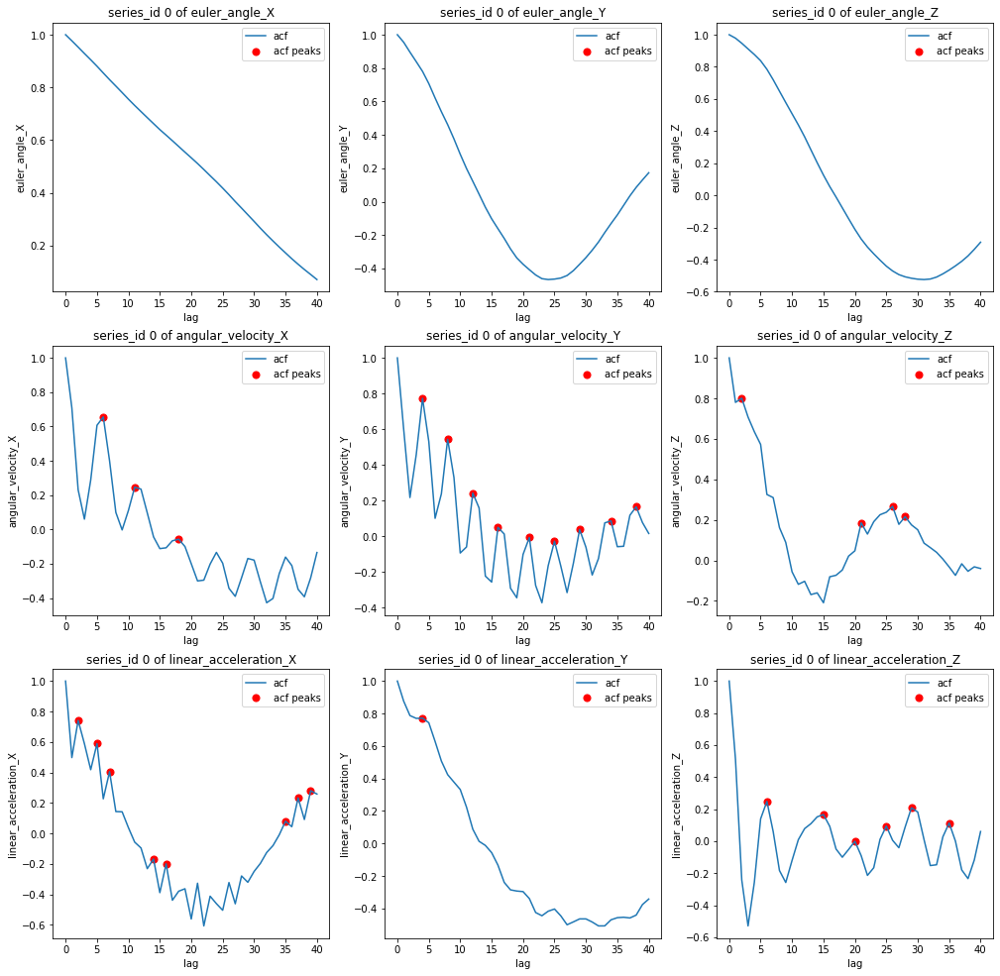

In [211]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(17,17))
ax = ax.ravel()
acf_peaks_feature = []
#Without orientation features
feature_ = ['euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']

for j in range(0, len(feature_)):
    plt.subplot(3,3,j+1)
    lag_values = plot_acf_peaks_signal(0, feature_[j], ax[j])
    acf_peaks_feature.append(lag_values)
    
plt.show()

In [212]:
for ind, i in enumerate(acf_peaks_feature):
    print('For feature,',feature[ind],' peaks of ACF is at lag value : ',i)

For feature, orientation_X  peaks of ACF is at lag value :  []
For feature, orientation_Y  peaks of ACF is at lag value :  []
For feature, orientation_Z  peaks of ACF is at lag value :  []
For feature, orientation_W  peaks of ACF is at lag value :  [ 6 11 18]
For feature, euler_angle_X  peaks of ACF is at lag value :  [ 4  8 12 16 21 25 29 34 38]
For feature, euler_angle_Y  peaks of ACF is at lag value :  [ 2 21 26 28]
For feature, euler_angle_Z  peaks of ACF is at lag value :  [ 2  5  7 14 16 35 37 39]
For feature, angular_velocity_X  peaks of ACF is at lag value :  [4]
For feature, angular_velocity_Y  peaks of ACF is at lag value :  [ 6 15 20 25 29 35]


In [213]:
acf_indices = []
feature = ['orientation_X','orientation_Y','orientation_Z', 'orientation_W','euler_angle_X', 'euler_angle_Y','euler_angle_Z','angular_velocity_X','angular_velocity_Y','angular_velocity_Z', 'linear_acceleration_X', 'linear_acceleration_Y','linear_acceleration_Z']
for i in range(0, 3810):
    
    acf_indices_feature = {}
    
    for feature_ in feature:
        line = data[data['series_id'] == i][feature_]
        acf = sm.tsa.acf(line)
        acf_peaks = peakutils.indexes(acf, thres = 0.5)
        if len(acf_peaks) <15:
            acf_indices_feature[feature_] = acf_peaks
    
    acf_indices.append(acf_indices_feature)

In [214]:
acf_indices_ = pd.DataFrame(acf_indices)
acf_indices_.head()

,orientation_X,orientation_Y,orientation_Z,orientation_W,euler_angle_X,euler_angle_Y,euler_angle_Z,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z
0,[],[],[],[],[],[],[],[6],"[4, 8]",[2],"[2, 5, 7, 37, 39]",[4],[6]
1,[],[24],[],[],[24],[],[],"[6, 12, 18]","[4, 8, 13, 17, 21, 25, 29]",[25],[2],"[5, 9]","[6, 12, 19, 25, 30, 37]"
2,[],[],[],[],[],"[4, 8]",[],[5],"[4, 8, 13, 17, 21, 25, 29, 33, 38]","[21, 25, 28]","[2, 7, 28]",[3],[]
3,[],[],[],[],[],[],[],"[6, 12]","[4, 8]",[2],"[2, 7]","[4, 10]","[6, 12, 19, 25, 30, 36]"
4,[],[],[],[],[],[],[],"[6, 12]",[4],[24],[7],[4],"[6, 13, 19, 25]"


In [215]:
#Drop columns that do not have enough ACF peaks
acf_indices_ = acf_indices_.drop(columns = ['euler_angle_X','euler_angle_Z', 'euler_angle_Y','orientation_X','orientation_Y','orientation_Z','orientation_W'])
acf_indices_ = acf_indices_.fillna(0)

In [216]:
#Number of indices to add for each feature 
max_len = []
len_indices_col = {}
for ind, f in enumerate(acf_indices_.columns):
    len_indices = [int(len(list(acf_indices_[f].loc[i]))) if type(acf_indices_[f].loc[i]) == np.ndarray else 0 for i in range(0, 3810) ]
    max_len.append(max([ int(len(list(acf_indices_[f].loc[i]))) for i in range(0, 3810) if type(acf_indices_[f].loc[i]) == np.ndarray ]) )
    len_indices_col[f] = len_indices
print(max_len)


[8, 9, 10, 14, 8, 8]


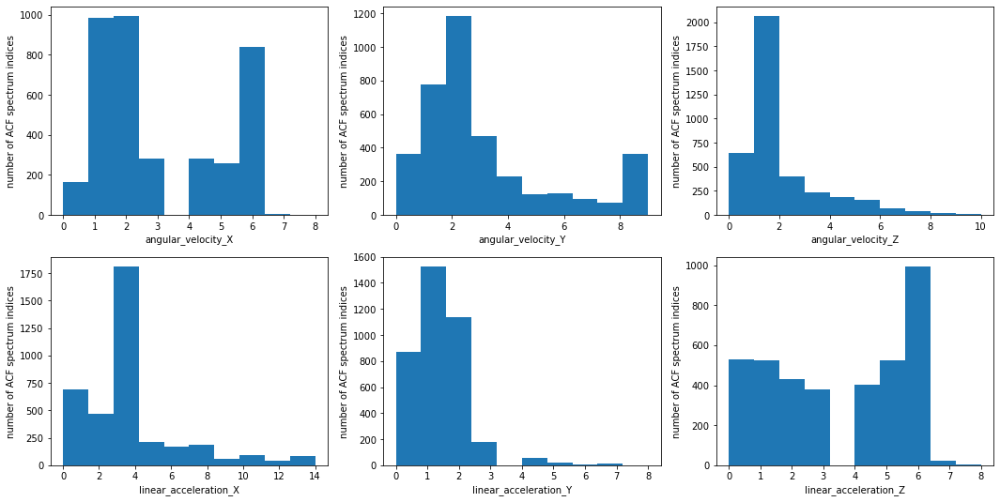

Wall time: 637 ms


In [222]:
%%time
len_indices_df = pd.DataFrame(len_indices_col)

feature_set = acf_indices_.columns

fig, ax = plt.subplots(nrows = 2, ncols= 3, figsize =(18,9))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    len_indices_df[feature_set[j]].plot.hist(ax = ax[j])
    ax[j].set(xlabel=feature_set[j], ylabel='number of ACF spectrum indices')
    
plt.show()

In [224]:
#Find the most occuring indices
max_val = []
for ind, f in enumerate(acf_indices_.columns):
    max_val.append(find_most_occuring_element(f,acf_indices_,10))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]

#Fill in the main array
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(acf_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    for i in range(0, 3810):
        if type(acf_indices_[f].loc[i]) == np.ndarray:
            
            for j , index in enumerate(max_val[ind]):
                if index in acf_indices_[f].loc[i]:
                    f1_array[i, j] = max_val[ind][j]
            #print(f1_array[i, :])
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array


(3810, 10) 0
(3810, 10) 10
(3810, 10) 20
(3810, 10) 30
(3810, 10) 40
(3810, 10) 50


In [226]:
acf_indices_df = pd.DataFrame(main_array, columns = [f+'_acf_indices_'+str(i) for ind, f in enumerate(acf_indices_.columns) for i in range(0,max_len[ind]) ])
acf_indices_df.head()

,angular_velocity_X_acf_indices_0,angular_velocity_X_acf_indices_1,angular_velocity_X_acf_indices_2,angular_velocity_X_acf_indices_3,angular_velocity_X_acf_indices_4,angular_velocity_X_acf_indices_5,angular_velocity_X_acf_indices_6,angular_velocity_X_acf_indices_7,angular_velocity_X_acf_indices_8,angular_velocity_X_acf_indices_9,...,linear_acceleration_Z_acf_indices_0,linear_acceleration_Z_acf_indices_1,linear_acceleration_Z_acf_indices_2,linear_acceleration_Z_acf_indices_3,linear_acceleration_Z_acf_indices_4,linear_acceleration_Z_acf_indices_5,linear_acceleration_Z_acf_indices_6,linear_acceleration_Z_acf_indices_7,linear_acceleration_Z_acf_indices_8,linear_acceleration_Z_acf_indices_9
0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,6.0,12.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,12.0,19.0,25.0,30.0,37.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,12.0,19.0,25.0,30.0,0.0,36.0,0.0,0.0,0.0
4,6.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,19.0,25.0,0.0,0.0,0.0,13.0,0.0,0.0


In [286]:
#concatenate all the indices feature together
indices_df = pd.concat([fft_indices_df,psd_indices_df,acf_indices_df], axis = 1)
indices_df.head()

,euler_angle_X_fft_indices_0,euler_angle_X_fft_indices_1,euler_angle_X_fft_indices_2,euler_angle_X_fft_indices_3,euler_angle_X_fft_indices_4,euler_angle_X_fft_indices_5,euler_angle_X_fft_indices_6,euler_angle_X_fft_indices_7,euler_angle_X_fft_indices_8,euler_angle_X_fft_indices_9,...,linear_acceleration_Z_acf_indices_0,linear_acceleration_Z_acf_indices_1,linear_acceleration_Z_acf_indices_2,linear_acceleration_Z_acf_indices_3,linear_acceleration_Z_acf_indices_4,linear_acceleration_Z_acf_indices_5,linear_acceleration_Z_acf_indices_6,linear_acceleration_Z_acf_indices_7,linear_acceleration_Z_acf_indices_8,linear_acceleration_Z_acf_indices_9
0,64.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,12.0,19.0,25.0,30.0,37.0,0.0,0.0,0.0,0.0
2,64.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,12.0,19.0,25.0,30.0,0.0,36.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,19.0,25.0,0.0,0.0,0.0,13.0,0.0,0.0


In [287]:
indices_df.to_csv('data_3.csv', index = False)

In [288]:
%%time
for column in indices_df.columns:
    if column != 'series_id':
        indices_df[column] = indices_df[column].apply(lambda x :x/128)

Wall time: 213 ms


In [289]:
indices_df.to_csv('normalized_data_3.csv', index = False)

### Denoising the signals using PSD

In [71]:
#https://kinder-chen.medium.com/denoising-data-with-fast-fourier-transform-a81d9f38cc4c

def denoise_signal(i, data, feature, threshold):
    line = data[data['series_id'] == i][feature]
    yf = fft(np.asarray(line))
    N = len(yf)
    PSD = yf*np.conj(yf)/N
    yf = np.where(PSD<threshold,0,yf)
    YF = scipy.ifft(yf)
    return line, YF

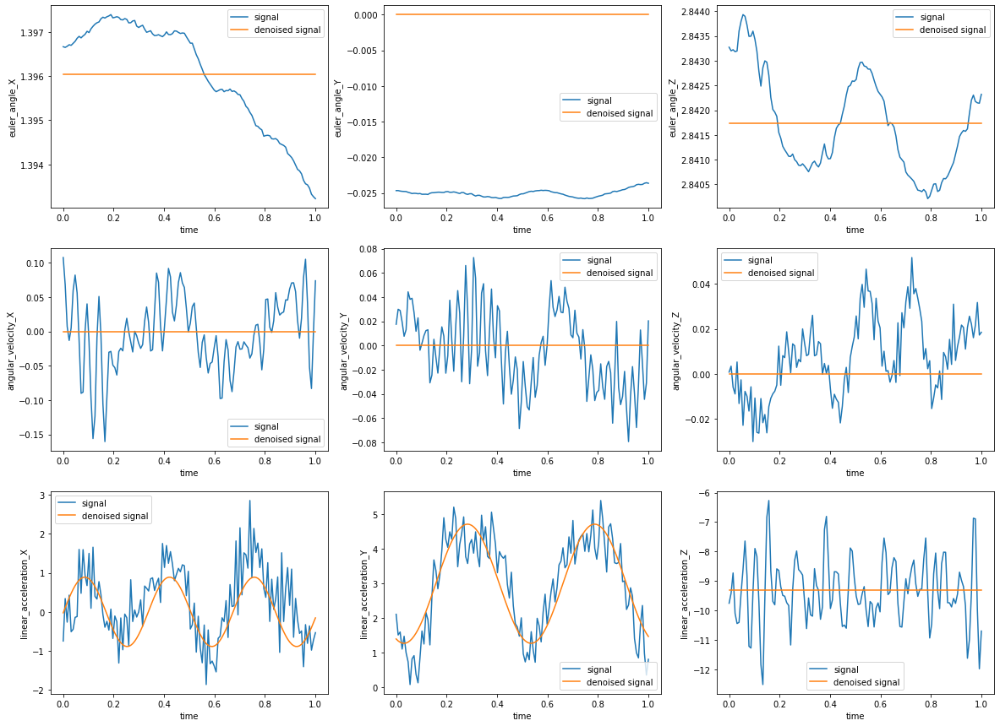

In [72]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(20, 15))
ax = ax.ravel()

threshold = [10,10,10,20,20,20,10,10,10]
feature_ = feature[4:]

for j in range(0, len(feature_)):
    plt.subplot(3,3,j+1)
    sig, YF = denoise_signal(0, data, feature_[j], threshold[j])    #series_id = 0  
    t = np.linspace(0,1,128)
    plt.plot(t, sig, label = 'signal')
    plt.plot(t,YF, label = 'denoised signal')
    plt.xlabel('time')
    plt.ylabel(feature_[j])
    plt.legend()
plt.show()

Observations:
- Since PSD of the signals, angular_velocity_X, angular_velocity_Y, angular_velocity_Z, linear_acceleration_Z have PSD peaks in a range of ~0.001, denoising the signals using the PSD values does not give a good result.

### Denoise by taking the rolling average 

In [73]:
def denoise_signal(i, data, feature):
    line = data[data['series_id'] == i][feature]
    plt.plot(range(0, 128), line, label = 'signal')
        
    #line_rolling_1 = data[data['series_id'] == i][feature].rolling(2)
    #plt.plot(range(0, 128), line_rolling_1.mean(), label = 'rolling mean of signal with window size 2')
    
    line_rolling_2 = data[data['series_id'] == i][feature].rolling(10)
    plt.plot(range(0, 128), line_rolling_2.mean(), label = 'rolling mean of signal with window size 10')
    
    plt.title('series_id {} of {}'.format(i, feature))
    plt.xlabel('time')
    plt.ylabel(feature)
    plt.legend()
    return 

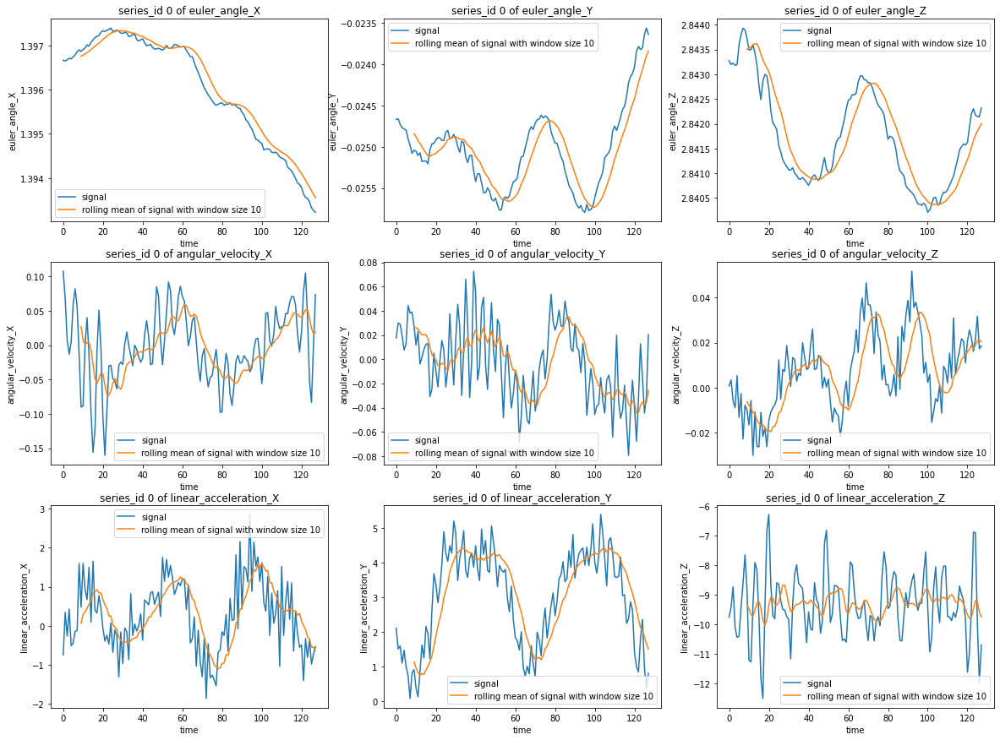

In [74]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(20, 15))
ax = ax.ravel()

feature_ = feature[4:]

for j in range(0, len(feature_)):
    plt.subplot(3,3,j+1)
    denoise_signal(0, data, feature_[j])    #series_id = 0  

plt.show()

In [101]:
#Denoise the data
for i in feature:
    for series_id in range(0,3810):
        data[data['series_id'] == series_id][i] = data[data['series_id'] == series_id][i].rolling(10).mean().fillna(0)

## Feature Engineering

### Statistical features 

Features to be calculated for each series_id:
    - mean
    - min
    - max
    - std
    - max to min change
    - absolute change in mean
    - change in absolute change
    - absolute max
    - absolute min
    - kurtosis

In [75]:
data_.columns

Index(['row_id', 'series_id', 'measurement_number', 'angular_velocity_X',
       'angular_velocity_Y', 'angular_velocity_Z', 'linear_acceleration_X',
       'linear_acceleration_Y', 'linear_acceleration_Z', 'euler_angle_X',
       'euler_angle_Y', 'euler_angle_Z'],
      dtype='object')

In [76]:
feature = data_.drop(columns = ['row_id', 'series_id', 'measurement_number'])

In [77]:
feature

,angular_velocity_X,angular_velocity_Y,angular_velocity_Z,linear_acceleration_X,linear_acceleration_Y,linear_acceleration_Z,euler_angle_X,euler_angle_Y,euler_angle_Z
0,0.107650,0.017561,0.000767,-0.74857,2.1030,-9.7532,1.396667,-0.024668,2.843273
1,0.067851,0.029939,0.003386,0.33995,1.5064,-9.4128,1.396651,-0.024662,2.843201
2,0.007275,0.028934,-0.005978,-0.26429,1.5922,-8.7267,1.396677,-0.024728,2.843222
3,-0.013053,0.019448,-0.008974,0.42684,1.0993,-10.0960,1.396712,-0.024770,2.843183
4,0.005135,0.007652,0.005245,-0.50969,1.4689,-10.4410,1.396698,-0.024784,2.843197
...,...,...,...,...,...,...,...,...,...
487675,0.003167,0.093760,-0.142740,3.27180,2.0115,-9.0063,-1.768407,-0.018571,2.907701
487676,0.014994,0.032637,-0.132380,4.42750,3.0696,-8.1257,-1.768076,-0.018575,2.907732
487677,-0.031184,-0.003961,-0.138940,2.70480,4.2622,-8.1443,-1.767863,-0.018699,2.907659
487678,-0.069153,0.013229,-0.130210,2.54100,4.7130,-9.4435,-1.767539,-0.018655,2.907481


In [78]:
def abs_change(x):
    return np.abs(np.diff(x, append = np.abs(np.diff(x))[-1] ))

In [79]:
feature_list = pd.DataFrame()
feature_list['series_id'] = range(0, 3810)
feature_list.set_index('series_id')

for f in feature:
    feature_list[f+'_mean'] = data_.groupby(['series_id'])[f].mean()
    feature_list[f+'_min'] = data_.groupby(['series_id'])[f].min()
    feature_list[f+'_max'] = data_.groupby(['series_id'])[f].max()
    feature_list[f+'_std'] = data_.groupby(['series_id'])[f].std()
    feature_list[f+'_max_to_min'] = feature_list[f+'_max'] /feature_list[f+'_min']
    feature_list[f+'_abs_change_mean'] = abs_change(feature_list[f+'_mean'])
    feature_list[f+'_abs_change_in_change_mean'] = abs_change(feature_list[f+'_abs_change_mean'])
    feature_list[f+'_abs_min'] = np.abs(data_.groupby(['series_id'])[f].min())
    feature_list[f+'_abs_max'] = np.abs(data_.groupby(['series_id'])[f].max())
    feature_list[f+'_kurtosis'] = data.groupby(['series_id'])[f].apply(pd.DataFrame.kurt)
    

In [81]:
feature_list.head(5)

,series_id,angular_velocity_X_mean,angular_velocity_X_min,angular_velocity_X_max,angular_velocity_X_std,angular_velocity_X_max_to_min,angular_velocity_X_abs_change_mean,angular_velocity_X_abs_change_in_change_mean,angular_velocity_X_abs_min,angular_velocity_X_abs_max,...,euler_angle_Z_mean,euler_angle_Z_min,euler_angle_Z_max,euler_angle_Z_std,euler_angle_Z_max_to_min,euler_angle_Z_abs_change_mean,euler_angle_Z_abs_change_in_change_mean,euler_angle_Z_abs_min,euler_angle_Z_abs_max,euler_angle_Z_kurtosis
0,0,-0.002481,-0.16041,0.107650,0.052800,-0.671093,0.007085,0.005126,0.16041,0.107650,...,2.841734,2.840210,2.843933,0.001001,1.001311,0.001605,0.003795,2.840210,2.843933,-0.962935
1,1,0.004605,-0.25480,0.283420,0.092309,-1.112323,0.001959,0.000063,0.25480,0.283420,...,2.840129,2.837615,2.842328,0.001117,1.001661,0.005400,0.005151,2.837615,2.842328,-1.001900
2,2,0.002646,-0.15271,0.141920,0.060168,-0.929343,0.002022,0.004323,0.15271,0.141920,...,2.845528,2.843556,2.847297,0.001087,1.001315,0.000249,0.003086,2.843556,2.847297,-1.233917
3,3,0.000624,-0.40152,0.519130,0.179544,-1.292912,0.006345,0.007990,0.40152,0.519130,...,2.845777,2.841355,2.852147,0.002907,1.003798,0.003335,0.000269,2.841355,2.852147,-1.164421
4,4,0.006969,-0.10407,0.080904,0.044773,-0.777400,0.014335,0.003450,0.10407,0.080904,...,2.842442,2.841193,2.843737,0.000742,1.000896,0.003066,0.000974,2.841193,2.843737,-1.140385


In [83]:
feature_list.to_csv('data_1.csv', index = False)

In [85]:
%%time
for column in feature_list.columns:
    if column != 'series_id':
        feature_list[column] = normalize_features(feature_list[column])

Wall time: 4min 47s


In [86]:
feature_list.to_csv('normalized_data_1.csv', index = False)

### Frequency domain features 

Calculate the following features for each series_id:

-FFT: Peak amplitudes and frequencies that occur frequently throughout the data for each feature
-PSD: Peak amplitudes and frequencies that occur frequently throughout the data for each feature
-Autocorrelation: Peak amplitudes and frequencies that occur frequently throughout the data for each feature
    

In [233]:
def fft_signal(x, index):
    yf = fftshift(fft(np.asarray(x)))
    return np.abs(yf[index])

In [234]:
def psd_signal(x, index):
    yf = fftshift(fft(np.asarray(x)))
    PSD = yf*np.conj(yf)/len(yf)
    return np.abs(PSD[index])

In [235]:
def acf_signal(x, index):
    acf = sm.tsa.acf(x)
    return acf[index]

In [263]:
def normalize_features(series):
    #print(type(series))
    series = [(i - min(series))/(max(series) - min(series)) for i in series]
    return series

In [292]:
#Find the most occuring indices
max_val = []
for ind, f in enumerate(fft_indices_.columns):
    max_val.append(find_most_occuring_element(f,fft_indices_,14))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]


#Fill in the amplitude values
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(fft_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    data_1 = list(data.groupby(['series_id'])[f])
    
    for i in range(0, 3810):
        if type(fft_indices_[f].loc[i]) == np.ndarray:
            
            fft_val = [fft_signal(data_1[i][1],k) for k in fft_indices_[f].loc[i]]
            
            for j , index in enumerate(max_val[ind]):
                if index in fft_indices_[f].loc[i]:
                    f1_array[i, j] = fft_val[list(fft_indices_[f].loc[i]).index(index)]
            
            #print(f1_array[i, :])
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array
    

(3810, 14) 0
(3810, 1) 14
(3810, 14) 15
(3810, 14) 29
(3810, 14) 43
(3810, 14) 57
(3810, 14) 71


In [293]:
fft_amp_df = pd.DataFrame(main_array, columns = [f+'_fft_amp_'+str(i) for ind,f in enumerate(fft_indices_.columns) for i in range(0,max_len[ind]) ])

In [254]:
#Find the most occuring indices
max_val = []
for ind, f in enumerate(psd_indices_.columns):
    max_val.append(find_most_occuring_element(f,psd_indices_,10))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]

#Fill in the main array with amplitude values
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(psd_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    data_1 = list(data.groupby(['series_id'])[f])
    
    for i in range(0, 3810):
        if type(psd_indices_[f].loc[i]) == np.ndarray:
            
            psd_val = [psd_signal(data_1[i][1],k) for k in psd_indices_[f].loc[i]]
            
            for j , index in enumerate(max_val[ind]):
                if index in psd_indices_[f].loc[i]:
                    f1_array[i, j] = psd_val[list(psd_indices_[f].loc[i]).index(index)]
            #print(f1_array[i, :])
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array


(3810, 3) 0
(3810, 5) 3
(3810, 1) 8
(3810, 10) 9
(3810, 10) 19
(3810, 10) 29
(3810, 10) 39
(3810, 10) 49
(3810, 3) 59


In [255]:
psd_amp_df = pd.DataFrame(main_array, columns = [f+'_psd_amp_'+str(i) for ind,f in enumerate(psd_indices_.columns) for i in range(0,max_len[ind]) ])

In [258]:
#Add the most occuring indices of the plots
max_val = []
for ind, f in enumerate(acf_indices_.columns):
    max_val.append(find_most_occuring_element(f,acf_indices_,10))
    
max_len = [len(max_val[i]) for i in range(len(max_val))]

#Fill in the main array with amplitude values
main_array = np.zeros((3810,sum(max_len)))
for ind, f in enumerate(acf_indices_.columns):
    
    f1_array = np.zeros((3810, int(max_len[ind])))
    data_1 = list(data.groupby(['series_id'])[f])
    
    for i in range(0, 3810):
        if type(acf_indices_[f].loc[i]) == np.ndarray:
            
            acf_val = [acf_signal(data_1[i][1],k) for k in acf_indices_[f].loc[i]]
            
            for j , index in enumerate(max_val[ind]):
                if index in acf_indices_[f].loc[i]:
                    f1_array[i, j] = acf_val[list(acf_indices_[f].loc[i]).index(index)]
    
    print(f1_array.shape, sum(max_len[:ind]))
    main_array[:,sum(max_len[:ind]):sum(max_len[:ind+1])] = f1_array
    

(3810, 10) 0
(3810, 10) 10
(3810, 10) 20
(3810, 10) 30
(3810, 10) 40
(3810, 10) 50


In [259]:
acf_amp_df = pd.DataFrame(main_array, columns = [f+'_acf_amp_'+str(i) for ind,f in enumerate(acf_indices_.columns) for i in range(0,max_len[ind]) ])

In [295]:
amp_df = pd.concat([fft_amp_df, psd_amp_df, acf_amp_df], axis = 1)
amp_df.to_csv('data_3_amp.csv', index = False)

In [296]:
%%time

for column in amp_df.columns:
    if column != 'series_id':
        amp_df[column] = normalize_features(amp_df[column])

Wall time: 11min 22s


In [297]:
amp_df.to_csv('normalized_data_3_amp.csv', index = False)

### Rolling features 

We calculate the rolling values for all the statistical features.

#### Rolling mean 

In [ ]:
def plot_rolling_feature(i , feature, ax):
    
    line = data[data['series_id'] == i][feature]
    plt.plot(range(0, 128), line, label = 'signal')
        
    #line_rolling_1 = data[data['series_id'] == i][feature].rolling(2)
    #plt.plot(range(0, 128), line_rolling_1.mean(), label = 'rolling mean of signal with window size 2')
    
    line_rolling_2 = data[data['series_id'] == i][feature].rolling(4)
    plt.plot(range(0, 128), line_rolling_2.mean(), label = 'rolling mean of signal with window size 4')

    line_rolling_3 = data[data['series_id'] == i][feature].rolling(8)
    plt.plot(range(0, 128), line_rolling_3.mean(), label = 'rolling mean of signal with window size 8')
    
    line_rolling_4 = data[data['series_id'] == i][feature].rolling(12)
    plt.plot(range(0, 128), line_rolling_4.mean(), label = 'rolling mean of signal with window size 12')
    
    plt.title('series_id {} of {}'.format(i, feature))
    plt.xlabel('time')
    plt.ylabel(feature)
    plt.legend()

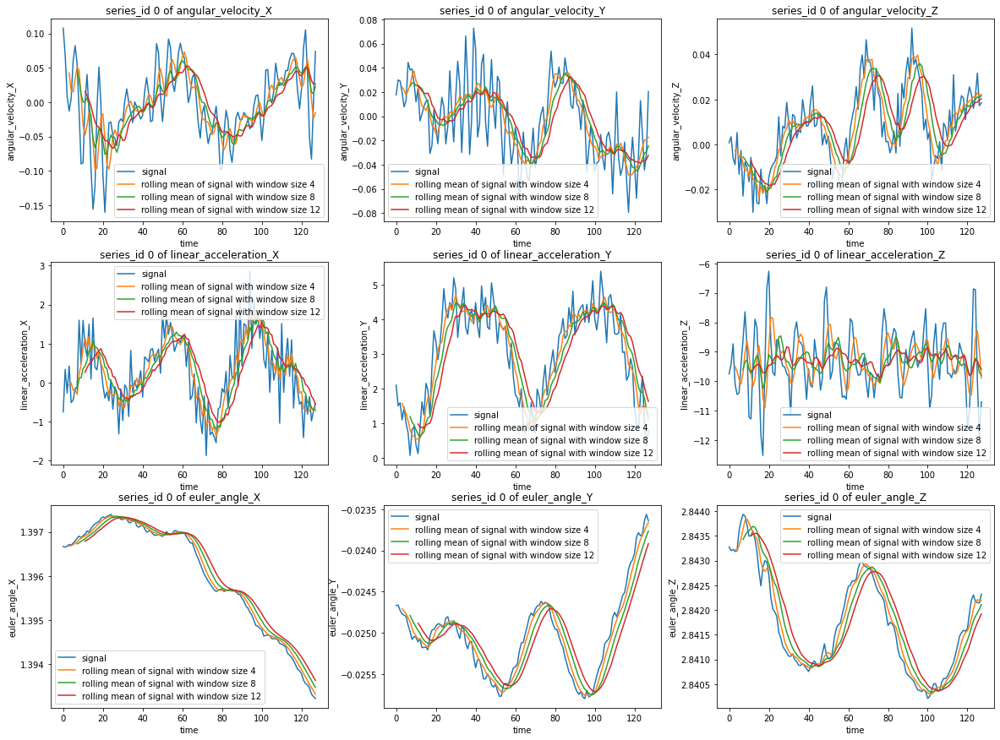

In [ ]:
fig, ax = plt.subplots(nrows = 3, ncols= 3, figsize =(20, 15))
ax = ax.ravel()

feature_rolling = ['angular_velocity_X','angular_velocity_Y', 'angular_velocity_Z','linear_acceleration_X','linear_acceleration_Y','linear_acceleration_Z','euler_angle_X', 'euler_angle_Y','euler_angle_Z' ]

for j in range(0, len(feature_rolling)):
    plt.subplot(3,3,j+1)
    plot_rolling_feature(0, feature_rolling[j], ax[j])
    
plt.show()

I chose a window size of 8 since it seems to be smooth and capture most of the information except very fine bumps of the original signal

In [ ]:
feature_list_rolling = pd.DataFrame()
feature_list_rolling['series_id'] = range(0, 3810)
feature_list_rolling.set_index('series_id')

for f in feature_rolling:
    feature_list_rolling[f+'_rolling_mean'] = data_.groupby(['series_id'])[f].rolling(8).mean().fillna(0).groupby(['series_id']).mean()
    feature_list_rolling[f+'_rolling_min'] = data_.groupby(['series_id'])[f].rolling(8).min().fillna(0).groupby(['series_id']).mean()
    feature_list_rolling[f+'_rolling_max'] = data_.groupby(['series_id'])[f].rolling(8).max().fillna(0).groupby(['series_id']).mean()
    feature_list_rolling[f+'_rolling_std'] = data_.groupby(['series_id'])[f].rolling(8).std().fillna(0).groupby(['series_id']).mean()
    feature_list_rolling[f+'_rolling_max_to_min'] = feature_list_rolling[f+'_rolling_max'] /feature_list_rolling[f+'_rolling_min']
    feature_list_rolling[f+'_rolling_abs_change_mean'] = abs_change(feature_list_rolling[f+'_rolling_mean'])
    feature_list_rolling[f+'_rolling_abs_change_in_change_mean'] = abs_change(feature_list_rolling[f+'_rolling_abs_change_mean'])
    feature_list_rolling[f+'_rolling_abs_min'] = np.abs(data_.groupby(['series_id'])[f].rolling(8).min().fillna(0).groupby(['series_id']).mean())
    feature_list_rolling[f+'_rolling_abs_max'] = np.abs(data_.groupby(['series_id'])[f].rolling(8).max().fillna(0).groupby(['series_id']).mean())
    feature_list_rolling[f+'_rolling_kurtosis'] = data.groupby(['series_id'])[f].rolling(8).apply(pd.DataFrame.kurt).fillna(0).groupby(['series_id']).mean()

In [ ]:
feature_list_rolling.head(5)

,series_id,angular_velocity_X_rolling_mean,angular_velocity_X_rolling_min,angular_velocity_X_rolling_max,angular_velocity_X_rolling_std,angular_velocity_X_rolling_max_to_min,angular_velocity_X_rolling_abs_change_mean,angular_velocity_X_rolling_abs_change_in_change_mean,angular_velocity_X_rolling_abs_min,angular_velocity_X_rolling_abs_max,...,euler_angle_Z_rolling_mean,euler_angle_Z_rolling_min,euler_angle_Z_rolling_max,euler_angle_Z_rolling_std,euler_angle_Z_rolling_max_to_min,euler_angle_Z_rolling_abs_change_mean,euler_angle_Z_rolling_abs_change_in_change_mean,euler_angle_Z_rolling_abs_min,euler_angle_Z_rolling_abs_max,euler_angle_Z_rolling_kurtosis
0,0,-0.004103,-0.052418,0.040601,0.032735,-0.774567,0.004917,0.002579,0.052418,0.040601,...,2.686272,2.685970,2.686576,0.000218,1.000226,0.001517,0.003623,2.685970,2.686576,-0.543312
1,1,0.000814,-0.093609,0.096625,0.069349,-1.032215,0.002338,0.003446,0.093609,0.096625,...,2.684755,2.684274,2.685228,0.000345,1.000355,0.005140,0.005093,2.684274,2.685228,-0.287152
2,2,0.003152,-0.044106,0.050555,0.033226,-1.146229,0.005784,0.001009,0.044106,0.050555,...,2.689894,2.689559,2.690235,0.000241,1.000251,0.000047,0.002887,2.689559,2.690235,-0.457723
3,3,-0.002632,-0.156902,0.158768,0.115459,-1.011891,0.006793,0.002609,0.156902,0.158768,...,2.689942,2.688979,2.690925,0.000705,1.000724,0.002934,0.000029,2.688979,2.690925,-0.573083
4,4,0.004161,-0.035082,0.040801,0.027546,-1.163006,0.009402,0.005074,0.035082,0.040801,...,2.687007,2.686734,2.687281,0.000196,1.000203,0.002906,0.000954,2.686734,2.687281,-0.363504


In [ ]:
feature_list_rolling.shape

(3810, 91)

In [ ]:
feature_list_rolling.to_csv('data_2.csv', index= False)

In [ ]:
%%time
for column in feature_list_rolling.columns:
    if column != 'series_id':
        feature_list_rolling[column] = normalize_features(feature_list_rolling[column])

Wall time: 4min 49s


In [ ]:
feature_list_rolling.to_csv('normalized_data_2.csv', index= False)

### Expanding window features 

In [239]:
%%time
#Expanding window features
feature_list_expanding = pd.DataFrame()
feature_list_expanding['series_id'] = range(0, 3810)
feature_list_expanding.set_index('series_id')
feature_rolling = ['angular_velocity_X','angular_velocity_Y', 'angular_velocity_Z','linear_acceleration_X','linear_acceleration_Y','linear_acceleration_Z','euler_angle_X', 'euler_angle_Y','euler_angle_Z' ]

for f in feature_rolling:
    feature_list_expanding[f+'_expanding_mean'] = data_.groupby(['series_id'])[f].expanding(5).mean().fillna(0).groupby(['series_id']).mean()
    feature_list_expanding[f+'_expanding_min'] = data_.groupby(['series_id'])[f].expanding(5).min().fillna(0).groupby(['series_id']).mean()
    feature_list_expanding[f+'_expanding_max'] = data_.groupby(['series_id'])[f].expanding(5).max().fillna(0).groupby(['series_id']).mean()
    feature_list_expanding[f+'_expanding_std'] = data_.groupby(['series_id'])[f].expanding(5).std().fillna(0).groupby(['series_id']).mean()
    feature_list_expanding[f+'_expanding_max_to_min'] = feature_list_expanding[f+'_expanding_max'] /feature_list_expanding[f+'_expanding_min']
    feature_list_expanding[f+'_expanding_abs_change_mean'] = abs_change(feature_list_expanding[f+'_expanding_mean'])
    feature_list_expanding[f+'_expanding_abs_change_in_change_mean'] = abs_change(feature_list_expanding[f+'_expanding_abs_change_mean'])
    feature_list_expanding[f+'_expanding_abs_min'] = np.abs(data_.groupby(['series_id'])[f].expanding(5).min().fillna(0).groupby(['series_id']).mean())
    feature_list_expanding[f+'_expanding_abs_max'] = np.abs(data_.groupby(['series_id'])[f].expanding(5).max().fillna(0).groupby(['series_id']).mean())
    feature_list_expanding[f+'_expanding_kurtosis'] = data_.groupby(['series_id'])[f].expanding(5).apply(pd.DataFrame.kurt).fillna(0).groupby(['series_id']).mean()

Wall time: 8min 50s


In [241]:
feature_list_expanding.head()

,series_id,angular_velocity_X_expanding_mean,angular_velocity_X_expanding_min,angular_velocity_X_expanding_max,angular_velocity_X_expanding_std,angular_velocity_X_expanding_max_to_min,angular_velocity_X_expanding_abs_change_mean,angular_velocity_X_expanding_abs_change_in_change_mean,angular_velocity_X_expanding_abs_min,angular_velocity_X_expanding_abs_max,...,euler_angle_Z_expanding_mean,euler_angle_Z_expanding_min,euler_angle_Z_expanding_max,euler_angle_Z_expanding_std,euler_angle_Z_expanding_max_to_min,euler_angle_Z_expanding_abs_change_mean,euler_angle_Z_expanding_abs_change_in_change_mean,euler_angle_Z_expanding_abs_min,euler_angle_Z_expanding_abs_max,euler_angle_Z_expanding_kurtosis
0,0,-0.006782,-0.146198,0.104286,0.056398,-0.713320,0.010105,0.000475,0.146198,0.104286,...,2.753463,2.752210,2.755051,0.000873,1.001032,0.001892,0.002709,2.752210,2.755051,-1.082296
1,1,0.003323,-0.224141,0.274563,0.106896,-1.224959,0.009630,0.008322,0.224141,0.274563,...,2.751571,2.749487,2.753458,0.001030,1.001444,0.004600,0.002669,2.749487,2.753458,-0.844748
2,2,-0.006307,-0.147938,0.121934,0.062593,-0.824222,0.017952,0.019758,0.147938,0.121934,...,2.756171,2.754816,2.757947,0.000898,1.001136,0.001931,0.002533,2.754816,2.757947,0.075873
3,3,-0.024259,-0.379189,0.502907,0.211258,-1.326269,0.037710,0.023298,0.379189,0.502907,...,2.758103,2.754040,2.763017,0.002536,1.003260,0.004465,0.001949,2.754040,2.763017,-0.947098
4,4,0.013451,-0.082449,0.078126,0.041869,-0.947568,0.014412,0.005480,0.082449,0.078126,...,2.753638,2.752448,2.754782,0.000760,1.000848,0.002516,0.001545,2.752448,2.754782,-1.219140


In [240]:
feature_list_expanding.to_csv('data_4.csv',index = False)

In [244]:
%%time
for column in feature_list_expanding.columns:
    if column != 'series_id':
        feature_list_expanding[column] = normalize_features(feature_list_expanding[column])

Wall time: 4min 54s


In [245]:
feature_list_expanding.to_csv('normalized_data_4.csv', index= False)

### Find the most important features 

We use an Extra Trees Classifier to find the most important features

In [1]:
#https://www.geeksforgeeks.org/ml-extra-tree-classifier-for-feature-selection/
from sklearn.ensemble import ExtraTreesClassifier
import pandas as pd

In [2]:
df1 = pd.read_csv('normalized_data_1.csv')
df2 = pd.read_csv('normalized_data_2.csv')
df3 = pd.read_csv('normalized_data_3.csv')
df4 = pd.read_csv('normalized_data_4.csv')
df5 = pd.read_csv('normalized_data_3_amp.csv')
df = pd.concat([df1,df2,df3,df4,df5], axis = 1)

In [3]:
df.head()

,series_id,angular_velocity_X_mean,angular_velocity_X_min,angular_velocity_X_max,angular_velocity_X_std,angular_velocity_X_max_to_min,angular_velocity_X_abs_change_mean,angular_velocity_X_abs_change_in_change_mean,angular_velocity_X_abs_min,angular_velocity_X_abs_max,...,linear_acceleration_Z_acf_amp_0,linear_acceleration_Z_acf_amp_1,linear_acceleration_Z_acf_amp_2,linear_acceleration_Z_acf_amp_3,linear_acceleration_Z_acf_amp_4,linear_acceleration_Z_acf_amp_5,linear_acceleration_Z_acf_amp_6,linear_acceleration_Z_acf_amp_7,linear_acceleration_Z_acf_amp_8,linear_acceleration_Z_acf_amp_9
0,0,0.380684,0.934516,0.046147,0.061814,0.871204,0.035558,0.026784,0.065484,0.046147,...,0.290771,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0
1,1,0.403113,0.894613,0.123247,0.110416,0.774465,0.009828,0.000317,0.105387,0.123247,...,0.454305,0.383164,0.553859,0.501491,0.397763,0.338842,0.000000,0.000000,0.0,0.0
2,2,0.396911,0.937771,0.061179,0.070877,0.814583,0.010142,0.022586,0.062229,0.061179,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0
3,3,0.390512,0.832588,0.226640,0.217728,0.734871,0.031841,0.041752,0.167412,0.226640,...,0.564610,0.318239,0.488979,0.474790,0.505819,0.000000,0.395481,0.000000,0.0,0.0
4,4,0.410596,0.958334,0.034415,0.051939,0.847896,0.071945,0.018020,0.041666,0.034415,...,0.494617,0.000000,0.560520,0.372565,0.000000,0.000000,0.000000,0.291938,0.0,0.0


In [4]:
df.shape

(3810, 687)

In [5]:
df.columns

Index(['series_id', 'angular_velocity_X_mean', 'angular_velocity_X_min',
       'angular_velocity_X_max', 'angular_velocity_X_std',
       'angular_velocity_X_max_to_min', 'angular_velocity_X_abs_change_mean',
       'angular_velocity_X_abs_change_in_change_mean',
       'angular_velocity_X_abs_min', 'angular_velocity_X_abs_max',
       ...
       'linear_acceleration_Z_acf_amp_0', 'linear_acceleration_Z_acf_amp_1',
       'linear_acceleration_Z_acf_amp_2', 'linear_acceleration_Z_acf_amp_3',
       'linear_acceleration_Z_acf_amp_4', 'linear_acceleration_Z_acf_amp_5',
       'linear_acceleration_Z_acf_amp_6', 'linear_acceleration_Z_acf_amp_7',
       'linear_acceleration_Z_acf_amp_8', 'linear_acceleration_Z_acf_amp_9'],
      dtype='object', length=687)

In [6]:
X = df.drop(columns = 'series_id')

In [8]:
#https://stackoverflow.com/questions/61202580/correct-way-of-one-hot-encoding-class-labels-for-multi-class-problem
from sklearn.preprocessing import LabelEncoder
result = pd.read_csv('y_train_.csv')
y = result['surface']
le = LabelEncoder()
y = le.fit_transform(y)
print(y)

[2 1 1 ... 2 7 5]


In [24]:
# Building the model
extra_tree_forest = ExtraTreesClassifier(n_estimators = 100)
  
# Training the model
extra_tree_forest.fit(X,y)
  
# Computing the importance of each feature
feature_importance = extra_tree_forest.feature_importances_
  
# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in 
                                        extra_tree_forest.estimators_],
                                        axis = 0)

In [25]:
ind = np.argsort(feature_importance_normalized)[::-1]   #indices sorted in descending order
X_val = [X.columns[ind[i]] for i in range(0,50)]
y_val = [feature_importance_normalized[ind[i]] for i in range(0,50)]

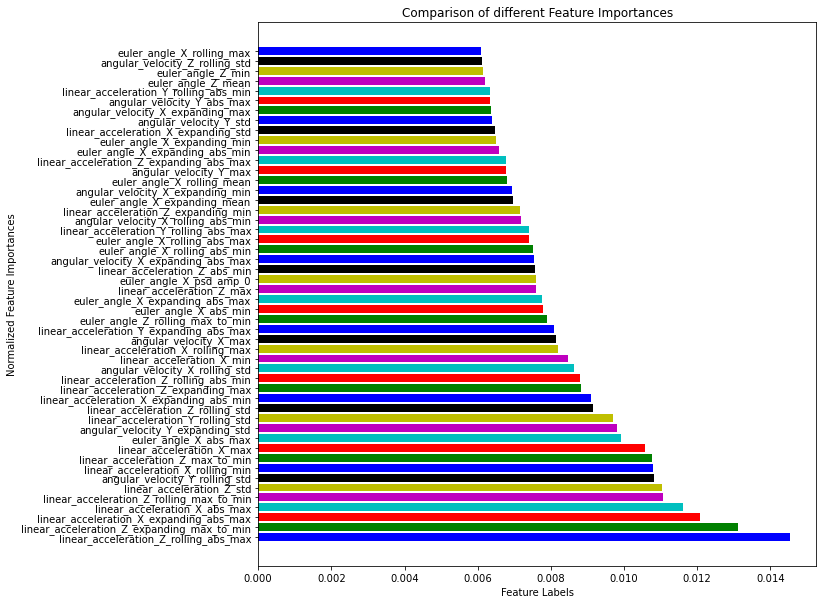

In [30]:
plt.figure(figsize = (10,10))
plt.barh(X_val, y_val, color = ['b', 'g', 'r', 'c', 'm', 'y', 'k'])
plt.xlabel('Feature Labels')
plt.ylabel('Normalized Feature Importances')
plt.title('Comparison of different Feature Importances')
plt.show()

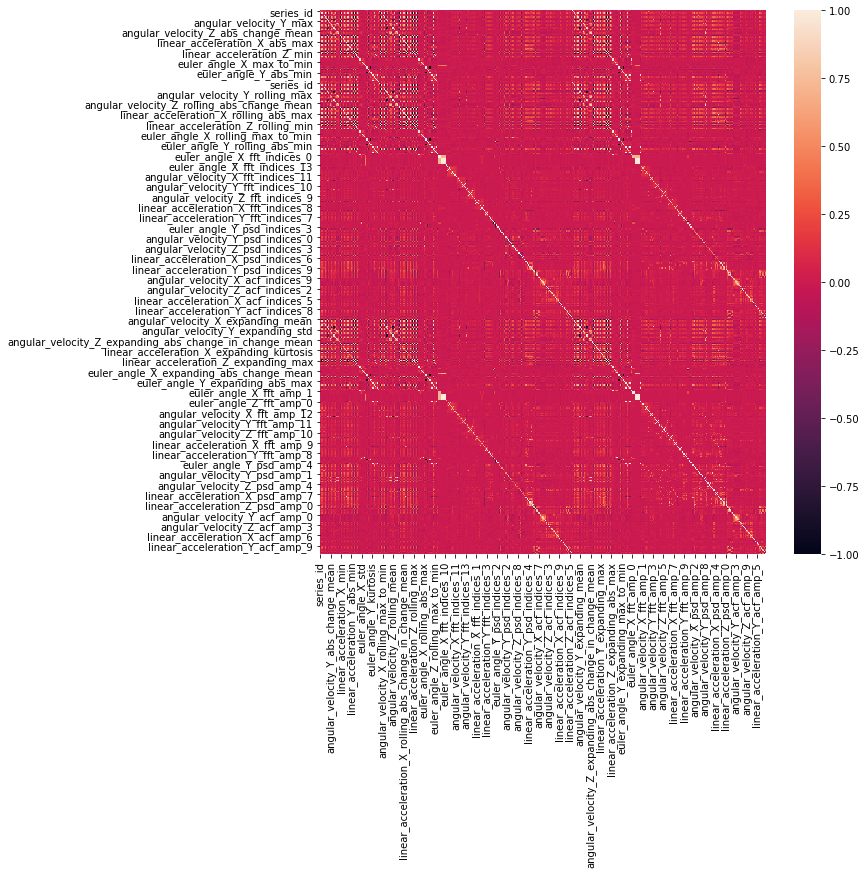

In [18]:
#Correlation between rolling and expanding features
import seaborn as sns

fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(df.corr())

In [102]:
corr_coef = pd.DataFrame(correlation_coeff_, columns = df1.columns)

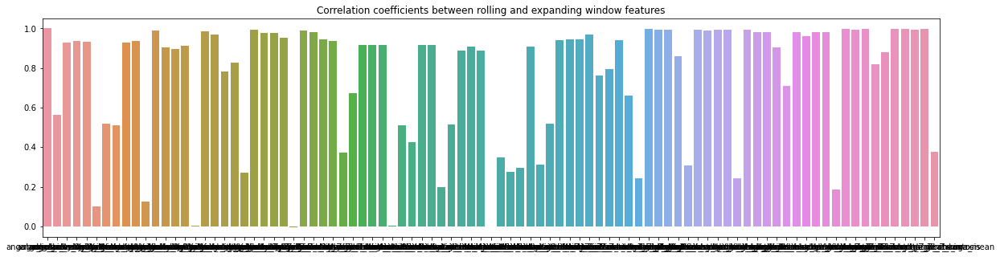

In [107]:
plt.figure(figsize = (20,5)) #Length, height
sns.barplot(data=corr_coef)
plt.title('Correlation coefficients between rolling and expanding window features')
#plt.xlabel('Class')
#plt.ylabel('Mean Age')
plt.show()

### Feature Analysis

Density plots with respect to features to see how well the feature classifies the output:

In [ ]:
df = pd.read_csv('final.csv')

In [ ]:
def density_plots(data,result, feature, ax):
    #Plot density plots for all the output classes for each feature
    data[data['series_id'].isin(result[result['surface'] == 'concrete']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'soft_pvc']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'wood']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'tiled']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'fine_concrete']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'hard_tiles_large_space']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'soft_tiles']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'carpet']['series_id'])][feature].plot.density(ax = ax)
    data[data['series_id'].isin(result[result['surface'] == 'hard_tiles']['series_id'])][feature].plot.density(ax = ax)
    ax.legend(['concrete','soft_pvc','wood','tiled','fine_concrete','hard_tiles_large_space','soft_tiles','carpet','hard_tiles'])
    ax.set(xlabel=feature, ylabel='density')
    

In [ ]:
feature = [df.columns[i] for i in range(len(df.columns)) if df.columns[i] != 'series_id']

In [ ]:
# Frequency features
feature_set = [feature[i] for i in range(len(feature)) if 'fft' in feature[i] or 'psd' in feature[i] or 'acf' in feature[i]]

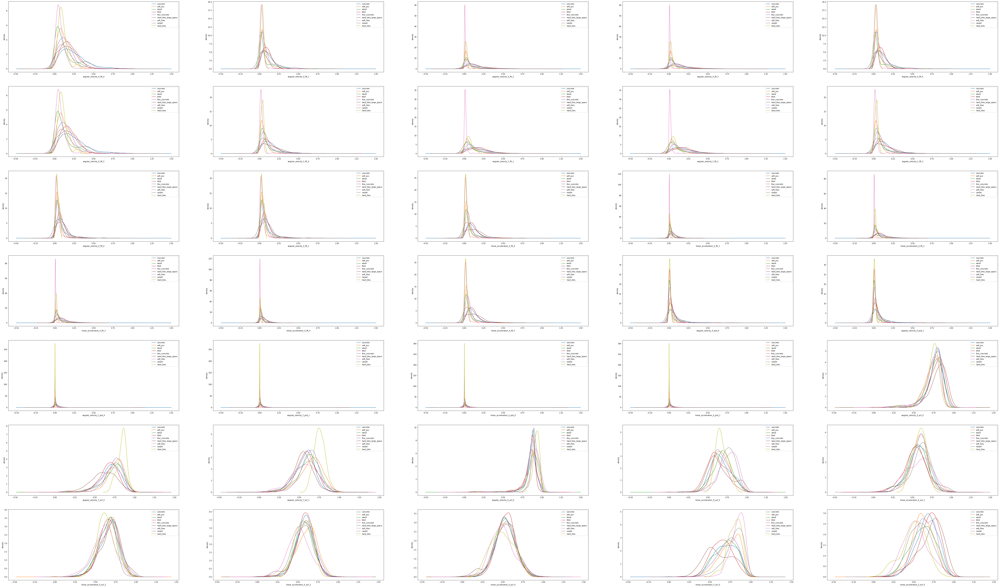

Wall time: 11.7 s


In [ ]:
%%time

fig, ax = plt.subplots(nrows = 7, ncols= 5, figsize =(100, 60))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    density_plots(df, result, feature_set[j], ax[j])
    
plt.show()

In [ ]:
# Rolling features
feature_set = [feature[i] for i in range(len(feature)) if 'rolling' in feature[i]]

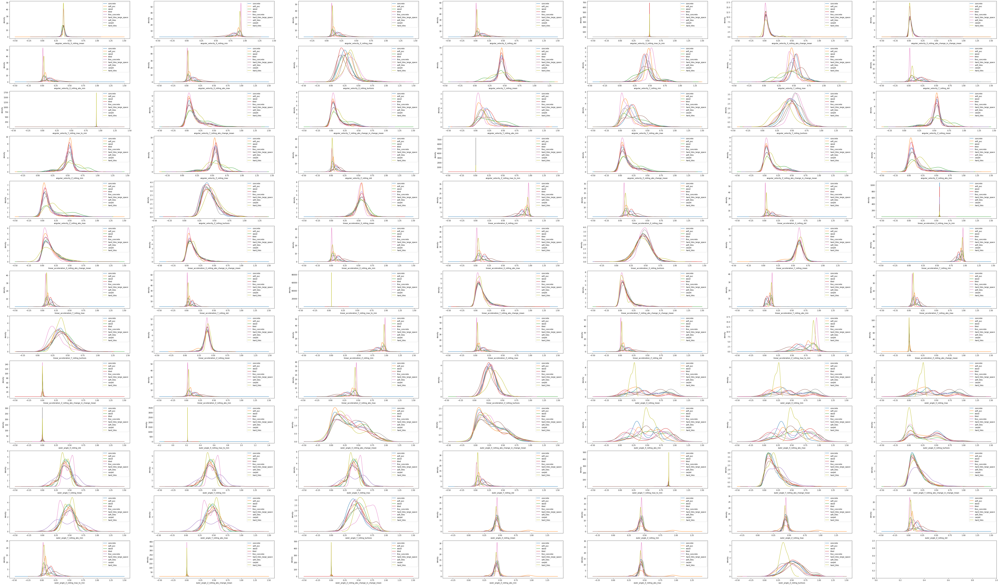

Wall time: 35.6 s


In [ ]:
%%time

fig, ax = plt.subplots(nrows = 13, ncols= 7, figsize =(100, 60))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    density_plots(df, result, feature_set[j], ax[j])
    
plt.show()

In [ ]:
# Statistical features
feature_set = [feature[i] for i in range(len(feature)) if 'rolling' not in feature[i] and 'fft' not in feature[i] and 'psd' not in feature[i] and 'acf' not in feature[i]]

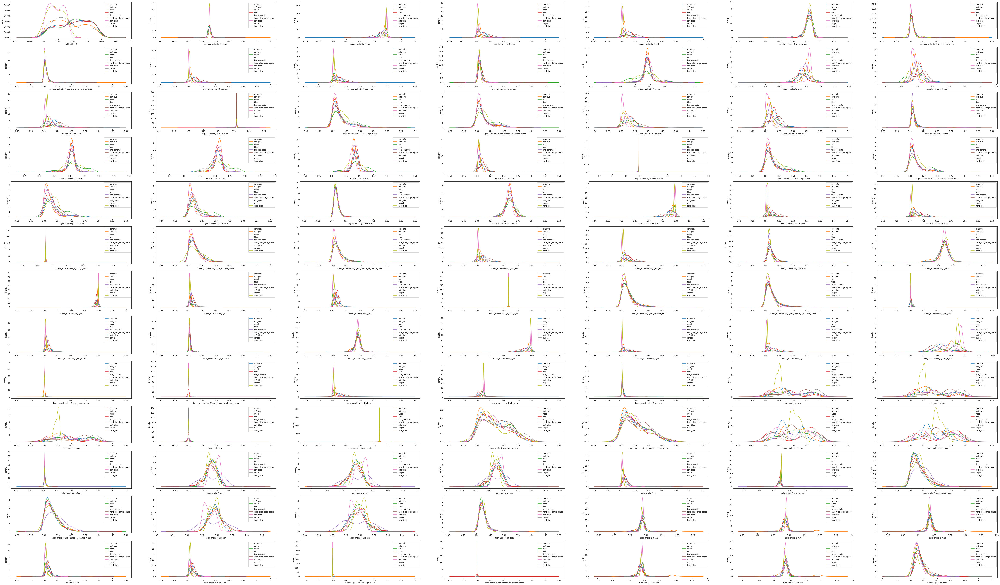

Wall time: 34.1 s


In [ ]:
%%time

fig, ax = plt.subplots(nrows = 13, ncols= 7, figsize =(100, 60))
ax = ax.ravel()

for j in range(0, len(feature_set)):
    density_plots(df, result, feature_set[j], ax[j])
    
plt.show()

## Training

### First cut model



For every model:

1. RandomSearchCV to find suitable parameters
2. Crossvalidation using Stratiifed k fold cv
3. Calculation of averaged metrics precision, recall and f1 score
4. ROC AUC curves for each class

In [2]:
from scipy.stats import uniform
from sklearn.multiclass import OneVsRestClassifier
from sklearn.model_selection import train_test_split, StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import roc_curve, auc,classification_report, confusion_matrix, accuracy_score, f1_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB, GaussianNB, BernoulliNB
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn import metrics
from xgboost import XGBClassifier
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

#### Load the data

In [3]:
df1 = pd.read_csv('normalized_data_1.csv')
df2 = pd.read_csv('normalized_data_2.csv')
df3 = pd.read_csv('normalized_data_3.csv')
df4 = pd.read_csv('normalized_data_4.csv')
df5 = pd.read_csv('normalized_data_3_amp.csv')
df = pd.concat([df1,df2,df3,df4,df5], axis = 1)  #For distance measure based algorithms

In [4]:
from sklearn.preprocessing import LabelEncoder
result = pd.read_csv("y_train_.csv")
y = result['surface']
le = LabelEncoder()
y = le.fit_transform(y)

X = df.drop(columns = 'series_id')


In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify = y)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(2552, 684) (1258, 684) (2552,) (1258,)


#### Logistic Regression 

In [10]:
distributions = dict(C=uniform(loc=0, scale=50),
                    penalty=['l2', 'l1','elasticnet', 'none'])
model = LogisticRegression()
clf = OneVsRestClassifier(model)
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring ='f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

{'C': 2.835648865872159, 'penalty': 'l2'}

In [40]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = LogisticRegression( C = 2.84, penalty= 'l2') 
    clf = OneVsRestClassifier(model)
    clf.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',clf.score(X_test_fold, y_test_fold))
    scores += clf.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

#Reference: https://stackoverflow.com/questions/38640109/logistic-regression-python-solvers-defintions
#Newton's Method uses the second derivative along wtih the first to find the minimum point of the cost function

For fold 0 score is : 0.5625
For fold 1 score is : 0.60546875
For fold 2 score is : 0.6274509803921569
For fold 3 score is : 0.6039215686274509
For fold 4 score is : 0.5843137254901961
For fold 5 score is : 0.592156862745098
For fold 6 score is : 0.5803921568627451
For fold 7 score is : 0.6549019607843137
For fold 8 score is : 0.5843137254901961
For fold 9 score is : 0.5882352941176471
Average score is : 0.5983655024509804


In [82]:
model = LogisticRegression( C = 2.84, penalty= 'l2') 
clf = OneVsRestClassifier(model)
clf.fit(X_train, y_train)
report = classification_report(y_test, clf.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [83]:
print(report)

              precision    recall  f1-score   support

           0       0.45      0.31      0.37        62
           1       0.62      0.74      0.68       257
           2       0.50      0.34      0.41       120
           3       0.00      0.00      0.00         7
           4       0.59      0.54      0.56       102
           5       0.64      0.76      0.70       242
           6       0.81      0.81      0.81        98
           7       0.63      0.58      0.60       170
           8       0.58      0.56      0.57       200

    accuracy                           0.62      1258
   macro avg       0.54      0.51      0.52      1258
weighted avg       0.61      0.62      0.61      1258



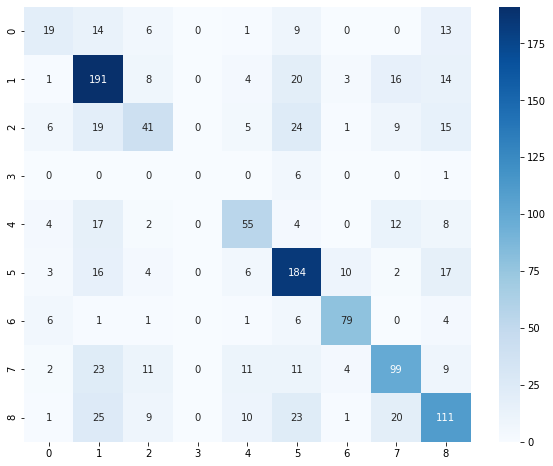

In [84]:
#Confusion matrix
cm = confusion_matrix(y_test, clf.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

In [16]:
def plot_auc_roc_curve(y_test_, y_score):
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test_[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Plot of a ROC curve for a specific class
    plt.figure(figsize = (8,6))
    for i in range(n_classes):

        plt.plot(fpr[i], tpr[i], label='ROC curve for class {} (area = {})'.format(classes[i],roc_auc[i]))
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver operating characteristic curve')
        plt.legend()
    plt.show()
    print(roc_auc)
    print(sum(list(roc_auc.values()))/len(roc_auc))
    
    return 

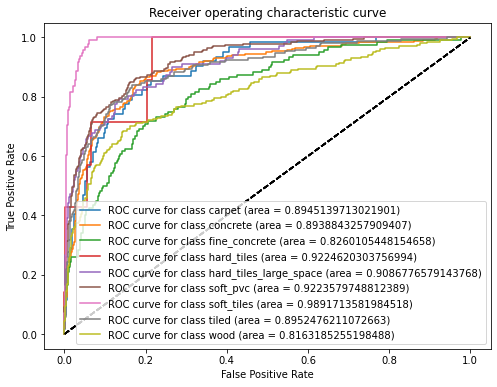

{0: 0.8945139713021901, 1: 0.8938843257909407, 2: 0.8260105448154658, 3: 0.9224620303756994, 4: 0.9086776579143768, 5: 0.9223579748812389, 6: 0.9891713581984518, 7: 0.8952476211072663, 8: 0.8163185255198488}
0.8965160011006089


In [16]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = LogisticRegression(C = 2.84, penalty= 'l2')
# classifier
clf = OneVsRestClassifier(model)

y_score = clf.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### SVM 

In [18]:
distributions = dict( C=uniform(loc=0, scale=50))
model = SVC(kernel = 'linear')
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring ='f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

{'C': 35.759468318620975}

In [19]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = OneVsRestClassifier(SVC( C = 35.76, kernel = 'linear'))
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.57421875
For fold 1 score is : 0.58984375
For fold 2 score is : 0.6431372549019608
For fold 3 score is : 0.5764705882352941
For fold 4 score is : 0.5725490196078431
For fold 5 score is : 0.5764705882352941
For fold 6 score is : 0.5490196078431373
For fold 7 score is : 0.6235294117647059
For fold 8 score is : 0.6039215686274509
For fold 9 score is : 0.5686274509803921
Average score is : 0.5877787990196077


In [68]:
model = OneVsRestClassifier(SVC( C = 35.76, kernel = 'linear'))
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [69]:
print(report)

              precision    recall  f1-score   support

           0       0.42      0.37      0.39        62
           1       0.66      0.65      0.66       257
           2       0.46      0.41      0.43       120
           3       0.17      0.14      0.15         7
           4       0.49      0.60      0.54       102
           5       0.64      0.69      0.67       242
           6       0.77      0.80      0.78        98
           7       0.61      0.61      0.61       170
           8       0.56      0.52      0.54       200

    accuracy                           0.60      1258
   macro avg       0.53      0.53      0.53      1258
weighted avg       0.60      0.60      0.60      1258



In [70]:
#Confusion matrix
cm = confusion_matrix(y_test, clf.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

    0    1   2  3   4    5   6   7    8
0  19   14   6  0   1    9   0   0   13
1   1  191   8  0   4   20   3  16   14
2   6   19  41  0   5   24   1   9   15
3   0    0   0  0   0    6   0   0    1
4   4   17   2  0  55    4   0  12    8
5   3   16   4  0   6  184  10   2   17
6   6    1   1  0   1    6  79   0    4
7   2   23  11  0  11   11   4  99    9
8   1   25   9  0  10   23   1  20  111


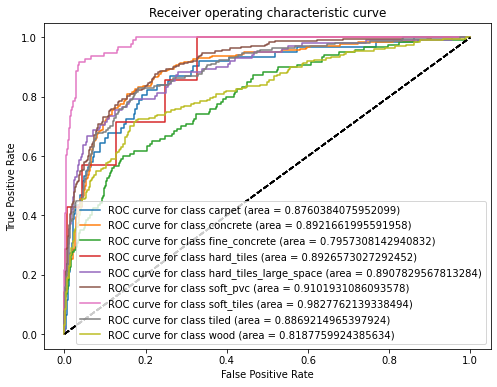

{0: 0.8760384075952099, 1: 0.8921661995591958, 2: 0.7957308142940832, 3: 0.8926573027292452, 4: 0.8907829567813284, 5: 0.9101931086093578, 6: 0.9827762139338494, 7: 0.8869214965397924, 8: 0.8187759924385634}
0.8828936102756251


In [22]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = SVC( C = 35.76, kernel = 'linear', probability = True)
# classifier
clf = OneVsRestClassifier(model)

y_score = clf.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### SVM with polynomial kernal 

In [24]:
distributions = dict( C=uniform(loc=0, scale=50), 
                    degree = range(0,20),
                    gamma = uniform(loc=0, scale = 100))
model = SVC(kernel = 'poly')
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring ='f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

{'C': 19.219085364634992, 'degree': 6, 'gamma': 5.671297731744318}

In [25]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = SVC( C = 19.21, degree = 6, kernel = 'poly', gamma = 5.67)
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.671875
For fold 1 score is : 0.71875
For fold 2 score is : 0.6666666666666666
For fold 3 score is : 0.7058823529411765
For fold 4 score is : 0.6705882352941176
For fold 5 score is : 0.7058823529411765
For fold 6 score is : 0.6470588235294118
For fold 7 score is : 0.7137254901960784
For fold 8 score is : 0.6901960784313725
For fold 9 score is : 0.6823529411764706
Average score is : 0.6872977941176471


In [71]:
model =  SVC( C = 19.21, degree = 6, kernel = 'poly', gamma = 5.67)
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [72]:
print(report)

              precision    recall  f1-score   support

           0       0.52      0.52      0.52        62
           1       0.68      0.82      0.74       257
           2       0.60      0.48      0.53       120
           3       0.50      0.14      0.22         7
           4       0.78      0.66      0.71       102
           5       0.72      0.77      0.75       242
           6       0.84      0.91      0.87        98
           7       0.70      0.63      0.66       170
           8       0.66      0.62      0.64       200

    accuracy                           0.70      1258
   macro avg       0.67      0.62      0.63      1258
weighted avg       0.69      0.70      0.69      1258



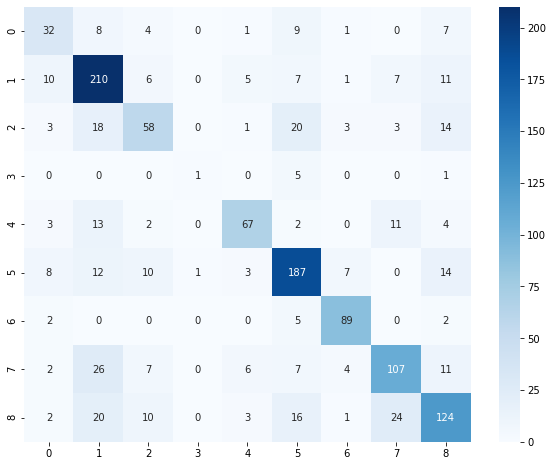

In [80]:
#Confusion matrix
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

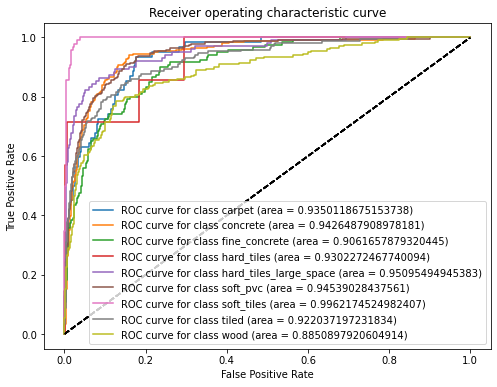

{0: 0.9350118675153738, 1: 0.9426487908978181, 2: 0.9061657879320445, 3: 0.9302272467740094, 4: 0.95095494945383, 5: 0.94539028437561, 6: 0.9962174524982407, 7: 0.922037197231834, 8: 0.8850897920604914}
0.9348603743043612


In [28]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = SVC( C = 19.21, degree = 6, kernel = 'poly', gamma = 5.67, probability = True)
# classifier
#clf = OneVsRestClassifier(model)

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### SVM with rbf kernel 

In [85]:
distributions = dict( C=uniform(loc=0, scale=50), 
                    gamma = uniform(loc=0, scale = 100))
model = SVC(kernel = 'rbf')
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring ='f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

{'C': 27.440675196366236, 'gamma': 71.51893663724195}

In [86]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    #model = SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
    model = SVC( C = 27.44, gamma = 71.51, kernel = 'rbf')
    #model = OneVsRestClassifier(SVC( C = 19.17, kernel = 'linear'))
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.203125
For fold 1 score is : 0.203125
For fold 2 score is : 0.20392156862745098
For fold 3 score is : 0.20392156862745098
For fold 4 score is : 0.20392156862745098
For fold 5 score is : 0.20392156862745098
For fold 6 score is : 0.20784313725490197
For fold 7 score is : 0.20784313725490197
For fold 8 score is : 0.20392156862745098
For fold 9 score is : 0.20392156862745098
Average score is : 0.20454656862745094


In [87]:
model = SVC( C = 27.44, gamma = 71.51, kernel = 'rbf')
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [88]:
print(report)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        62
           1       0.20      1.00      0.34       257
           2       0.00      0.00      0.00       120
           3       0.00      0.00      0.00         7
           4       0.00      0.00      0.00       102
           5       0.00      0.00      0.00       242
           6       0.00      0.00      0.00        98
           7       0.00      0.00      0.00       170
           8       0.00      0.00      0.00       200

    accuracy                           0.20      1258
   macro avg       0.02      0.11      0.04      1258
weighted avg       0.04      0.20      0.07      1258



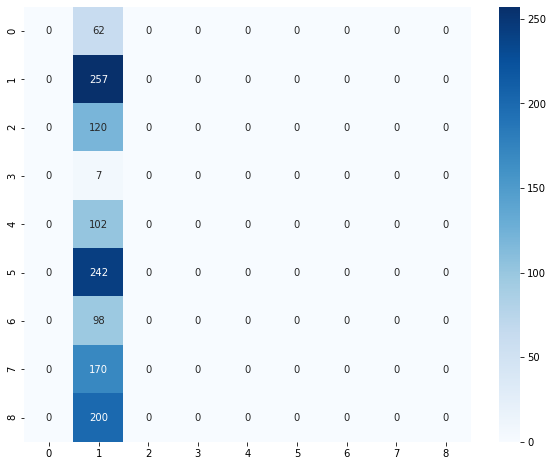

In [89]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

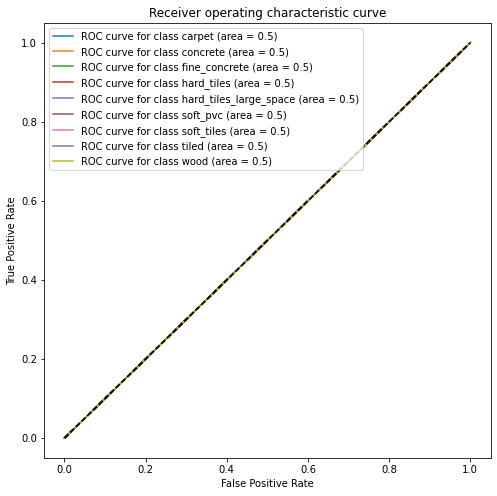

{0: 0.5, 1: 0.5, 2: 0.5, 3: 0.5, 4: 0.5, 5: 0.5, 6: 0.5, 7: 0.5, 8: 0.5}
0.5


In [90]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = SVC( C = 27.44, gamma = 71.51, kernel = 'rbf', probability = True)
# classifier
#clf = OneVsRestClassifier(model)

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### KNN 

In [91]:
distributions = dict( n_neighbors= range(0,1000))
model = KNeighborsClassifier()
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring ='f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

{'n_neighbors': 9}

In [92]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = KNeighborsClassifier(n_neighbors= 9)
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.57421875
For fold 1 score is : 0.65625
For fold 2 score is : 0.5411764705882353
For fold 3 score is : 0.592156862745098
For fold 4 score is : 0.5450980392156862
For fold 5 score is : 0.6039215686274509
For fold 6 score is : 0.5647058823529412
For fold 7 score is : 0.5882352941176471
For fold 8 score is : 0.5764705882352941
For fold 9 score is : 0.5725490196078431
Average score is : 0.5814782475490194


In [93]:
model = KNeighborsClassifier(n_neighbors= 9)
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [94]:
print(report)

              precision    recall  f1-score   support

           0       0.44      0.44      0.44        62
           1       0.51      0.75      0.61       257
           2       0.44      0.28      0.34       120
           3       0.50      0.29      0.36         7
           4       0.76      0.40      0.53       102
           5       0.70      0.67      0.68       242
           6       0.59      0.99      0.74        98
           7       0.60      0.46      0.52       170
           8       0.64      0.51      0.56       200

    accuracy                           0.58      1258
   macro avg       0.57      0.53      0.53      1258
weighted avg       0.60      0.58      0.57      1258



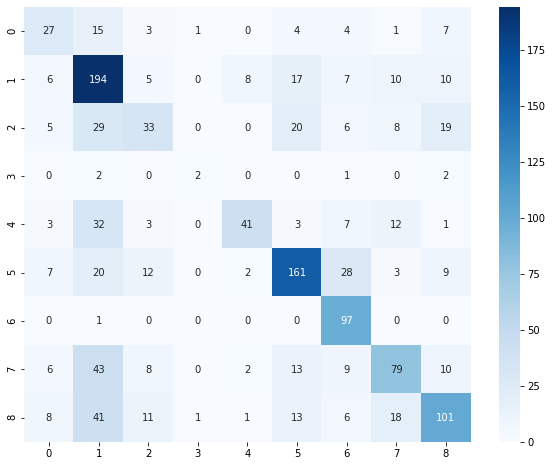

In [95]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

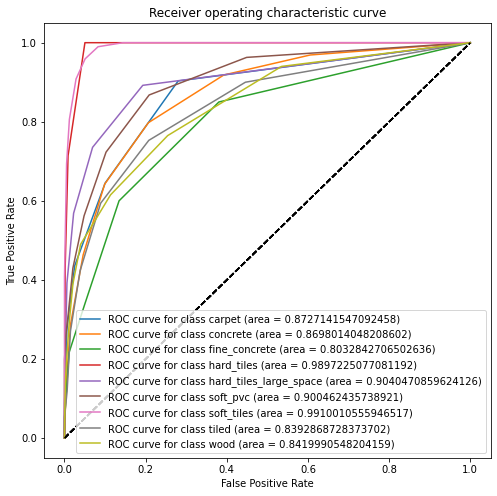

{0: 0.8727141547092458, 1: 0.8698014048208602, 2: 0.8032842706502636, 3: 0.9897225077081192, 4: 0.9040470859624126, 5: 0.900462435738921, 6: 0.9910010555946517, 7: 0.8392868728373702, 8: 0.8419990548204159}
0.8902576492046956


In [96]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = KNeighborsClassifier(n_neighbors= 9)
y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### Naive Bayes 

In [97]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = GaussianNB()
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.35546875
For fold 1 score is : 0.3359375
For fold 2 score is : 0.30196078431372547
For fold 3 score is : 0.3058823529411765
For fold 4 score is : 0.32941176470588235
For fold 5 score is : 0.33725490196078434
For fold 6 score is : 0.28627450980392155
For fold 7 score is : 0.33725490196078434
For fold 8 score is : 0.36470588235294116
For fold 9 score is : 0.30196078431372547
Average score is : 0.3256112132352941


In [98]:
model = GaussianNB()
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [99]:
print(report)

              precision    recall  f1-score   support

           0       0.22      0.21      0.22        62
           1       0.54      0.03      0.05       257
           2       0.21      0.57      0.31       120
           3       0.05      0.14      0.07         7
           4       0.35      0.23      0.27       102
           5       0.69      0.29      0.40       242
           6       0.34      0.87      0.49        98
           7       0.29      0.61      0.40       170
           8       0.49      0.18      0.27       200

    accuracy                           0.32      1258
   macro avg       0.35      0.35      0.27      1258
weighted avg       0.45      0.32      0.28      1258



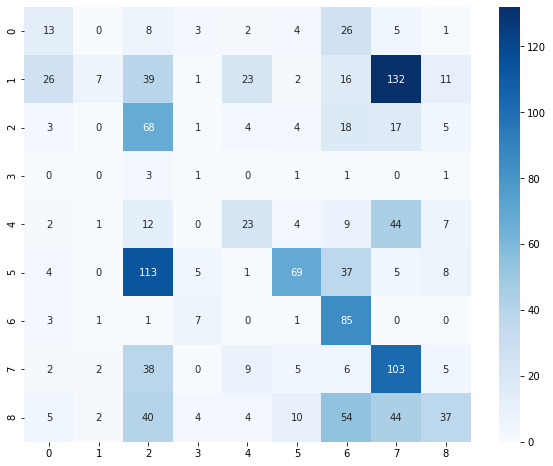

In [100]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

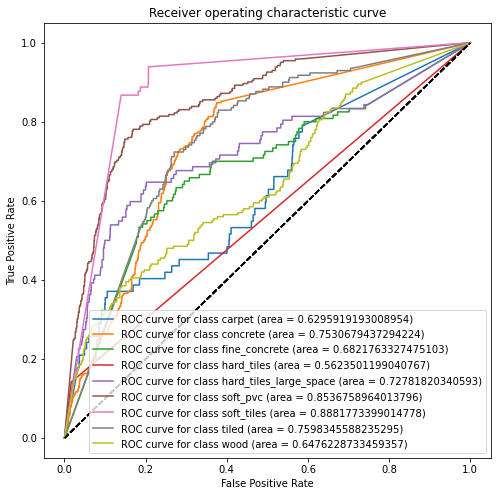

{0: 0.6295919193008954, 1: 0.7530679437294224, 2: 0.6821763327475103, 3: 0.5623501199040767, 4: 0.72781820340593, 5: 0.8536758964013796, 6: 0.8881773399014778, 7: 0.7598345588235295, 8: 0.6476228733459357}
0.7227016875066842


In [101]:
n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = GaussianNB()
# classifier
#clf = OneVsRestClassifier(model)

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### Decision Trees 

In [102]:
%%time
distributions = dict(max_depth = [25,50, 100, 250,500],
                    min_samples_split = [0,25,50,100])
model = tree.DecisionTreeClassifier()
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring = 'f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_

Wall time: 28.1 s


{'min_samples_split': 25, 'max_depth': 500}

In [108]:
#https://www.geeksforgeeks.org/stratified-k-fold-cross-validation/
#https://stackoverflow.com/questions/45969390/difference-between-stratifiedkfold-and-stratifiedshufflesplit-in-sklearn#:~:text=StratifiedKFold%20is%20a%20variation%20of%20KFold.%20First%2C%20StratifiedKFold,and%20always%20shuffles%20data%20one%20time%20before%20splitting.
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = tree.DecisionTreeClassifier( max_depth = 500, min_samples_split = 25)
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.69140625
For fold 1 score is : 0.69921875
For fold 2 score is : 0.7019607843137254
For fold 3 score is : 0.6941176470588235
For fold 4 score is : 0.6352941176470588
For fold 5 score is : 0.7294117647058823
For fold 6 score is : 0.6823529411764706
For fold 7 score is : 0.6705882352941176
For fold 8 score is : 0.6980392156862745
For fold 9 score is : 0.6862745098039216
Average score is : 0.6888664215686275


In [109]:
model = tree.DecisionTreeClassifier( max_depth = 250, min_samples_split = 25)
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [110]:
print(report)

              precision    recall  f1-score   support

           0       0.49      0.56      0.53        62
           1       0.75      0.77      0.76       257
           2       0.70      0.80      0.75       120
           3       0.00      0.00      0.00         7
           4       0.77      0.61      0.68       102
           5       0.71      0.75      0.73       242
           6       0.72      0.85      0.78        98
           7       0.80      0.64      0.71       170
           8       0.66      0.64      0.65       200

    accuracy                           0.71      1258
   macro avg       0.62      0.62      0.62      1258
weighted avg       0.71      0.71      0.71      1258



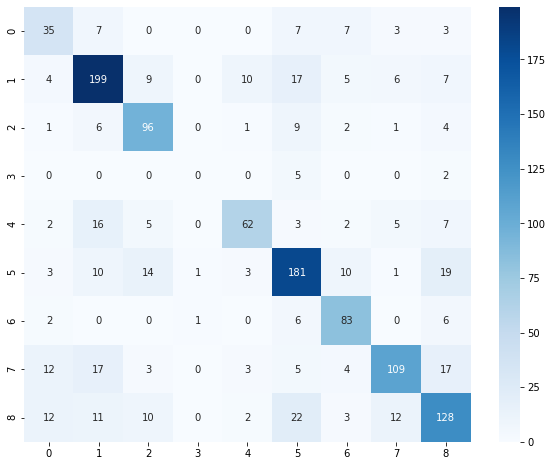

In [111]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

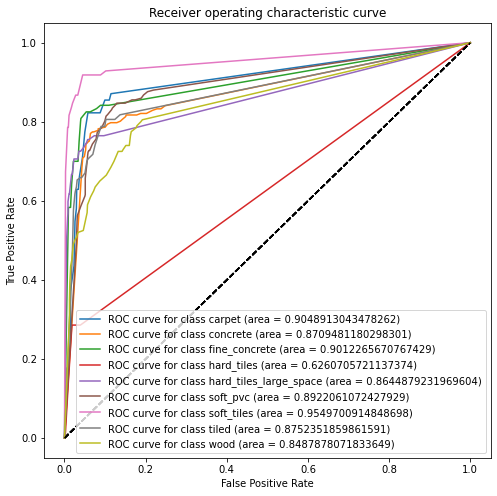

{0: 0.9048913043478262, 1: 0.8709481180298301, 2: 0.9012265670767429, 3: 0.6260705721137374, 4: 0.8644879231969604, 5: 0.8922061072427929, 6: 0.9549700914848698, 7: 0.8752351859861591, 8: 0.8487878071833649}
0.8598692974069204


In [112]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder

n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = tree.DecisionTreeClassifier( max_depth = 500, min_samples_split = 25)
# classifier
#clf = OneVsRestClassifier(model)

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### Random forest model 

In [ ]:
%%time
distributions = dict(n_estimators=[100,500,1000,5000], 
                    max_depth = [25,50, 100, 250,500],
                    min_samples_split = [0,25,50,100],
                    bootstrap = [True, False])
model = RandomForestClassifier()
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring = 'f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_


Wall time: 28min 10s


{'n_estimators': 500,
 'min_samples_split': 25,
 'max_depth': 50,
 'bootstrap': False}

In [113]:
#https://www.geeksforgeeks.org/stratified-k-fold-cross-validation/
#https://stackoverflow.com/questions/45969390/difference-between-stratifiedkfold-and-stratifiedshufflesplit-in-sklearn#:~:text=StratifiedKFold%20is%20a%20variation%20of%20KFold.%20First%2C%20StratifiedKFold,and%20always%20shuffles%20data%20one%20time%20before%20splitting.

skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = RandomForestClassifier(n_estimators= 500, min_samples_split = 25, max_depth = 50, bootstrap = False)
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.83984375
For fold 1 score is : 0.84375
For fold 2 score is : 0.807843137254902
For fold 3 score is : 0.8392156862745098
For fold 4 score is : 0.8235294117647058
For fold 5 score is : 0.8352941176470589
For fold 6 score is : 0.7529411764705882
For fold 7 score is : 0.8117647058823529
For fold 8 score is : 0.8588235294117647
For fold 9 score is : 0.807843137254902
Average score is : 0.8220848651960784


In [114]:
model = RandomForestClassifier(n_estimators= 500, min_samples_split = 25, max_depth = 50, bootstrap = False)
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [115]:
print(report)

              precision    recall  f1-score   support

           0       0.94      0.71      0.81        62
           1       0.80      0.88      0.84       257
           2       0.87      0.65      0.74       120
           3       0.00      0.00      0.00         7
           4       0.92      0.78      0.85       102
           5       0.80      0.91      0.85       242
           6       0.88      0.94      0.91        98
           7       0.84      0.79      0.82       170
           8       0.79      0.83      0.81       200

    accuracy                           0.83      1258
   macro avg       0.76      0.72      0.74      1258
weighted avg       0.83      0.83      0.82      1258



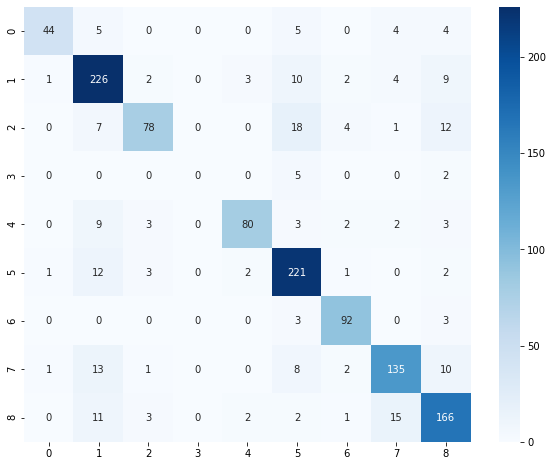

In [116]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

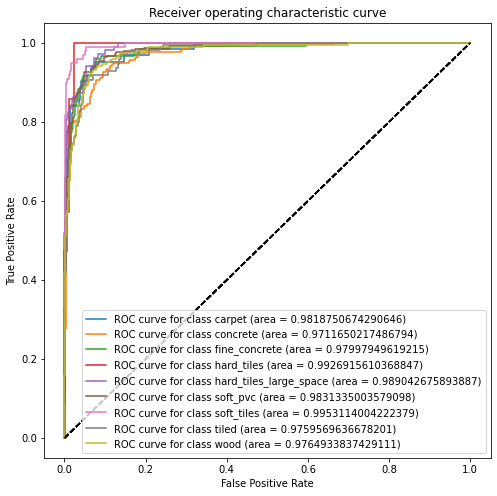

{0: 0.9818750674290646, 1: 0.9711650217486794, 2: 0.97997949619215, 3: 0.9926915610368847, 4: 0.989042675893887, 5: 0.9831335003579098, 6: 0.9953114004222379, 7: 0.9759569636678201, 8: 0.9764933837429111}
0.9828498967212825


In [117]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder

n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = RandomForestClassifier(n_estimators= 500, min_samples_split = 25, max_depth = 50, bootstrap = False)
# classifier
#clf = OneVsRestClassifier(model)

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### XGBoost 

In [ ]:
%%time

distributions = {
        'n_estimators': [0,50,250,500,1000],
        'max_depth': [0, 5, 10,50]
        }
model = XGBClassifier(nthread = -1,verbosity = 0, objective = 'multi:softmax')
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring = 'f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_


Wall time: 13min 10s


{'n_estimators': 500, 'max_depth': 5}

In [121]:
#https://www.geeksforgeeks.org/stratified-k-fold-cross-validation/
#https://stackoverflow.com/questions/45969390/difference-between-stratifiedkfold-and-stratifiedshufflesplit-in-sklearn#:~:text=StratifiedKFold%20is%20a%20variation%20of%20KFold.%20First%2C%20StratifiedKFold,and%20always%20shuffles%20data%20one%20time%20before%20splitting.
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    #print(train_index)
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = XGBClassifier(n_estimators= 500, max_depth = 5,verbosity = 0, objective = 'multi:softmax')
    model.fit(X_train_fold, y_train_fold)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

For fold 0 score is : 0.83203125
For fold 1 score is : 0.8515625
For fold 2 score is : 0.8431372549019608
For fold 3 score is : 0.8627450980392157
For fold 4 score is : 0.8470588235294118
For fold 5 score is : 0.8352941176470589
For fold 6 score is : 0.8117647058823529
For fold 7 score is : 0.8470588235294118
For fold 8 score is : 0.8666666666666667
For fold 9 score is : 0.8235294117647058
Average score is : 0.8420848651960784


In [122]:
model = XGBClassifier(n_estimators= 500, max_depth = 5,verbosity = 0, objective = 'multi:softmax', early_stopping_rounds = 20)
model.fit(X_train, y_train)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

In [123]:
print(report)

              precision    recall  f1-score   support

           0       0.83      0.65      0.73        62
           1       0.84      0.92      0.88       257
           2       0.90      0.72      0.80       120
           3       1.00      0.57      0.73         7
           4       0.93      0.84      0.89       102
           5       0.84      0.91      0.87       242
           6       0.86      0.96      0.91        98
           7       0.80      0.82      0.81       170
           8       0.84      0.80      0.82       200

    accuracy                           0.85      1258
   macro avg       0.87      0.80      0.83      1258
weighted avg       0.85      0.85      0.85      1258



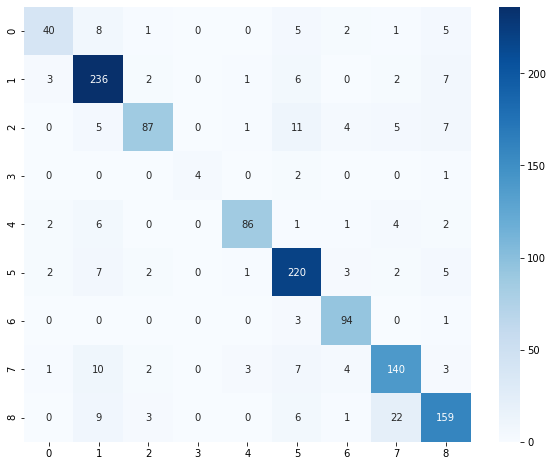

In [124]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

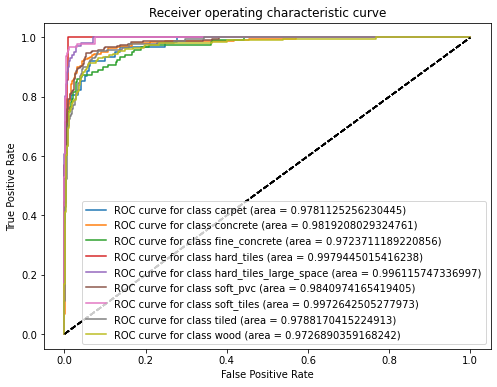

{0: 0.9781125256230445, 1: 0.9819208029324761, 2: 0.9723711189220856, 3: 0.9979445015416238, 4: 0.996115747336997, 5: 0.9840974165419405, 6: 0.9972642505277973, 7: 0.9788170415224913, 8: 0.9726890359168242}
0.9843702712072534


In [73]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder

n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = XGBClassifier(n_estimators= 500, max_depth = 5,verbosity = 0, objective = 'multi:softmax')

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### LGBM 

- Histogram based algorithm to find optimum splits for the tree
- Downsamples data and features using GOSS (Gradient based One Side Sampling) and EFB (Exclusive Feature Bundling)

Reference: https://towardsdatascience.com/what-makes-lightgbm-lightning-fast-a27cf0d9785e

In [ ]:
# https://www.analyticsvidhya.com/blog/2017/06/which-algorithm-takes-the-crown-light-gbm-vs-xgboost/
distributions = {
        'num_iterations' : [100, 500, 1000],
        'n_estimators': [200, 250,500,1000],
        'max_depth': [5, 10,50],
        'verbose' : [-1]
        }
model = LGBMClassifier(num_threads = -1, application = 'multiclass')
clf = RandomizedSearchCV(model, distributions, random_state=0, scoring = 'f1_micro')
search = clf.fit(X_train, y_train)
search.best_params_


[LightGBM] [Warning] num_threads is set=-1, n_jobs=-1 will be ignored. Current value: num_threads=-1
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] num_threads is set=-1, n_jobs=-1 will be ignored. Current value: num_threads=-1
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] num_threads is set=-1, n_jobs=-1 will be ignored. Current value: num_threads=-1
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] num_threads is set=-1, n_jobs=-1 will be ignored. Current value: num_threads=-1
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] num_threads is set=-1, n_jobs=-1 will be ignored. Curre

{'verbose': -1, 'num_iterations': 1000, 'n_estimators': 500, 'max_depth': 10}

In [75]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
    model.fit(X_train_fold, y_train_fold, verbose = -1)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 0 score is : 0.84375
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 1 score is : 0.87109375
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 2 score is : 0.8627450980392157
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 3 score is : 0.9019607843137255
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 4 score is : 0.8745098039215686
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For fold 5 score is : 0.8509803921

In [126]:
model = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
model.fit(X_train, y_train, verbose = -1)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


In [127]:
print(report)

              precision    recall  f1-score   support

           0       0.88      0.69      0.77        62
           1       0.87      0.93      0.89       257
           2       0.92      0.72      0.81       120
           3       1.00      0.43      0.60         7
           4       0.94      0.85      0.89       102
           5       0.83      0.93      0.88       242
           6       0.86      0.97      0.91        98
           7       0.85      0.86      0.85       170
           8       0.87      0.83      0.85       200

    accuracy                           0.87      1258
   macro avg       0.89      0.80      0.83      1258
weighted avg       0.87      0.87      0.86      1258



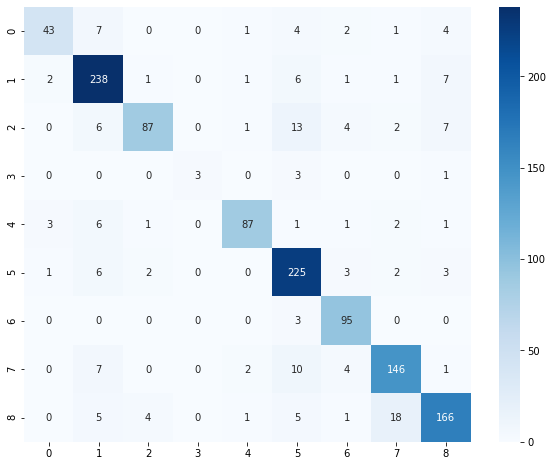

In [128]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


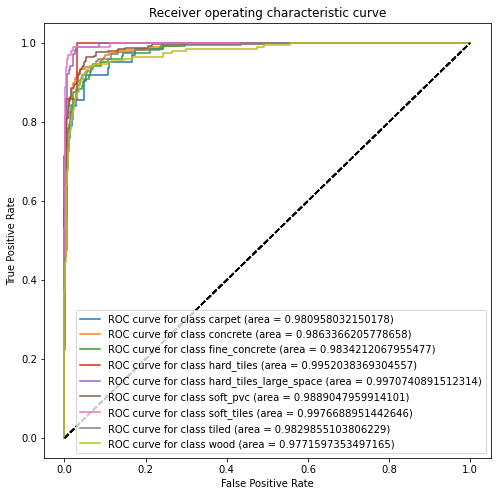

{0: 0.980958032150178, 1: 0.9863366205778658, 2: 0.9834212067955477, 3: 0.9952038369304557, 4: 0.9970740891512314, 5: 0.9889047959914101, 6: 0.9976688951442646, 7: 0.9829855103806229, 8: 0.9771597353497165}
0.9877458580523659


In [129]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder

n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

model = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')

y_score = model.fit(X_train, y_train).predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### CatBoost 


- Ordered boosting implementation meant esp for categorical feature data
- Handling of categorical features using ordered target statistics (uses only past values of features for calculation of a 'target statistic' that will replace the categorical feature in the encoding)
- Prediction shift problem overcome by ordered boosting (similar to ordered TS)
- Parameters:
   - depth: depth of tree
   - l2_leaf_reg: regularization added to calculation of predicted values
   - learning rate: decides the step to take towards the minimum along the gradient curve
   - random_strength: adds a normally distributed random variable to the score of the feature
   - bagging_temperature: Bayesian bootstrap ranging from 0 (weights are all 1s) to 1 (weights assigned from exponential disb)

References : https://github.com/catboost/catboost/issues/373, https://catboost.ai/docs/concepts/parameter-tuning.html

In [ ]:
model = CatBoostClassifier(loss_function='MultiClass')

grid = {'learning_rate': [0.03, 0.1],
        'depth': [4, 7, 10],
        'l2_leaf_reg': [1, 3, 5, 7, 9],
        'leaf_estimation_iterations' : [50, 100]}

randomized_search_result = model.randomized_search(grid,
                                                   X=X_train,
                                                   y=y_train,
                                                   plot=True,
                                                  verbose = False)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 2.1433532	test: 2.1448433	best: 2.1448433 (0)	total: 178ms	remaining: 2m 58s
1:	learn: 2.0931679	test: 2.0952330	best: 2.0952330 (1)	total: 328ms	remaining: 2m 43s
2:	learn: 2.0491334	test: 2.0549985	best: 2.0549985 (2)	total: 476ms	remaining: 2m 38s
3:	learn: 2.0024137	test: 2.0098830	best: 2.0098830 (3)	total: 650ms	remaining: 2m 41s
4:	learn: 1.9622480	test: 1.9729528	best: 1.9729528 (4)	total: 813ms	remaining: 2m 41s
5:	learn: 1.9219420	test: 1.9340395	best: 1.9340395 (5)	total: 989ms	remaining: 2m 43s
6:	learn: 1.8870018	test: 1.8993812	best: 1.8993812 (6)	total: 1.17s	remaining: 2m 46s
7:	learn: 1.8520510	test: 1.8680532	best: 1.8680532 (7)	total: 1.31s	remaining: 2m 42s
8:	learn: 1.8119518	test: 1.8305163	best: 1.8305163 (8)	total: 1.47s	remaining: 2m 42s
9:	learn: 1.7822344	test: 1.8039665	best: 1.8039665 (9)	total: 1.63s	remaining: 2m 41s
10:	learn: 1.7555284	test: 1.7798732	best: 1.7798732 (10)	total: 1.81s	remaining: 2m 42s
11:	learn: 1.7314872	test: 1.7592443	best

The above plot shows the multiclass (cross entropy loss) loss at different parameters for the model. The minimum loss is obtained at the point marked in green. 

In [80]:
skf = StratifiedKFold(n_splits=10, shuffle = True, random_state=42)

scores = 0
for idx , (train_index, test_index) in enumerate(skf.split(X_train, y_train)):
    X_train_fold= X_train.iloc[train_index]
    X_test_fold = X_train.iloc[test_index]
    y_train_fold = y_train[train_index]
    y_test_fold = y_train[test_index]
    model = CatBoostClassifier(
            loss_function='MultiClass', 
            leaf_estimation_iterations = 50,
            random_strength = 0.5,
            depth = 7,
            l2_leaf_reg = 9,
            learning_rate=0.1,
            bagging_temperature = 0.5
        )
    model.fit(X_train_fold, y_train_fold, verbose = False)
    print('For fold',idx, 'score is :',model.score(X_test_fold, y_test_fold))
    scores += model.score(X_test_fold, y_test_fold)
    
print('Average score is :',scores/skf.get_n_splits())


For fold 0 score is : 0.8828125
For fold 1 score is : 0.90234375
For fold 2 score is : 0.8980392156862745
For fold 3 score is : 0.9215686274509803
For fold 4 score is : 0.8941176470588236
For fold 5 score is : 0.8745098039215686
For fold 6 score is : 0.8470588235294118
For fold 7 score is : 0.9215686274509803
For fold 8 score is : 0.9098039215686274
For fold 9 score is : 0.8627450980392157
Average score is : 0.8914568014705881


In [6]:
X_train_, X_cv, y_train_, y_cv = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify = y_train)

In [7]:
#Plot to figure out the best early stopping params
early_stopping_params = [10,25,30,50,60,100,200,500]

def log_loss(y_true, y_pred):
    return np.sum([ -y_true[i]*np.log10(y_pred[i]) - (1-y_true[i])*np.log10(1 - y_pred[i]) for i in range(len(y_pred))] )/len(y_pred)

accuracy = []
loss = []

for e in early_stopping_params:
    model = CatBoostClassifier(
            loss_function='MultiClass', 
            leaf_estimation_iterations = 50,
            random_strength = 0.5,
            depth = 7,
            l2_leaf_reg = 9,
            learning_rate=0.1,
            bagging_temperature = 0.5
        )
    model.fit(X_train_, y_train_, verbose = 200, eval_set = (X_cv, y_cv),early_stopping_rounds= e, plot = True)
    report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])
    
    y_true_ohe = np.zeros((len(y_test), 9))
    for ind, i in enumerate(y_test):
        y_true_ohe[ind,i] = 1
    
    loss.append(log_loss(y_true_ohe, model.predict_proba(X_test)))
    accuracy.append(accuracy_score(y_test, model.predict(X_test)))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.07s	remaining: 17m 54s
Stopped by overfitting detector  (10 iterations wait)

bestTest = 0.4190036939
bestIteration = 173

Shrink model to first 174 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.16s	remaining: 19m 14s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 50s	remaining: 15m 16s
Stopped by overfitting detector  (25 iterations wait)

bestTest = 0.3991632041
bestIteration = 310

Shrink model to first 311 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.13s	remaining: 18m 50s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 48s	remaining: 15m 9s
Stopped by overfitting detector  (30 iterations wait)

bestTest = 0.3991632041
bestIteration = 310

Shrink model to first 311 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.12s	remaining: 18m 41s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 48s	remaining: 15m 6s
400:	learn: 0.0059578	test: 0.3919541	best: 0.3915606 (393)	total: 7m 34s	remaining: 11m 19s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.387055054
bestIteration = 505

Shrink model to first 506 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.13s	remaining: 18m 48s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 48s	remaining: 15m 9s
400:	learn: 0.0059578	test: 0.3919541	best: 0.3915606 (393)	total: 7m 38s	remaining: 11m 24s
Stopped by overfitting detector  (60 iterations wait)

bestTest = 0.387055054
bestIteration = 505

Shrink model to first 506 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.12s	remaining: 18m 36s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 49s	remaining: 15m 12s
400:	learn: 0.0059578	test: 0.3919541	best: 0.3915606 (393)	total: 7m 36s	remaining: 11m 22s
600:	learn: 0.0029294	test: 0.3870067	best: 0.3869754 (599)	total: 11m 24s	remaining: 7m 34s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.3859224861
bestIteration = 678

Shrink model to first 679 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.11s	remaining: 18m 29s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 49s	remaining: 15m 10s
400:	learn: 0.0059578	test: 0.3919541	best: 0.3915606 (393)	total: 7m 36s	remaining: 11m 21s
600:	learn: 0.0029294	test: 0.3870067	best: 0.3869754 (599)	total: 11m 37s	remaining: 7m 43s
800:	learn: 0.0019154	test: 0.3863791	best: 0.3859225 (678)	total: 15m 30s	remaining: 3m 51s
999:	learn: 0.0014386	test: 0.3847882	best: 0.3839898 (890)	total: 19m 19s	remaining: 0us

bestTest = 0.383989792
bestIteration = 890

Shrink model to first 891 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9453323	test: 1.9637302	best: 1.9637302 (0)	total: 1.19s	remaining: 19m 50s
200:	learn: 0.0232059	test: 0.4166055	best: 0.4164251 (199)	total: 3m 50s	remaining: 15m 17s
400:	learn: 0.0059578	test: 0.3919541	best: 0.3915606 (393)	total: 7m 44s	remaining: 11m 33s
600:	learn: 0.0029294	test: 0.3870067	best: 0.3869754 (599)	total: 11m 39s	remaining: 7m 44s
800:	learn: 0.0019154	test: 0.3863791	best: 0.3859225 (678)	total: 15m 33s	remaining: 3m 51s
999:	learn: 0.0014386	test: 0.3847882	best: 0.3839898 (890)	total: 19m 25s	remaining: 0us

bestTest = 0.383989792
bestIteration = 890

Shrink model to first 891 iterations.


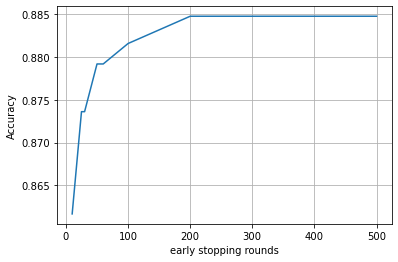

In [8]:
plt.figure()
plt.plot(early_stopping_params,accuracy)
plt.ylabel('Accuracy')
plt.xlabel('early stopping rounds')
plt.grid()
plt.show()

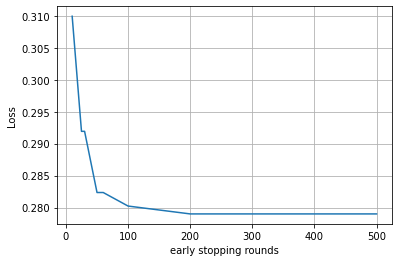

In [9]:
plt.figure()
plt.plot(early_stopping_params,loss)
plt.ylabel('Loss')
plt.xlabel('early stopping rounds')
plt.grid()
plt.show()

In [11]:
model = CatBoostClassifier(
        loss_function='MultiClass', 
        leaf_estimation_iterations = 50,
        random_strength = 0.5,
        depth = 7,
        l2_leaf_reg = 9,
        learning_rate=0.1,
        bagging_temperature = 0.5
    )
model.fit(X_train, y_train, verbose = 200,  plot = True, early_stopping_rounds = 250)
report = classification_report(y_test, model.predict(X_test), labels = [0,1,2,3,4,5,6,7,8])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.9467655	total: 1.26s	remaining: 20m 59s
200:	learn: 0.0269473	total: 4m 1s	remaining: 15m 58s
400:	learn: 0.0063264	total: 7m 58s	remaining: 11m 54s
600:	learn: 0.0033351	total: 11m 56s	remaining: 7m 55s
800:	learn: 0.0022170	total: 15m 52s	remaining: 3m 56s
999:	learn: 0.0015938	total: 19m 50s	remaining: 0us


In [13]:
print(report)

              precision    recall  f1-score   support

           0       0.90      0.76      0.82        62
           1       0.88      0.93      0.90       257
           2       0.94      0.85      0.89       120
           3       1.00      0.71      0.83         7
           4       0.95      0.89      0.92       102
           5       0.90      0.96      0.93       242
           6       0.97      0.98      0.97        98
           7       0.85      0.88      0.87       170
           8       0.90      0.85      0.87       200

    accuracy                           0.90      1258
   macro avg       0.92      0.87      0.89      1258
weighted avg       0.90      0.90      0.90      1258



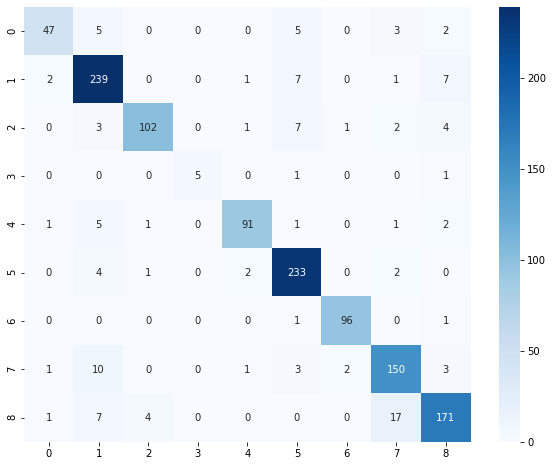

In [14]:
cm = confusion_matrix(y_test, model.predict(X_test) )
plt.figure(figsize = (10,8))
sns.heatmap(cm, annot = True,cmap='Blues', fmt='g')

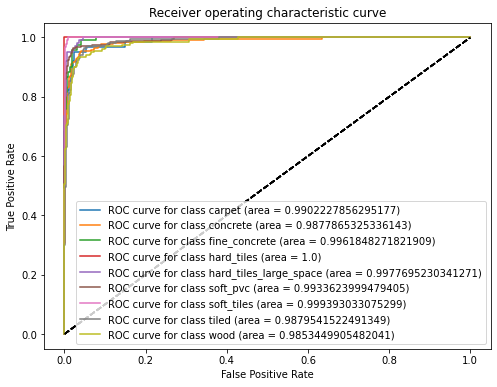

{0: 0.9902227856295177, 1: 0.9877865325336143, 2: 0.9961848271821909, 3: 1.0, 4: 0.9977695230341271, 5: 0.9933623999479405, 6: 0.999393033075299, 7: 0.9879541522491349, 8: 0.9853449905482041}
0.9931131382444478


In [17]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder

n_classes = 9
classes=['carpet', 'concrete', 'fine_concrete', 'hard_tiles','hard_tiles_large_space', 'soft_pvc', 'soft_tiles', 'tiled','wood']

y_score = model.predict_proba(X_test)

enc = OneHotEncoder(handle_unknown='ignore')
y_test_ = enc.fit_transform(np.asarray(y_test).reshape(-1,1)).toarray()

plot_auc_roc_curve(y_test_, y_score)

#### Results 

In [1]:
from tabulate import tabulate
print(tabulate([[ 'Logistic Regression', 0.62, 0.62, 0.897], [ 'SVM', 0.6, 0.6, 0.882], [ 'SVM with polynomial kernel', 0.70, 0.70, 0.934], [ 'SVM with rbf kernel', 0.20, 0.20, 0.5], [ 'KNN', 0.58, 0.58, 0.89], [ 'NB', 0.32, 0.32, 0.722],[ 'Decision Trees', 0.71, 0.71, 0.859],[ 'Random Forest', 0.83, 0.83, 0.982],[ 'XGBoost', 0.85, 0.85, 0.984],[ 'LGBM', 0.87, 0.87, 0.9877],[ 'CatBoost', 0.90, 0.90, 0.993]], headers=['Model', 'F1 Score (micro averaged)', 'Accuracy', 'ROC AUC Score average']))


Model                         F1 Score (micro averaged)    Accuracy    ROC AUC Score average
--------------------------  ---------------------------  ----------  -----------------------
Logistic Regression                                0.62        0.62                   0.897
SVM                                                0.6         0.6                    0.882
SVM with polynomial kernel                         0.7         0.7                    0.934
SVM with rbf kernel                                0.2         0.2                    0.5
KNN                                                0.58        0.58                   0.89
NB                                                 0.32        0.32                   0.722
Decision Trees                                     0.71        0.71                   0.859
Random Forest                                      0.83        0.83                   0.982
XGBoost                                            0.85        0.85              

Observations:
- ROC AUC scores are high and it might not be a good indicator because of high imbalance in the data
- F1 Score might serve as a better measure of correct classification of data

Reference: https://stats.stackexchange.com/questions/210700/how-to-choose-between-roc-auc-and-f1-score
https://inblog.in/AUC-ROC-score-and-curve-in-multiclass-classification-problems-2ja4jOHb2X#:~:text=A%20macro%2Daverage%20will%20compute,score%20calculated%20for%20each%20label.

- SVM, Decision trees, and KNN perform well for multiclass classification.
- Ensemble models also acheive good accuracy as seen in random forest model
- Gradient boosting acheives higher accuracy although, especially gradient boosting implementaion by CatBoost which has given the best accuracy though not the fastest out of the three gradient boosting implementations.
- LGBM has the fastest implementation and is only a little worse than CatBoost in terms of accuracy.


### Stacking classifiers

#### Load data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [158]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import scipy
from scipy.fft import fft, fftfreq
#import peakutils
import statsmodels.api as sm
import numpy as np
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')

In [159]:
df1 = pd.read_csv('normalized_data_1.csv')
df2 = pd.read_csv('normalized_data_2.csv')
df3 = pd.read_csv('normalized_data_3.csv')
df4 = pd.read_csv('normalized_data_4.csv')
df5 = pd.read_csv('normalized_data_3_amp.csv')
df = pd.concat([df1,df2,df3,df4,df5], axis = 1)  #For distance measure based algorithms

In [162]:
from sklearn.preprocessing import LabelEncoder
result = pd.read_csv("y_train_.csv")
y = result['surface']
le = LabelEncoder()
y = le.fit_transform(y)

X = df.drop(columns = 'series_id')

In [163]:
#Split into 80:20 for train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)
print(len(X_train),len(y_train), len(X_test), len(y_test))

3048 3048 762 762


In [164]:
#Split X_train into two datasets in 50:50 ratio
X_train_1, X_train_2, y_train_1, y_train_2 = train_test_split(X_train, y_train, test_size=0.5, random_state=42)
print(len(X_train_1),len(X_train_1), len(y_train_1), len(y_train_1))

1524 1524 1524 1524


In [165]:
def sampling_with_replacement(x_train):
  indices = np.random.choice(len(x_train), size= len(x_train), replace=True)
  d = [x_train.iloc[i] for i in indices]
  return d

In [ ]:
import multiprocessing as mp
print("Number of processors: ", mp.cpu_count())

Number of processors:  8


In [166]:
def base_model_KNN(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model = KNeighborsClassifier(n_neighbors= 9)
  #model = KNeighborsClassifier()
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [167]:
def base_model_LR(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model = LogisticRegression( C = 2.84, penalty= 'l2')
  #model = LogisticRegression()
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred

In [168]:
def base_model_SVM_linear(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model = SVC( C = 19.17, kernel = 'linear')
  #model = SVC( kernel = 'linear')
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [169]:
def base_model_SVM_poly(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  #model =SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  model =SVC(kernel = 'poly')
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [170]:
def base_model_SVM_rbf(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  #model = SVC( C = 3.55, gamma = 8.71, kernel = 'rbf')
  model = SVC(kernel = 'rbf')

  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [171]:
def base_model_NB(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model =GaussianNB()
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [172]:
def base_model_DT(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model =tree.DecisionTreeClassifier( max_depth = 250, min_samples_split = 25)
  #model =tree.DecisionTreeClassifier()
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [173]:
def base_model_RF(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  model = RandomForestClassifier(n_estimators= 500, min_samples_split = 25, max_depth = 50, bootstrap = False)
  #model = RandomForestClassifier()
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(d2_train)
  return model, pred


In [174]:
def base_model_XGB(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  d = np.asarray(d)
  model = XGBClassifier(n_estimators= 500, verbosity = 0, objective = 'multi:softmax')
  #model = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(np.asarray(d2_train))
  return model, pred


In [175]:
def base_model_LGBM(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  d = np.asarray(d)
  model = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  #model = LGBMClassifier(verbose = -1, application = 'multiclass')
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(np.asarray(d2_train))
  return model, pred


In [176]:
def base_model_CB(d1_train, y_train_1, d2_train):

  #Sampling with replacement for D1 or X_train_1
  d = sampling_with_replacement(d1_train)

  #Build model, train with sampled data
  d = np.asarray(d)
  model = CatBoostClassifier(loss_function='MultiClass', leaf_estimation_iterations = 50, random_strength = 0.5, depth = 7, l2_leaf_reg = 9, learning_rate=0.1, bagging_temperature = 0.5, silent = True)
  model.fit(d, y_train_1)

  #Pass D2 or X_train_2 to model
  pred = model.predict(np.asarray(d2_train))
  return model, pred


#### Model : 
- Base model: Single Models
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

Model with params

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
base_model_accuracy = []
num_base_model = [1,5,10]  #no of base models
base_model_name = ['KNN', 'LR', 'SVM_linear','SVM_poly','SVM_rbf','NB','DT','RF', 'XGB']

for bm in base_model_name:

  accuracy_list = []
  for num in num_base_model:

    #MODEL TRAINING

    #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
    if bm == 'KNN':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(num) ) 

    if bm == 'LR':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_LR)(X_train_1, y_train_1, X_train_2) for j in range(num) ) 

    if bm == 'SVM_linear':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_SVM_linear)(X_train_1, y_train_1, X_train_2) for j in range(num) ) 
    
    if bm == 'SVM_poly':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_SVM_poly)(X_train_1, y_train_1, X_train_2) for j in range(num) ) 

    if bm == 'SVM_rbf':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(num) )
      
    if bm == 'NB':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(num) )  
      
    if bm == 'DT':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_DT)(X_train_1, y_train_1, X_train_2) for j in range(num) )  
      
    if bm == 'RF':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(num) )  

    if bm == 'XGB':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_XGB)(X_train_1, y_train_1, X_train_2) for j in range(num) )  
      
    if bm == 'LGBM':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_LGBM)(X_train_1, y_train_1, X_train_2) for j in range(num) )  
      
    if bm == 'CB':
      results = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
              delayed(base_model_CB)(X_train_1, y_train_1, X_train_2) for j in range(num) )  

    
    base_models = [results[i][0] for i in range(len(results))]
    pred_list = [results[i][1] for i in range(len(results))]

    #Get the D2 predictions and target data for metamodel  
    d2_train = np.asarray(pred_list).T
    d2_target = y_train_2

    #Train the metamodel with D2 predictions
    meta_model_1 = KNeighborsClassifier(n_neighbors= 9)
    meta_model_2 = LogisticRegression( C = 2.84, penalty= 'l2')
    meta_model_3 = SVC( C = 19.17, kernel = 'linear')
    meta_model_4 = SVC( C = 19.17, kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
    meta_model_5 = SVC( C = 3.55, gamma = 8.71, kernel = 'rbf')
    meta_model_6 = GaussianNB()
    meta_model_7 = tree.DecisionTreeClassifier( max_depth = 250, min_samples_split = 25)
    meta_model_8 = RandomForestClassifier(n_estimators= 500, min_samples_split = 25, max_depth = 50, bootstrap = False)
    meta_model_9 = XGBClassifier(n_estimators= 500, max_depth = 5,verbosity = 0, objective = 'multi:softmax')
    meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
    meta_model_11 = CatBoostClassifier(loss_function='MultiClass', leaf_estimation_iterations = 50, random_strength = 0.5, depth = 7, l2_leaf_reg = 9, learning_rate=0.1, bagging_temperature = 0.5, silent = True)


    meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
    meta_acc_list = []

    #MODEL EVALUATION
    #Pass X_test data to base models
    test_pred_list = [ base_models[i].predict(np.asarray(X_test)) for i in range(len(base_models))]

    #Get X_test predictions from k models and feed to meta model
    d2_train_test = np.asarray(test_pred_list).T
    d2_target_test = y_test

    for meta_model in meta_model_list:
      meta_model.fit(d2_train, d2_target)

      test_pred = meta_model.predict(d2_train_test)

      print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

      meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

    accuracy_list.append(meta_acc_list)

  base_model_accuracy.append(accuracy_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.1s finished


For 1 base models and metamodel 0, accuracy: 0.1942257217847769
For 1 base models and metamodel 1, accuracy: 0.2020997375328084
For 1 base models and metamodel 2, accuracy: 0.2099737532808399
For 1 base models and metamodel 3, accuracy: 0.2099737532808399
For 1 base models and metamodel 4, accuracy: 0.21916010498687663
For 1 base models and metamodel 5, accuracy: 0.20866141732283464
For 1 base models and metamodel 6, accuracy: 0.21916010498687663
For 1 base models and metamodel 7, accuracy: 0.21916010498687663
For 1 base models and metamodel 8, accuracy: 0.21916010498687663
For 1 base models and metamodel 9, accuracy: 0.21916010498687663
For 1 base models and metamodel 10, accuracy: 0.21916010498687663


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.1s remaining:    4.8s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.2s finished


For 5 base models and metamodel 0, accuracy: 0.23097112860892388
For 5 base models and metamodel 1, accuracy: 0.23097112860892388
For 5 base models and metamodel 2, accuracy: 0.23097112860892388
For 5 base models and metamodel 3, accuracy: 0.23097112860892388
For 5 base models and metamodel 4, accuracy: 0.21916010498687663
For 5 base models and metamodel 5, accuracy: 0.24278215223097113
For 5 base models and metamodel 6, accuracy: 0.24146981627296588
For 5 base models and metamodel 7, accuracy: 0.28346456692913385
For 5 base models and metamodel 8, accuracy: 0.2545931758530184
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.25196850393700787
For 5 base models and metamodel 10, accuracy: 0.24015748031496062


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    5.2s remaining:    3.4s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    6.0s finished


For 10 base models and metamodel 0, accuracy: 0.23097112860892388
For 10 base models and metamodel 1, accuracy: 0.22965879265091863
For 10 base models and metamodel 2, accuracy: 0.23228346456692914
For 10 base models and metamodel 3, accuracy: 0.23228346456692914
For 10 base models and metamodel 4, accuracy: 0.20866141732283464
For 10 base models and metamodel 5, accuracy: 0.22965879265091863
For 10 base models and metamodel 6, accuracy: 0.22572178477690288
For 10 base models and metamodel 7, accuracy: 0.31627296587926507
For 10 base models and metamodel 8, accuracy: 0.33727034120734906
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.33070866141732286
For 10 base models and metamodel 10, accuracy: 0.3346456692913386


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.3s finished


For 1 base models and metamodel 0, accuracy: 0.19160104986876642
For 1 base models and metamodel 1, accuracy: 0.21128608923884515
For 1 base models and metamodel 2, accuracy: 0.2125984251968504
For 1 base models and metamodel 3, accuracy: 0.2125984251968504
For 1 base models and metamodel 4, accuracy: 0.2073490813648294
For 1 base models and metamodel 5, accuracy: 0.2152230971128609
For 1 base models and metamodel 6, accuracy: 0.2073490813648294
For 1 base models and metamodel 7, accuracy: 0.2073490813648294
For 1 base models and metamodel 8, accuracy: 0.2073490813648294
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.2073490813648294
For 1 base models and metamodel 10, accuracy: 0.2073490813648294


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    2.5s remaining:    3.7s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.5s finished


For 5 base models and metamodel 0, accuracy: 0.24015748031496062
For 5 base models and metamodel 1, accuracy: 0.2532808398950131
For 5 base models and metamodel 2, accuracy: 0.25065616797900264
For 5 base models and metamodel 3, accuracy: 0.25065616797900264
For 5 base models and metamodel 4, accuracy: 0.2178477690288714
For 5 base models and metamodel 5, accuracy: 0.25065616797900264
For 5 base models and metamodel 6, accuracy: 0.22965879265091863
For 5 base models and metamodel 7, accuracy: 0.2690288713910761
For 5 base models and metamodel 8, accuracy: 0.2152230971128609
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.21916010498687663
For 5 base models and metamodel 10, accuracy: 0.2204724409448819


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    4.6s remaining:    3.0s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    5.1s finished


For 10 base models and metamodel 0, accuracy: 0.21391076115485563
For 10 base models and metamodel 1, accuracy: 0.23228346456692914
For 10 base models and metamodel 2, accuracy: 0.23097112860892388
For 10 base models and metamodel 3, accuracy: 0.23097112860892388
For 10 base models and metamodel 4, accuracy: 0.20866141732283464
For 10 base models and metamodel 5, accuracy: 0.23622047244094488
For 10 base models and metamodel 6, accuracy: 0.18635170603674542
For 10 base models and metamodel 7, accuracy: 0.24146981627296588
For 10 base models and metamodel 8, accuracy: 0.23622047244094488
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.21916010498687663
For 10 base models and metamodel 10, accuracy: 0.2335958005249344


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    2.5s finished


For 1 base models and metamodel 0, accuracy: 0.19816272965879264
For 1 base models and metamodel 1, accuracy: 0.20341207349081364
For 1 base models and metamodel 2, accuracy: 0.2047244094488189
For 1 base models and metamodel 3, accuracy: 0.2047244094488189
For 1 base models and metamodel 4, accuracy: 0.2204724409448819
For 1 base models and metamodel 5, accuracy: 0.20341207349081364
For 1 base models and metamodel 6, accuracy: 0.22178477690288714
For 1 base models and metamodel 7, accuracy: 0.22178477690288714
For 1 base models and metamodel 8, accuracy: 0.22178477690288714
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.2204724409448819
For 1 base models and metamodel 10, accuracy: 0.2204724409448819


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    4.7s remaining:    7.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.8s finished


For 5 base models and metamodel 0, accuracy: 0.19291338582677164
For 5 base models and metamodel 1, accuracy: 0.23097112860892388
For 5 base models and metamodel 2, accuracy: 0.2099737532808399
For 5 base models and metamodel 3, accuracy: 0.2099737532808399
For 5 base models and metamodel 4, accuracy: 0.20341207349081364
For 5 base models and metamodel 5, accuracy: 0.23097112860892388
For 5 base models and metamodel 6, accuracy: 0.2125984251968504
For 5 base models and metamodel 7, accuracy: 0.24540682414698162
For 5 base models and metamodel 8, accuracy: 0.20078740157480315
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.1942257217847769
For 5 base models and metamodel 10, accuracy: 0.18241469816272965


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    6.7s remaining:    4.4s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   10.1s finished


For 10 base models and metamodel 0, accuracy: 0.2125984251968504
For 10 base models and metamodel 1, accuracy: 0.23490813648293962
For 10 base models and metamodel 2, accuracy: 0.23622047244094488
For 10 base models and metamodel 3, accuracy: 0.23622047244094488
For 10 base models and metamodel 4, accuracy: 0.2047244094488189
For 10 base models and metamodel 5, accuracy: 0.24671916010498687
For 10 base models and metamodel 6, accuracy: 0.2230971128608924
For 10 base models and metamodel 7, accuracy: 0.27165354330708663
For 10 base models and metamodel 8, accuracy: 0.2690288713910761
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.25984251968503935
For 10 base models and metamodel 10, accuracy: 0.2545931758530184


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished


For 1 base models and metamodel 0, accuracy: 0.1942257217847769
For 1 base models and metamodel 1, accuracy: 0.24671916010498687
For 1 base models and metamodel 2, accuracy: 0.24671916010498687
For 1 base models and metamodel 3, accuracy: 0.24671916010498687
For 1 base models and metamodel 4, accuracy: 0.26115485564304464
For 1 base models and metamodel 5, accuracy: 0.24671916010498687
For 1 base models and metamodel 6, accuracy: 0.26115485564304464
For 1 base models and metamodel 7, accuracy: 0.26115485564304464
For 1 base models and metamodel 8, accuracy: 0.26115485564304464
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.26115485564304464
For 1 base models and metamodel 10, accuracy: 0.26115485564304464


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.8s remaining:    5.7s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.9s finished


For 5 base models and metamodel 0, accuracy: 0.2585301837270341
For 5 base models and metamodel 1, accuracy: 0.2204724409448819
For 5 base models and metamodel 2, accuracy: 0.2204724409448819
For 5 base models and metamodel 3, accuracy: 0.2204724409448819
For 5 base models and metamodel 4, accuracy: 0.2664041994750656
For 5 base models and metamodel 5, accuracy: 0.23622047244094488
For 5 base models and metamodel 6, accuracy: 0.26115485564304464
For 5 base models and metamodel 7, accuracy: 0.2782152230971129
For 5 base models and metamodel 8, accuracy: 0.27165354330708663
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.27165354330708663
For 5 base models and metamodel 10, accuracy: 0.2690288713910761


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:  3.8min remaining:  2.6min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  3.9min finished


For 10 base models and metamodel 0, accuracy: 0.2821522309711286
For 10 base models and metamodel 1, accuracy: 0.27296587926509186
For 10 base models and metamodel 2, accuracy: 0.2690288713910761
For 10 base models and metamodel 3, accuracy: 0.2690288713910761
For 10 base models and metamodel 4, accuracy: 0.22572178477690288
For 10 base models and metamodel 5, accuracy: 0.30708661417322836
For 10 base models and metamodel 6, accuracy: 0.28083989501312334
For 10 base models and metamodel 7, accuracy: 0.36220472440944884
For 10 base models and metamodel 8, accuracy: 0.31496062992125984
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.31758530183727035
For 10 base models and metamodel 10, accuracy: 0.28083989501312334


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.9s finished


For 1 base models and metamodel 0, accuracy: 0.22178477690288714
For 1 base models and metamodel 1, accuracy: 0.24146981627296588
For 1 base models and metamodel 2, accuracy: 0.24146981627296588
For 1 base models and metamodel 3, accuracy: 0.24146981627296588
For 1 base models and metamodel 4, accuracy: 0.24803149606299213
For 1 base models and metamodel 5, accuracy: 0.09580052493438321
For 1 base models and metamodel 6, accuracy: 0.24803149606299213
For 1 base models and metamodel 7, accuracy: 0.24803149606299213
For 1 base models and metamodel 8, accuracy: 0.24803149606299213
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.24803149606299213
For 1 base models and metamodel 10, accuracy: 0.24803149606299213


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    4.1s remaining:    6.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.2s finished


For 5 base models and metamodel 0, accuracy: 0.37926509186351703
For 5 base models and metamodel 1, accuracy: 0.3884514435695538
For 5 base models and metamodel 2, accuracy: 0.3963254593175853
For 5 base models and metamodel 3, accuracy: 0.3963254593175853
For 5 base models and metamodel 4, accuracy: 0.38713910761154857
For 5 base models and metamodel 5, accuracy: 0.16404199475065617
For 5 base models and metamodel 6, accuracy: 0.38713910761154857
For 5 base models and metamodel 7, accuracy: 0.38976377952755903
For 5 base models and metamodel 8, accuracy: 0.38976377952755903
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.3884514435695538
For 5 base models and metamodel 10, accuracy: 0.3858267716535433


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    5.9s remaining:    3.9s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    8.3s finished


For 10 base models and metamodel 0, accuracy: 0.400262467191601
For 10 base models and metamodel 1, accuracy: 0.3674540682414698
For 10 base models and metamodel 2, accuracy: 0.3530183727034121
For 10 base models and metamodel 3, accuracy: 0.3530183727034121
For 10 base models and metamodel 4, accuracy: 0.3556430446194226
For 10 base models and metamodel 5, accuracy: 0.2926509186351706
For 10 base models and metamodel 6, accuracy: 0.3805774278215223
For 10 base models and metamodel 7, accuracy: 0.40288713910761154
For 10 base models and metamodel 8, accuracy: 0.38451443569553806
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.37270341207349084
For 10 base models and metamodel 10, accuracy: 0.3753280839895013


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.2s finished


For 1 base models and metamodel 0, accuracy: 0.1942257217847769
For 1 base models and metamodel 1, accuracy: 0.20603674540682415
For 1 base models and metamodel 2, accuracy: 0.2388451443569554
For 1 base models and metamodel 3, accuracy: 0.2388451443569554
For 1 base models and metamodel 4, accuracy: 0.2821522309711286
For 1 base models and metamodel 5, accuracy: 0.2388451443569554
For 1 base models and metamodel 6, accuracy: 0.2821522309711286
For 1 base models and metamodel 7, accuracy: 0.2821522309711286
For 1 base models and metamodel 8, accuracy: 0.2821522309711286
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.2821522309711286
For 1 base models and metamodel 10, accuracy: 0.2821522309711286


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    2.1s remaining:    3.2s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.1s finished


For 5 base models and metamodel 0, accuracy: 0.3359580052493438
For 5 base models and metamodel 1, accuracy: 0.26246719160104987
For 5 base models and metamodel 2, accuracy: 0.2874015748031496
For 5 base models and metamodel 3, accuracy: 0.2874015748031496
For 5 base models and metamodel 4, accuracy: 0.3530183727034121
For 5 base models and metamodel 5, accuracy: 0.2073490813648294
For 5 base models and metamodel 6, accuracy: 0.3661417322834646
For 5 base models and metamodel 7, accuracy: 0.37926509186351703
For 5 base models and metamodel 8, accuracy: 0.35170603674540685
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.35170603674540685
For 5 base models and metamodel 10, accuracy: 0.34908136482939633


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    3.3s remaining:    2.2s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    3.4s finished


For 10 base models and metamodel 0, accuracy: 0.40813648293963256
For 10 base models and metamodel 1, accuracy: 0.33858267716535434
For 10 base models and metamodel 2, accuracy: 0.36351706036745407
For 10 base models and metamodel 3, accuracy: 0.36351706036745407
For 10 base models and metamodel 4, accuracy: 0.29396325459317585
For 10 base models and metamodel 5, accuracy: 0.31496062992125984
For 10 base models and metamodel 6, accuracy: 0.40551181102362205
For 10 base models and metamodel 7, accuracy: 0.46194225721784776
For 10 base models and metamodel 8, accuracy: 0.4238845144356955
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.41601049868766404
For 10 base models and metamodel 10, accuracy: 0.41338582677165353


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.5s finished


For 1 base models and metamodel 0, accuracy: 0.15748031496062992
For 1 base models and metamodel 1, accuracy: 0.2047244094488189
For 1 base models and metamodel 2, accuracy: 0.2047244094488189
For 1 base models and metamodel 3, accuracy: 0.2047244094488189
For 1 base models and metamodel 4, accuracy: 0.2125984251968504
For 1 base models and metamodel 5, accuracy: 0.2047244094488189
For 1 base models and metamodel 6, accuracy: 0.2125984251968504
For 1 base models and metamodel 7, accuracy: 0.2125984251968504
For 1 base models and metamodel 8, accuracy: 0.2125984251968504
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.2125984251968504
For 1 base models and metamodel 10, accuracy: 0.21653543307086615


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    2.7s remaining:    4.1s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.8s finished


For 5 base models and metamodel 0, accuracy: 0.19160104986876642
For 5 base models and metamodel 1, accuracy: 0.21916010498687663
For 5 base models and metamodel 2, accuracy: 0.2230971128608924
For 5 base models and metamodel 3, accuracy: 0.2230971128608924
For 5 base models and metamodel 4, accuracy: 0.20341207349081364
For 5 base models and metamodel 5, accuracy: 0.2204724409448819
For 5 base models and metamodel 6, accuracy: 0.1784776902887139
For 5 base models and metamodel 7, accuracy: 0.21128608923884515
For 5 base models and metamodel 8, accuracy: 0.1784776902887139
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.18110236220472442
For 5 base models and metamodel 10, accuracy: 0.17060367454068243


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    3.5s remaining:    2.3s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    4.1s finished


For 10 base models and metamodel 0, accuracy: 0.16272965879265092
For 10 base models and metamodel 1, accuracy: 0.2020997375328084
For 10 base models and metamodel 2, accuracy: 0.2047244094488189
For 10 base models and metamodel 3, accuracy: 0.2047244094488189
For 10 base models and metamodel 4, accuracy: 0.2047244094488189
For 10 base models and metamodel 5, accuracy: 0.20603674540682415
For 10 base models and metamodel 6, accuracy: 0.2073490813648294
For 10 base models and metamodel 7, accuracy: 0.24934383202099739
For 10 base models and metamodel 8, accuracy: 0.21391076115485563
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.2152230971128609
For 10 base models and metamodel 10, accuracy: 0.20078740157480315


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   10.9s finished


For 1 base models and metamodel 0, accuracy: 0.2047244094488189
For 1 base models and metamodel 1, accuracy: 0.24671916010498687
For 1 base models and metamodel 2, accuracy: 0.24671916010498687
For 1 base models and metamodel 3, accuracy: 0.24671916010498687
For 1 base models and metamodel 4, accuracy: 0.27034120734908135
For 1 base models and metamodel 5, accuracy: 0.27165354330708663
For 1 base models and metamodel 6, accuracy: 0.27034120734908135
For 1 base models and metamodel 7, accuracy: 0.27034120734908135
For 1 base models and metamodel 8, accuracy: 0.27034120734908135
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.27034120734908135
For 1 base models and metamodel 10, accuracy: 0.27034120734908135


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   17.9s remaining:   26.9s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   20.6s finished


For 5 base models and metamodel 0, accuracy: 0.2677165354330709
For 5 base models and metamodel 1, accuracy: 0.2532808398950131
For 5 base models and metamodel 2, accuracy: 0.2545931758530184
For 5 base models and metamodel 3, accuracy: 0.2545931758530184
For 5 base models and metamodel 4, accuracy: 0.2979002624671916
For 5 base models and metamodel 5, accuracy: 0.27165354330708663
For 5 base models and metamodel 6, accuracy: 0.3083989501312336
For 5 base models and metamodel 7, accuracy: 0.3293963254593176
For 5 base models and metamodel 8, accuracy: 0.30577427821522307
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.3005249343832021
For 5 base models and metamodel 10, accuracy: 0.29396325459317585


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:   29.2s remaining:   19.4s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   40.3s finished


For 10 base models and metamodel 0, accuracy: 0.2887139107611549
For 10 base models and metamodel 1, accuracy: 0.30971128608923887
For 10 base models and metamodel 2, accuracy: 0.3110236220472441
For 10 base models and metamodel 3, accuracy: 0.3110236220472441
For 10 base models and metamodel 4, accuracy: 0.21391076115485563
For 10 base models and metamodel 5, accuracy: 0.32545931758530183
For 10 base models and metamodel 6, accuracy: 0.3031496062992126
For 10 base models and metamodel 7, accuracy: 0.3661417322834646
For 10 base models and metamodel 8, accuracy: 0.3805774278215223
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.3569553805774278
For 10 base models and metamodel 10, accuracy: 0.33727034120734906


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:  1.1min finished


For 1 base models and metamodel 0, accuracy: 0.20078740157480315
For 1 base models and metamodel 1, accuracy: 0.2047244094488189
For 1 base models and metamodel 2, accuracy: 0.2047244094488189
For 1 base models and metamodel 3, accuracy: 0.2047244094488189
For 1 base models and metamodel 4, accuracy: 0.1942257217847769
For 1 base models and metamodel 5, accuracy: 0.2047244094488189
For 1 base models and metamodel 6, accuracy: 0.1942257217847769
For 1 base models and metamodel 7, accuracy: 0.1942257217847769
For 1 base models and metamodel 8, accuracy: 0.1942257217847769
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 1 base models and metamodel 9, accuracy: 0.1942257217847769
For 1 base models and metamodel 10, accuracy: 0.1942257217847769


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  5.9min remaining:  8.8min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  6.0min finished


For 5 base models and metamodel 0, accuracy: 0.2073490813648294
For 5 base models and metamodel 1, accuracy: 0.2099737532808399
For 5 base models and metamodel 2, accuracy: 0.2178477690288714
For 5 base models and metamodel 3, accuracy: 0.2178477690288714
For 5 base models and metamodel 4, accuracy: 0.1994750656167979
For 5 base models and metamodel 5, accuracy: 0.21653543307086615
For 5 base models and metamodel 6, accuracy: 0.21916010498687663
For 5 base models and metamodel 7, accuracy: 0.24803149606299213
For 5 base models and metamodel 8, accuracy: 0.2047244094488189
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.2047244094488189
For 5 base models and metamodel 10, accuracy: 0.21391076115485563


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed: 10.0min remaining:  6.6min
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed: 12.3min finished


For 10 base models and metamodel 0, accuracy: 0.20078740157480315
For 10 base models and metamodel 1, accuracy: 0.23228346456692914
For 10 base models and metamodel 2, accuracy: 0.2230971128608924
For 10 base models and metamodel 3, accuracy: 0.2230971128608924
For 10 base models and metamodel 4, accuracy: 0.2047244094488189
For 10 base models and metamodel 5, accuracy: 0.24278215223097113
For 10 base models and metamodel 6, accuracy: 0.2047244094488189
For 10 base models and metamodel 7, accuracy: 0.2585301837270341
For 10 base models and metamodel 8, accuracy: 0.24803149606299213
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 10 base models and metamodel 9, accuracy: 0.23753280839895013
For 10 base models and metamodel 10, accuracy: 0.22965879265091863


In [ ]:
from prettytable import PrettyTable
for j in range(len(base_model_accuracy)):
  model_1_accuracy = [str(base_model_accuracy[j][i][0]) for i in range(len(base_model_accuracy[j]))]
  model_2_accuracy = [str(base_model_accuracy[j][i][1]) for i in range(len(base_model_accuracy[j]))]
  model_3_accuracy = [str(base_model_accuracy[j][i][2]) for i in range(len(base_model_accuracy[j]))]
  model_4_accuracy = [str(base_model_accuracy[j][i][3]) for i in range(len(base_model_accuracy[j]))]
  model_5_accuracy = [str(base_model_accuracy[j][i][4]) for i in range(len(base_model_accuracy[j]))]
  model_6_accuracy = [str(base_model_accuracy[j][i][5]) for i in range(len(base_model_accuracy[j]))]
  model_7_accuracy = [str(base_model_accuracy[j][i][6]) for i in range(len(base_model_accuracy[j]))]
  model_8_accuracy = [str(base_model_accuracy[j][i][7]) for i in range(len(base_model_accuracy[j]))]
  model_9_accuracy = [str(base_model_accuracy[j][i][8]) for i in range(len(base_model_accuracy[j]))]
  model_10_accuracy = [str(base_model_accuracy[j][i][9]) for i in range(len(base_model_accuracy[j]))]
  model_11_accuracy = [str(base_model_accuracy[j][i][10]) for i in range(len(base_model_accuracy[j]))]

  model_1_accuracy.insert(0,'KNN')
  model_2_accuracy.insert(0,'LR')
  model_3_accuracy.insert(0,'SVM with linear kernel')
  model_4_accuracy.insert(0,'SVM with poly kernel')
  model_5_accuracy.insert(0,'SVM with rbf kernel')
  model_6_accuracy.insert(0,'NB')
  model_7_accuracy.insert(0,'DT')
  model_8_accuracy.insert(0,'RF')
  model_9_accuracy.insert(0,'XGBoost')
  model_10_accuracy.insert(0,'LGBM')
  model_11_accuracy.insert(0,'CatBoost')

  print('Accuracy for {}  base model :'.format(base_model_name[j]))
  t = PrettyTable(['Metamodel', '1 base models', '5 base models',' 10 base models'])
  t.add_row(model_1_accuracy)
  t.add_row(model_2_accuracy)
  t.add_row(model_3_accuracy)
  #t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
  t.add_row(model_5_accuracy)
  t.add_row(model_6_accuracy)
  t.add_row(model_7_accuracy)
  t.add_row(model_8_accuracy)
  t.add_row(model_9_accuracy)
  t.add_row(model_10_accuracy)
  t.add_row(model_11_accuracy)
  print(t)

Accuracy for KNN  base model :
+------------------------+---------------------+---------------------+---------------------+
|       Metamodel        |    1 base models    |    5 base models    |    10 base models   |
+------------------------+---------------------+---------------------+---------------------+
|          KNN           |  0.1942257217847769 | 0.23097112860892388 | 0.23097112860892388 |
|           LR           |  0.2020997375328084 | 0.23097112860892388 | 0.22965879265091863 |
| SVM with linear kernel |  0.2099737532808399 | 0.23097112860892388 | 0.23228346456692914 |
|  SVM with rbf kernel   | 0.21916010498687663 | 0.21916010498687663 | 0.20866141732283464 |
|           NB           | 0.20866141732283464 | 0.24278215223097113 | 0.22965879265091863 |
|           DT           | 0.21916010498687663 | 0.24146981627296588 | 0.22572178477690288 |
|           RF           | 0.21916010498687663 | 0.28346456692913385 | 0.31627296587926507 |
|        XGBoost         | 0.2191601049

Observations:
- Naive Bayes(0.46 accuracy with 10 models), Random Forest (0.38 accuracy with 10 models), SVM with RBF kernel (0.4 accuracy with 10 models), SVM with polynomial kernel (0.36 accuracy with 10 models), KNN (0.34 accuracy with 10 models) perform the best as base models

#### Model 1.1:
- Base model: KNN + NB
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 50, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/2)) )  #Take half of k models as KNN
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/2)) )    #Take half as Logistic Regression
  
  results = []
  results.extend(results_1)
  results.extend(results_2)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)  


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    1.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.5s finished


For 6 base models and metamodel 0, accuracy: 0.32020997375328086
For 6 base models and metamodel 1, accuracy: 0.25196850393700787
For 6 base models and metamodel 2, accuracy: 0.2572178477690289
For 6 base models and metamodel 3, accuracy: 0.2572178477690289
For 6 base models and metamodel 4, accuracy: 0.3215223097112861
For 6 base models and metamodel 5, accuracy: 0.27165354330708663
For 6 base models and metamodel 6, accuracy: 0.3188976377952756
For 6 base models and metamodel 7, accuracy: 0.37401574803149606
For 6 base models and metamodel 8, accuracy: 0.37926509186351703
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.37926509186351703
For 6 base models and metamodel 10, accuracy: 0.3766404199475066


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    4.8s remaining:    0.9s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    5.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    2.4s remaining:    0.4s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    2.4s finished


For 24 base models and metamodel 0, accuracy: 0.34120734908136485
For 24 base models and metamodel 1, accuracy: 0.3569553805774278
For 24 base models and metamodel 2, accuracy: 0.3464566929133858
For 24 base models and metamodel 3, accuracy: 0.3464566929133858
For 24 base models and metamodel 4, accuracy: 0.3858267716535433
For 24 base models and metamodel 5, accuracy: 0.3333333333333333
For 24 base models and metamodel 6, accuracy: 0.35170603674540685
For 24 base models and metamodel 7, accuracy: 0.45931758530183725
For 24 base models and metamodel 8, accuracy: 0.4540682414698163
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.47506561679790027
For 24 base models and metamodel 10, accuracy: 0.45931758530183725


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   11.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    5.1s finished


For 50 base models and metamodel 0, accuracy: 0.4409448818897638
For 50 base models and metamodel 1, accuracy: 0.4343832020997375
For 50 base models and metamodel 2, accuracy: 0.41732283464566927
For 50 base models and metamodel 3, accuracy: 0.41732283464566927
For 50 base models and metamodel 4, accuracy: 0.4973753280839895
For 50 base models and metamodel 5, accuracy: 0.37926509186351703
For 50 base models and metamodel 6, accuracy: 0.34908136482939633
For 50 base models and metamodel 7, accuracy: 0.5485564304461942
For 50 base models and metamodel 8, accuracy: 0.568241469816273
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 50 base models and metamodel 9, accuracy: 0.5853018372703412
For 50 base models and metamodel 10, accuracy: 0.573490813648294


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   22.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   10.4s finished


For 100 base models and metamodel 0, accuracy: 0.4881889763779528
For 100 base models and metamodel 1, accuracy: 0.484251968503937
For 100 base models and metamodel 2, accuracy: 0.4238845144356955
For 100 base models and metamodel 3, accuracy: 0.4238845144356955
For 100 base models and metamodel 4, accuracy: 0.5301837270341208
For 100 base models and metamodel 5, accuracy: 0.4448818897637795
For 100 base models and metamodel 6, accuracy: 0.3569553805774278
For 100 base models and metamodel 7, accuracy: 0.562992125984252
For 100 base models and metamodel 8, accuracy: 0.5669291338582677
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.5748031496062992
For 100 base models and metamodel 10, accuracy: 0.589238845144357


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   17.7s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:  1.0min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:   26.2s finished


For 250 base models and metamodel 0, accuracy: 0.589238845144357
For 250 base models and metamodel 1, accuracy: 0.46981627296587924
For 250 base models and metamodel 2, accuracy: 0.4776902887139108
For 250 base models and metamodel 3, accuracy: 0.4776902887139108
For 250 base models and metamodel 4, accuracy: 0.5774278215223098
For 250 base models and metamodel 5, accuracy: 0.47506561679790027
For 250 base models and metamodel 6, accuracy: 0.4068241469816273
For 250 base models and metamodel 7, accuracy: 0.5708661417322834
For 250 base models and metamodel 8, accuracy: 0.594488188976378
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.6141732283464567
For 250 base models and metamodel 10, accuracy: 0.636482939632546


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB  base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 50 base models','100 base models', ' 250 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB  base model :
+------------------------+---------------------+---------------------+---------------------+--------------------+---------------------+
|       Metamodel        |    6 base models    |    24 base models   |    50 base models   |  100 base models   |    250 base models  |
+------------------------+---------------------+---------------------+---------------------+--------------------+---------------------+
|          KNN           | 0.32020997375328086 | 0.34120734908136485 |  0.4409448818897638 | 0.4881889763779528 |  0.589238845144357  |
|           LR           | 0.25196850393700787 |  0.3569553805774278 |  0.4343832020997375 | 0.484251968503937  | 0.46981627296587924 |
| SVM with linear kernel |  0.2572178477690289 |  0.3464566929133858 | 0.41732283464566927 | 0.4238845144356955 |  0.4776902887139108 |
|  SVM with rbf kernel   |  0.3215223097112861 |  0.3858267716535433 |  0.4973753280839895 | 0.5301837270341208 |  0.5774278215223098 |
|           

#### Model 1.2:
- Base model: KNN + NB +RF
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 50, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) ) 
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) )   
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) )   
  
  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)  


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    1.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   11.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   11.2s finished


For 6 base models and metamodel 0, accuracy: 0.26115485564304464
For 6 base models and metamodel 1, accuracy: 0.2559055118110236
For 6 base models and metamodel 2, accuracy: 0.26246719160104987
For 6 base models and metamodel 3, accuracy: 0.26246719160104987
For 6 base models and metamodel 4, accuracy: 0.3083989501312336
For 6 base models and metamodel 5, accuracy: 0.17716535433070865
For 6 base models and metamodel 6, accuracy: 0.3293963254593176
For 6 base models and metamodel 7, accuracy: 0.31627296587926507
For 6 base models and metamodel 8, accuracy: 0.3530183727034121
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.3241469816272966
For 6 base models and metamodel 10, accuracy: 0.34908136482939633


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    3.5s remaining:   10.6s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    3.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    1.7s remaining:    5.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    1.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:   22.7s remaining:  1.1min
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:   25.7s finished


For 24 base models and metamodel 0, accuracy: 0.37139107611548555
For 24 base models and metamodel 1, accuracy: 0.37139107611548555
For 24 base models and metamodel 2, accuracy: 0.38713910761154857
For 24 base models and metamodel 3, accuracy: 0.38713910761154857
For 24 base models and metamodel 4, accuracy: 0.45013123359580054
For 24 base models and metamodel 5, accuracy: 0.3910761154855643
For 24 base models and metamodel 6, accuracy: 0.34908136482939633
For 24 base models and metamodel 7, accuracy: 0.515748031496063
For 24 base models and metamodel 8, accuracy: 0.5354330708661418
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.5223097112860893
For 24 base models and metamodel 10, accuracy: 0.5091863517060368


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:    8.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:    3.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:   52.9s finished


For 50 base models and metamodel 0, accuracy: 0.4566929133858268
For 50 base models and metamodel 1, accuracy: 0.463254593175853
For 50 base models and metamodel 2, accuracy: 0.442257217847769
For 50 base models and metamodel 3, accuracy: 0.442257217847769
For 50 base models and metamodel 4, accuracy: 0.5039370078740157
For 50 base models and metamodel 5, accuracy: 0.4435695538057743
For 50 base models and metamodel 6, accuracy: 0.3648293963254593
For 50 base models and metamodel 7, accuracy: 0.5380577427821522
For 50 base models and metamodel 8, accuracy: 0.5564304461942258
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 50 base models and metamodel 9, accuracy: 0.5787401574803149
For 50 base models and metamodel 10, accuracy: 0.5813648293963255


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:   17.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:    7.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:  1.8min finished


For 100 base models and metamodel 0, accuracy: 0.520997375328084
For 100 base models and metamodel 1, accuracy: 0.49081364829396323
For 100 base models and metamodel 2, accuracy: 0.4553805774278215
For 100 base models and metamodel 3, accuracy: 0.4553805774278215
For 100 base models and metamodel 4, accuracy: 0.5577427821522309
For 100 base models and metamodel 5, accuracy: 0.4671916010498688
For 100 base models and metamodel 6, accuracy: 0.36351706036745407
For 100 base models and metamodel 7, accuracy: 0.5406824146981627
For 100 base models and metamodel 8, accuracy: 0.5853018372703412
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.6115485564304461
For 100 base models and metamodel 10, accuracy: 0.6036745406824147


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done  83 out of  83 | elapsed:   40.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    7.9s
[Parallel(n_jobs=-1)]: Done  83 out of  83 | elapsed:   16.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done  83 out of  83 | elapsed:  4.5min finished


For 250 base models and metamodel 0, accuracy: 0.6141732283464567
For 250 base models and metamodel 1, accuracy: 0.4658792650918635
For 250 base models and metamodel 2, accuracy: 0.5
For 250 base models and metamodel 3, accuracy: 0.5
For 250 base models and metamodel 4, accuracy: 0.60498687664042
For 250 base models and metamodel 5, accuracy: 0.5170603674540682
For 250 base models and metamodel 6, accuracy: 0.3569553805774278
For 250 base models and metamodel 7, accuracy: 0.562992125984252
For 250 base models and metamodel 8, accuracy: 0.6272965879265092
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.6601049868766404
For 250 base models and metamodel 10, accuracy: 0.6496062992125984


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB +RF  base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 48 base models','99 base models', ' 249 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB +RF  base model :
+------------------------+---------------------+---------------------+--------------------+---------------------+--------------------+
|       Metamodel        |    6 base models    |    24 base models   |   48 base models   |    99 base models   |   249 base models  |
+------------------------+---------------------+---------------------+--------------------+---------------------+--------------------+
|          KNN           | 0.26115485564304464 | 0.37139107611548555 | 0.4566929133858268 |  0.520997375328084  | 0.6141732283464567 |
|           LR           |  0.2559055118110236 | 0.37139107611548555 | 0.463254593175853  | 0.49081364829396323 | 0.4658792650918635 |
| SVM with linear kernel | 0.26246719160104987 | 0.38713910761154857 | 0.442257217847769  |  0.4553805774278215 |        0.5         |
|  SVM with rbf kernel   |  0.3083989501312336 | 0.45013123359580054 | 0.5039370078740157 |  0.5577427821522309 |  0.60498687664042  |
|           NB 

#### Model 1.3:
- Base model: KNN + NB +RF +LR + SVM with rbf kernel
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [5, 25, 50, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) ) 
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )   
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) ) 

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_LR)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )   
  
  results_5 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )   

  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  results.extend(results_5)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)  


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(len(base_models),meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished


For 5 base models and metamodel 0, accuracy: 0.2572178477690289
For 5 base models and metamodel 1, accuracy: 0.2900262467191601
For 5 base models and metamodel 2, accuracy: 0.27296587926509186
For 5 base models and metamodel 3, accuracy: 0.27296587926509186
For 5 base models and metamodel 4, accuracy: 0.3031496062992126
For 5 base models and metamodel 5, accuracy: 0.30183727034120733
For 5 base models and metamodel 6, accuracy: 0.2637795275590551
For 5 base models and metamodel 7, accuracy: 0.2847769028871391
For 5 base models and metamodel 8, accuracy: 0.2874015748031496
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 5 base models and metamodel 9, accuracy: 0.27296587926509186
For 5 base models and metamodel 10, accuracy: 0.2821522309711286


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    2.3s remaining:    3.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    0.9s remaining:    1.4s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   15.9s remaining:   23.9s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.5s remaining:    2.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 25 base models and metamodel 0, accuracy: 0.36089238845144356
For 25 base models and metamodel 1, accuracy: 0.3884514435695538
For 25 base models and metamodel 2, accuracy: 0.38713910761154857
For 25 base models and metamodel 3, accuracy: 0.38713910761154857
For 25 base models and metamodel 4, accuracy: 0.42650918635170604
For 25 base models and metamodel 5, accuracy: 0.33989501312335957
For 25 base models and metamodel 6, accuracy: 0.32545931758530183
For 25 base models and metamodel 7, accuracy: 0.49868766404199477
For 25 base models and metamodel 8, accuracy: 0.505249343832021
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 25 base models and metamodel 9, accuracy: 0.5144356955380578
For 25 base models and metamodel 10, accuracy: 0.5


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    4.1s remaining:    2.7s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    4.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    1.8s remaining:    1.2s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    1.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:   23.6s remaining:   15.7s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   33.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    3.2s remaining:    2.1s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    3.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 50 base models and metamodel 0, accuracy: 0.46194225721784776
For 50 base models and metamodel 1, accuracy: 0.43963254593175854
For 50 base models and metamodel 2, accuracy: 0.42913385826771655
For 50 base models and metamodel 3, accuracy: 0.42913385826771655
For 50 base models and metamodel 4, accuracy: 0.494750656167979
For 50 base models and metamodel 5, accuracy: 0.3779527559055118
For 50 base models and metamodel 6, accuracy: 0.3438320209973753
For 50 base models and metamodel 7, accuracy: 0.5144356955380578
For 50 base models and metamodel 8, accuracy: 0.547244094488189
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 50 base models and metamodel 9, accuracy: 0.568241469816273
For 50 base models and metamodel 10, accuracy: 0.5708661417322834


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    8.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    4.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  1.1min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    9.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:   12.4s finished


For 100 base models and metamodel 0, accuracy: 0.5275590551181102
For 100 base models and metamodel 1, accuracy: 0.468503937007874
For 100 base models and metamodel 2, accuracy: 0.4409448818897638
For 100 base models and metamodel 3, accuracy: 0.4409448818897638
For 100 base models and metamodel 4, accuracy: 0.5577427821522309
For 100 base models and metamodel 5, accuracy: 0.3228346456692913
For 100 base models and metamodel 6, accuracy: 0.37270341207349084
For 100 base models and metamodel 7, accuracy: 0.5656167979002624
For 100 base models and metamodel 8, accuracy: 0.583989501312336
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.6089238845144357
For 100 base models and metamodel 10, accuracy: 0.615485564304462


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   18.5s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   24.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   10.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  2.7min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   32.4s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   41.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   22.5s
[

For 250 base models and metamodel 0, accuracy: 0.6430446194225722
For 250 base models and metamodel 1, accuracy: 0.510498687664042
For 250 base models and metamodel 2, accuracy: 0.5288713910761155
For 250 base models and metamodel 3, accuracy: 0.5288713910761155
For 250 base models and metamodel 4, accuracy: 0.60498687664042
For 250 base models and metamodel 5, accuracy: 0.510498687664042
For 250 base models and metamodel 6, accuracy: 0.4330708661417323
For 250 base models and metamodel 7, accuracy: 0.589238845144357
For 250 base models and metamodel 8, accuracy: 0.6325459317585301
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.6548556430446194
For 250 base models and metamodel 10, accuracy: 0.6377952755905512


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB +RF +LR + SVM with rbf kernel base model :')
t = PrettyTable(['Metamodel', '5 base models', '25 base models',' 50 base models','100 base models', ' 250 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB +RF +LR + SVM with rbf kernel base model :
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|       Metamodel        |    5 base models    |    25 base models   |    50 base models   |   100 base models   |   250 base models  |
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|          KNN           |  0.2572178477690289 | 0.36089238845144356 | 0.46194225721784776 |  0.5275590551181102 | 0.6430446194225722 |
|           LR           |  0.2900262467191601 |  0.3884514435695538 | 0.43963254593175854 |  0.468503937007874  | 0.510498687664042  |
| SVM with linear kernel | 0.27296587926509186 | 0.38713910761154857 | 0.42913385826771655 |  0.4409448818897638 | 0.5288713910761155 |
|  SVM with rbf kernel   |  0.3031496062992126 | 0.42650918635170604 |  0.494750656167979  |  0.5577427821522309 |  0.6

#### Model 1.4:
- Base model: KNN + NB +RF +LR + SVM with rbf kernel + Svm with linear kernel
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 48, 102, 246]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) ) 
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) ) 

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_LR)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
  
  results_5 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_linear)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
    
  results_6 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   

  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  results.extend(results_5)
  results.extend(results_6)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)  


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(len(base_models),meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    2.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.7s finished


For 6 base models and metamodel 0, accuracy: 0.28346456692913385
For 6 base models and metamodel 1, accuracy: 0.2874015748031496
For 6 base models and metamodel 2, accuracy: 0.27034120734908135
For 6 base models and metamodel 3, accuracy: 0.27034120734908135
For 6 base models and metamodel 4, accuracy: 0.24671916010498687
For 6 base models and metamodel 5, accuracy: 0.2900262467191601
For 6 base models and metamodel 6, accuracy: 0.3215223097112861
For 6 base models and metamodel 7, accuracy: 0.3530183727034121
For 6 base models and metamodel 8, accuracy: 0.2874015748031496
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.3005249343832021
For 6 base models and metamodel 10, accuracy: 0.2690288713910761


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   14.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   14.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 24 base models and metamodel 0, accuracy: 0.35826771653543305
For 24 base models and metamodel 1, accuracy: 0.3648293963254593
For 24 base models and metamodel 2, accuracy: 0.38451443569553806
For 24 base models and metamodel 3, accuracy: 0.38451443569553806
For 24 base models and metamodel 4, accuracy: 0.2047244094488189
For 24 base models and metamodel 5, accuracy: 0.37270341207349084
For 24 base models and metamodel 6, accuracy: 0.3215223097112861
For 24 base models and metamodel 7, accuracy: 0.4409448818897638
For 24 base models and metamodel 8, accuracy: 0.45144356955380577
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.4461942257217848
For 24 base models and metamodel 10, accuracy: 0.4356955380577428


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    3.3s remaining:   10.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    3.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    1.8s remaining:    5.6s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    1.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:   24.6s remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:   27.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    3.0s remaining:    9.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    3.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 48 base models and metamodel 0, accuracy: 0.42913385826771655
For 48 base models and metamodel 1, accuracy: 0.4304461942257218
For 48 base models and metamodel 2, accuracy: 0.40288713910761154
For 48 base models and metamodel 3, accuracy: 0.40288713910761154
For 48 base models and metamodel 4, accuracy: 0.2047244094488189
For 48 base models and metamodel 5, accuracy: 0.4553805774278215
For 48 base models and metamodel 6, accuracy: 0.4015748031496063
For 48 base models and metamodel 7, accuracy: 0.5183727034120735
For 48 base models and metamodel 8, accuracy: 0.531496062992126
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 48 base models and metamodel 9, accuracy: 0.531496062992126
For 48 base models and metamodel 10, accuracy: 0.562992125984252


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    7.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    3.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   54.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    7.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   13.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   10.5s finished


For 102 base models and metamodel 0, accuracy: 0.5170603674540682
For 102 base models and metamodel 1, accuracy: 0.4435695538057743
For 102 base models and metamodel 2, accuracy: 0.3779527559055118
For 102 base models and metamodel 3, accuracy: 0.3779527559055118
For 102 base models and metamodel 4, accuracy: 0.2047244094488189
For 102 base models and metamodel 5, accuracy: 0.46062992125984253
For 102 base models and metamodel 6, accuracy: 0.4343832020997375
For 102 base models and metamodel 7, accuracy: 0.5498687664041995
For 102 base models and metamodel 8, accuracy: 0.5669291338582677
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 102 base models and metamodel 9, accuracy: 0.5774278215223098
For 102 base models and metamodel 10, accuracy: 0.6128608923884514


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   17.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:    8.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:  2.1min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   24.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   29.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   21.8s finished


For 246 base models and metamodel 0, accuracy: 0.6456692913385826
For 246 base models and metamodel 1, accuracy: 0.484251968503937
For 246 base models and metamodel 2, accuracy: 0.5354330708661418
For 246 base models and metamodel 3, accuracy: 0.5354330708661418
For 246 base models and metamodel 4, accuracy: 0.2047244094488189
For 246 base models and metamodel 5, accuracy: 0.5039370078740157
For 246 base models and metamodel 6, accuracy: 0.431758530183727
For 246 base models and metamodel 7, accuracy: 0.5918635170603674
For 246 base models and metamodel 8, accuracy: 0.6509186351706037
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 246 base models and metamodel 9, accuracy: 0.6719160104986877
For 246 base models and metamodel 10, accuracy: 0.6509186351706037


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 48 base models','102 base models', ' 246 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model :
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|       Metamodel        |    6 base models    |    24 base models   |    48 base models   |   102 base models   |   246 base models  |
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|          KNN           | 0.28346456692913385 | 0.35826771653543305 | 0.42913385826771655 |  0.5170603674540682 | 0.6456692913385826 |
|           LR           |  0.2874015748031496 |  0.3648293963254593 |  0.4304461942257218 |  0.4435695538057743 | 0.484251968503937  |
| SVM with linear kernel | 0.27034120734908135 | 0.38451443569553806 | 0.40288713910761154 |  0.3779527559055118 | 0.5354330708661418 |
|  SVM with rbf kernel   | 0.24671916010498687 |  0.2047244094488189 |  0.2047244094488189 |  0

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 48, 102, 246]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) ) 
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) ) 

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_LR)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
  
  results_5 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_linear)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   
    
  results_6 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/6)) )   

  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  results.extend(results_5)
  results.extend(results_6)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)

  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(len(base_models),meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   10.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished


For 6 base models and metamodel 0, accuracy: 0.2887139107611549
For 6 base models and metamodel 1, accuracy: 0.2690288713910761
For 6 base models and metamodel 2, accuracy: 0.28083989501312334
For 6 base models and metamodel 3, accuracy: 0.28083989501312334
For 6 base models and metamodel 4, accuracy: 0.3005249343832021
For 6 base models and metamodel 5, accuracy: 0.2887139107611549
For 6 base models and metamodel 6, accuracy: 0.2769028871391076
For 6 base models and metamodel 7, accuracy: 0.2900262467191601
For 6 base models and metamodel 8, accuracy: 0.30971128608923887
For 6 base models and metamodel 9, accuracy: 0.30971128608923887
For 6 base models and metamodel 10, accuracy: 0.2992125984251969


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   14.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   14.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 24 base models and metamodel 0, accuracy: 0.3293963254593176
For 24 base models and metamodel 1, accuracy: 0.37139107611548555
For 24 base models and metamodel 2, accuracy: 0.39238845144356954
For 24 base models and metamodel 3, accuracy: 0.39238845144356954
For 24 base models and metamodel 4, accuracy: 0.40813648293963256
For 24 base models and metamodel 5, accuracy: 0.23622047244094488
For 24 base models and metamodel 6, accuracy: 0.3123359580052493
For 24 base models and metamodel 7, accuracy: 0.48556430446194226
For 24 base models and metamodel 8, accuracy: 0.4868766404199475
For 24 base models and metamodel 9, accuracy: 0.46062992125984253
For 24 base models and metamodel 10, accuracy: 0.473753280839895


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    3.1s remaining:    9.4s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    3.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    1.6s remaining:    4.9s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    1.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:   20.9s remaining:  1.0min
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:   24.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    2.7s remaining:    8.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    2.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 48 base models and metamodel 0, accuracy: 0.4238845144356955
For 48 base models and metamodel 1, accuracy: 0.43963254593175854
For 48 base models and metamodel 2, accuracy: 0.4356955380577428
For 48 base models and metamodel 3, accuracy: 0.4356955380577428
For 48 base models and metamodel 4, accuracy: 0.5078740157480315
For 48 base models and metamodel 5, accuracy: 0.38320209973753283
For 48 base models and metamodel 6, accuracy: 0.3425196850393701
For 48 base models and metamodel 7, accuracy: 0.5459317585301837
For 48 base models and metamodel 8, accuracy: 0.5459317585301837
For 48 base models and metamodel 9, accuracy: 0.5577427821522309
For 48 base models and metamodel 10, accuracy: 0.5498687664041995


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    7.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    3.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   53.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:    8.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   13.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 out of  17 | elapsed:   10.8s finished


For 102 base models and metamodel 0, accuracy: 0.5406824146981627
For 102 base models and metamodel 1, accuracy: 0.48293963254593175
For 102 base models and metamodel 2, accuracy: 0.4409448818897638
For 102 base models and metamodel 3, accuracy: 0.4409448818897638
For 102 base models and metamodel 4, accuracy: 0.541994750656168
For 102 base models and metamodel 5, accuracy: 0.48556430446194226
For 102 base models and metamodel 6, accuracy: 0.39501312335958005
For 102 base models and metamodel 7, accuracy: 0.5971128608923885
For 102 base models and metamodel 8, accuracy: 0.6062992125984252
For 102 base models and metamodel 9, accuracy: 0.6036745406824147
For 102 base models and metamodel 10, accuracy: 0.6404199475065617


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   20.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:    8.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:  2.4min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   30.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   35.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed:   26.3s finished


For 246 base models and metamodel 0, accuracy: 0.6089238845144357
For 246 base models and metamodel 1, accuracy: 0.5026246719160105
For 246 base models and metamodel 2, accuracy: 0.5065616797900262
For 246 base models and metamodel 3, accuracy: 0.5065616797900262
For 246 base models and metamodel 4, accuracy: 0.5984251968503937
For 246 base models and metamodel 5, accuracy: 0.515748031496063
For 246 base models and metamodel 6, accuracy: 0.3779527559055118
For 246 base models and metamodel 7, accuracy: 0.5905511811023622
For 246 base models and metamodel 8, accuracy: 0.6299212598425197
For 246 base models and metamodel 9, accuracy: 0.6338582677165354
For 246 base models and metamodel 10, accuracy: 0.6614173228346457


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 48 base models','102 base models', ' 246 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model :
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|       Metamodel        |    6 base models    |    24 base models   |    48 base models   |   102 base models   |   246 base models  |
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|          KNN           |  0.2887139107611549 |  0.3293963254593176 |  0.4238845144356955 |  0.5406824146981627 | 0.6089238845144357 |
|           LR           |  0.2690288713910761 | 0.37139107611548555 | 0.43963254593175854 | 0.48293963254593175 | 0.5026246719160105 |
| SVM with linear kernel | 0.28083989501312334 | 0.39238845144356954 |  0.4356955380577428 |  0.4409448818897638 | 0.5065616797900262 |
|  SVM with rbf kernel   |  0.3005249343832021 | 0.40813648293963256 |  0.5078740157480315 |  0

#### Model 1.5:
- Base model: KNN + NB +RF +LR + SVM with rbf kernel + Svm with linear kernel +XGBoost
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [7, 28, 49, 98, 255]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) ) 
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) )   
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) ) 

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_LR)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) )   
  
  results_5 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_linear)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) )   
    
  results_6 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) ) 

  results_7 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_XGB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/7)) ) 

  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  results.extend(results_5)
  results.extend(results_6)
  results.extend(results_7)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)

  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(np.asarray(X_test)) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(len(base_models),meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    2.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parall

For 7 base models and metamodel 0, accuracy: 0.2572178477690289
For 7 base models and metamodel 1, accuracy: 0.2874015748031496
For 7 base models and metamodel 2, accuracy: 0.30577427821522307
For 7 base models and metamodel 3, accuracy: 0.30577427821522307
For 7 base models and metamodel 4, accuracy: 0.30577427821522307
For 7 base models and metamodel 5, accuracy: 0.3031496062992126
For 7 base models and metamodel 6, accuracy: 0.24015748031496062
For 7 base models and metamodel 7, accuracy: 0.30577427821522307
For 7 base models and metamodel 8, accuracy: 0.2821522309711286
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 7 base models and metamodel 9, accuracy: 0.2821522309711286
For 7 base models and metamodel 10, accuracy: 0.2979002624671916


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    2.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   16.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:   16.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   4 out of   4 | elapsed:    1.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 28 base models and metamodel 0, accuracy: 0.31758530183727035
For 28 base models and metamodel 1, accuracy: 0.36089238845144356
For 28 base models and metamodel 2, accuracy: 0.36220472440944884
For 28 base models and metamodel 3, accuracy: 0.36220472440944884
For 28 base models and metamodel 4, accuracy: 0.39238845144356954
For 28 base models and metamodel 5, accuracy: 0.32677165354330706
For 28 base models and metamodel 6, accuracy: 0.3241469816272966
For 28 base models and metamodel 7, accuracy: 0.46981627296587924
For 28 base models and metamodel 8, accuracy: 0.45931758530183725
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 28 base models and metamodel 9, accuracy: 0.4763779527559055
For 28 base models and metamodel 10, accuracy: 0.473753280839895


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:    3.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:    1.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:   23.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:    2.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:    5.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:    4.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parall

For 49 base models and metamodel 0, accuracy: 0.35958005249343833
For 49 base models and metamodel 1, accuracy: 0.4120734908136483
For 49 base models and metamodel 2, accuracy: 0.410761154855643
For 49 base models and metamodel 3, accuracy: 0.410761154855643
For 49 base models and metamodel 4, accuracy: 0.4304461942257218
For 49 base models and metamodel 5, accuracy: 0.37270341207349084
For 49 base models and metamodel 6, accuracy: 0.32677165354330706
For 49 base models and metamodel 7, accuracy: 0.494750656167979
For 49 base models and metamodel 8, accuracy: 0.5131233595800525
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 49 base models and metamodel 9, accuracy: 0.515748031496063
For 49 base models and metamodel 10, accuracy: 0.5236220472440944


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    7.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    7.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    2.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    2.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:   47.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:   47.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    6.5s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  14 out of  14 | elapsed:    6.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 98 base models and metamodel 0, accuracy: 0.484251968503937
For 98 base models and metamodel 1, accuracy: 0.45931758530183725
For 98 base models and metamodel 2, accuracy: 0.38976377952755903
For 98 base models and metamodel 3, accuracy: 0.38976377952755903
For 98 base models and metamodel 4, accuracy: 0.520997375328084
For 98 base models and metamodel 5, accuracy: 0.4343832020997375
For 98 base models and metamodel 6, accuracy: 0.33989501312335957
For 98 base models and metamodel 7, accuracy: 0.5275590551181102
For 98 base models and metamodel 8, accuracy: 0.5538057742782152
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 98 base models and metamodel 9, accuracy: 0.5826771653543307
For 98 base models and metamodel 10, accuracy: 0.5866141732283464


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   17.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:    7.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:  2.0min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   22.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   28.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   21.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parall

For 252 base models and metamodel 0, accuracy: 0.6023622047244095
For 252 base models and metamodel 1, accuracy: 0.473753280839895
For 252 base models and metamodel 2, accuracy: 0.494750656167979
For 252 base models and metamodel 3, accuracy: 0.494750656167979
For 252 base models and metamodel 4, accuracy: 0.5905511811023622
For 252 base models and metamodel 5, accuracy: 0.531496062992126
For 252 base models and metamodel 6, accuracy: 0.3884514435695538
For 252 base models and metamodel 7, accuracy: 0.5800524934383202
For 252 base models and metamodel 8, accuracy: 0.615485564304462
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 252 base models and metamodel 9, accuracy: 0.6469816272965879
For 252 base models and metamodel 10, accuracy: 0.6430446194225722


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model +XGBoost:')
t = PrettyTable(['Metamodel', '7 base models', '28 base models',' 49 base models','98 base models', ' 255 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for KNN + NB +RF +LR + SVM with linear kernel +SVM with rbf kernel base model +XGBoost:
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|       Metamodel        |    7 base models    |    28 base models   |    49 base models   |    98 base models   |   255 base models  |
+------------------------+---------------------+---------------------+---------------------+---------------------+--------------------+
|          KNN           |  0.2572178477690289 | 0.31758530183727035 | 0.35958005249343833 |  0.484251968503937  | 0.6023622047244095 |
|           LR           |  0.2874015748031496 | 0.36089238845144356 |  0.4120734908136483 | 0.45931758530183725 | 0.473753280839895  |
| SVM with linear kernel | 0.30577427821522307 | 0.36220472440944884 |  0.410761154855643  | 0.38976377952755903 | 0.494750656167979  |
|  SVM with rbf kernel   | 0.30577427821522307 | 0.39238845144356954 |  0.4304461942257

#### Model 1.6:
- Base model: RF+ SVM with rbf kernel 
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 50, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/2)) )  #Take half of k models as KNN
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/2)) )    #Take half as Logistic Regression
  
  results = []
  results.extend(results_1)
  results.extend(results_2)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   12.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    2.1s finished


For 6 base models and metamodel 0, accuracy: 0.27165354330708663
For 6 base models and metamodel 1, accuracy: 0.30183727034120733
For 6 base models and metamodel 2, accuracy: 0.2755905511811024
For 6 base models and metamodel 3, accuracy: 0.2755905511811024
For 6 base models and metamodel 4, accuracy: 0.3320209973753281
For 6 base models and metamodel 5, accuracy: 0.08792650918635171
For 6 base models and metamodel 6, accuracy: 0.2979002624671916
For 6 base models and metamodel 7, accuracy: 0.30183727034120733
For 6 base models and metamodel 8, accuracy: 0.2979002624671916
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.29133858267716534
For 6 base models and metamodel 10, accuracy: 0.29133858267716534


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:   39.0s remaining:    7.7s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:   40.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    7.2s remaining:    1.4s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    7.3s finished


For 24 base models and metamodel 0, accuracy: 0.463254593175853
For 24 base models and metamodel 1, accuracy: 0.431758530183727
For 24 base models and metamodel 2, accuracy: 0.431758530183727
For 24 base models and metamodel 3, accuracy: 0.431758530183727
For 24 base models and metamodel 4, accuracy: 0.515748031496063
For 24 base models and metamodel 5, accuracy: 0.3674540682414698
For 24 base models and metamodel 6, accuracy: 0.3884514435695538
For 24 base models and metamodel 7, accuracy: 0.5446194225721784
For 24 base models and metamodel 8, accuracy: 0.541994750656168
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.5406824146981627
For 24 base models and metamodel 10, accuracy: 0.541994750656168


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  1.4min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   15.4s finished


For 50 base models and metamodel 0, accuracy: 0.5328083989501312
For 50 base models and metamodel 1, accuracy: 0.4658792650918635
For 50 base models and metamodel 2, accuracy: 0.463254593175853
For 50 base models and metamodel 3, accuracy: 0.463254593175853
For 50 base models and metamodel 4, accuracy: 0.5643044619422573
For 50 base models and metamodel 5, accuracy: 0.4645669291338583
For 50 base models and metamodel 6, accuracy: 0.40288713910761154
For 50 base models and metamodel 7, accuracy: 0.6076115485564304
For 50 base models and metamodel 8, accuracy: 0.610236220472441
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 50 base models and metamodel 9, accuracy: 0.6246719160104987
For 50 base models and metamodel 10, accuracy: 0.6325459317585301


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  2.9min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   23.9s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   31.5s finished


For 100 base models and metamodel 0, accuracy: 0.6181102362204725
For 100 base models and metamodel 1, accuracy: 0.5196850393700787
For 100 base models and metamodel 2, accuracy: 0.494750656167979
For 100 base models and metamodel 3, accuracy: 0.494750656167979
For 100 base models and metamodel 4, accuracy: 0.6220472440944882
For 100 base models and metamodel 5, accuracy: 0.49606299212598426
For 100 base models and metamodel 6, accuracy: 0.45931758530183725
For 100 base models and metamodel 7, accuracy: 0.6496062992125984
For 100 base models and metamodel 8, accuracy: 0.65748031496063
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.6587926509186351
For 100 base models and metamodel 10, accuracy: 0.6955380577427821


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:  9.5min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   27.7s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:  1.4min finished


For 250 base models and metamodel 0, accuracy: 0.7060367454068242
For 250 base models and metamodel 1, accuracy: 0.5616797900262467
For 250 base models and metamodel 2, accuracy: 0.5538057742782152
For 250 base models and metamodel 3, accuracy: 0.5538057742782152
For 250 base models and metamodel 4, accuracy: 0.6850393700787402
For 250 base models and metamodel 5, accuracy: 0.5
For 250 base models and metamodel 6, accuracy: 0.4330708661417323
For 250 base models and metamodel 7, accuracy: 0.6850393700787402
For 250 base models and metamodel 8, accuracy: 0.6902887139107612
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.7178477690288714
For 250 base models and metamodel 10, accuracy: 0.7178477690288714


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for RF+svm with rbf kernel as base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 50 base models','100 base models', ' 250 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for RF+svm with rbf kernel as base model :
+------------------------+---------------------+--------------------+---------------------+---------------------+--------------------+
|       Metamodel        |    6 base models    |   24 base models   |    50 base models   |   100 base models   |   250 base models  |
+------------------------+---------------------+--------------------+---------------------+---------------------+--------------------+
|          KNN           | 0.27165354330708663 | 0.463254593175853  |  0.5328083989501312 |  0.6181102362204725 | 0.7060367454068242 |
|           LR           | 0.30183727034120733 | 0.431758530183727  |  0.4658792650918635 |  0.5196850393700787 | 0.5616797900262467 |
| SVM with linear kernel |  0.2755905511811024 | 0.431758530183727  |  0.463254593175853  |  0.494750656167979  | 0.5538057742782152 |
|  SVM with rbf kernel   |  0.3320209973753281 | 0.515748031496063  |  0.5643044619422573 |  0.6220472440944882 | 0.6850393700787402 |
|  

#### Model 1.7:
- Base model: RF+ SVM with rbf kernel + NB
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 24, 48, 99, 248]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) )  #Take half of k models as KNN
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) )    #Take half as Logistic Regression
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/3)) )    #Take half as Logistic Regression
  
  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   10.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:   10.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    2.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   2 out of   2 | elapsed:    0.3s finished


For 6 base models and metamodel 0, accuracy: 0.30446194225721784
For 6 base models and metamodel 1, accuracy: 0.31758530183727035
For 6 base models and metamodel 2, accuracy: 0.34120734908136485
For 6 base models and metamodel 3, accuracy: 0.34120734908136485
For 6 base models and metamodel 4, accuracy: 0.3569553805774278
For 6 base models and metamodel 5, accuracy: 0.3320209973753281
For 6 base models and metamodel 6, accuracy: 0.34908136482939633
For 6 base models and metamodel 7, accuracy: 0.3674540682414698
For 6 base models and metamodel 8, accuracy: 0.3648293963254593
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.36220472440944884
For 6 base models and metamodel 10, accuracy: 0.3753280839895013


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:   25.8s remaining:  1.3min
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:   28.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    5.0s remaining:   15.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    5.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:    1.7s remaining:    5.3s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:    1.7s finished


For 24 base models and metamodel 0, accuracy: 0.4409448818897638
For 24 base models and metamodel 1, accuracy: 0.421259842519685
For 24 base models and metamodel 2, accuracy: 0.4461942257217848
For 24 base models and metamodel 3, accuracy: 0.4461942257217848
For 24 base models and metamodel 4, accuracy: 0.4776902887139108
For 24 base models and metamodel 5, accuracy: 0.32808398950131235
For 24 base models and metamodel 6, accuracy: 0.38188976377952755
For 24 base models and metamodel 7, accuracy: 0.515748031496063
For 24 base models and metamodel 8, accuracy: 0.494750656167979
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.5039370078740157
For 24 base models and metamodel 10, accuracy: 0.5170603674540682


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:   55.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:    9.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 out of  16 | elapsed:    3.1s finished


For 48 base models and metamodel 0, accuracy: 0.48556430446194226
For 48 base models and metamodel 1, accuracy: 0.473753280839895
For 48 base models and metamodel 2, accuracy: 0.468503937007874
For 48 base models and metamodel 3, accuracy: 0.468503937007874
For 48 base models and metamodel 4, accuracy: 0.5288713910761155
For 48 base models and metamodel 5, accuracy: 0.37401574803149606
For 48 base models and metamodel 6, accuracy: 0.41863517060367456
For 48 base models and metamodel 7, accuracy: 0.5643044619422573
For 48 base models and metamodel 8, accuracy: 0.5721784776902887
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 48 base models and metamodel 9, accuracy: 0.5813648293963255
For 48 base models and metamodel 10, accuracy: 0.5958005249343832


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:  1.8min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:   18.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 out of  33 | elapsed:    6.6s finished


For 99 base models and metamodel 0, accuracy: 0.6076115485564304
For 99 base models and metamodel 1, accuracy: 0.5223097112860893
For 99 base models and metamodel 2, accuracy: 0.5
For 99 base models and metamodel 3, accuracy: 0.5
For 99 base models and metamodel 4, accuracy: 0.6220472440944882
For 99 base models and metamodel 5, accuracy: 0.431758530183727
For 99 base models and metamodel 6, accuracy: 0.442257217847769
For 99 base models and metamodel 7, accuracy: 0.615485564304462
For 99 base models and metamodel 8, accuracy: 0.652230971128609
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 99 base models and metamodel 9, accuracy: 0.6679790026246719
For 99 base models and metamodel 10, accuracy: 0.6889763779527559


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done  82 out of  82 | elapsed:  4.6min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   23.7s
[Parallel(n_jobs=-1)]: Done  82 out of  82 | elapsed:   48.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done  82 out of  82 | elapsed:   19.2s finished


For 248 base models and metamodel 0, accuracy: 0.6377952755905512
For 248 base models and metamodel 1, accuracy: 0.515748031496063
For 248 base models and metamodel 2, accuracy: 0.5275590551181102
For 248 base models and metamodel 3, accuracy: 0.5275590551181102
For 248 base models and metamodel 4, accuracy: 0.6482939632545932
For 248 base models and metamodel 5, accuracy: 0.5078740157480315
For 248 base models and metamodel 6, accuracy: 0.40813648293963256
For 248 base models and metamodel 7, accuracy: 0.6299212598425197
For 248 base models and metamodel 8, accuracy: 0.6614173228346457
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 248 base models and metamodel 9, accuracy: 0.6863517060367454
For 248 base models and metamodel 10, accuracy: 0.6942257217847769


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for RF+svm with rbf kernel+NB as base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 48 base models','99 base models', ' 248 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for RF+svm with rbf kernel+NB as base model :
+------------------------+---------------------+---------------------+---------------------+--------------------+---------------------+
|       Metamodel        |    6 base models    |    24 base models   |    48 base models   |   99 base models   |    248 base models  |
+------------------------+---------------------+---------------------+---------------------+--------------------+---------------------+
|          KNN           | 0.30446194225721784 |  0.4409448818897638 | 0.48556430446194226 | 0.6076115485564304 |  0.6377952755905512 |
|           LR           | 0.31758530183727035 |  0.421259842519685  |  0.473753280839895  | 0.5223097112860893 |  0.515748031496063  |
| SVM with linear kernel | 0.34120734908136485 |  0.4461942257217848 |  0.468503937007874  |        0.5         |  0.5275590551181102 |
|  SVM with rbf kernel   |  0.3569553805774278 |  0.4776902887139108 |  0.5288713910761155 | 0.6220472440944882 |  0.648293963254

#### Model 1.8:
- Base model: RF+ SVM with poly kernel + SVM with rbf kernel +NB
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [4, 24, 48, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/4)) )  #Take half of k models as KNN
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/4)) )    #Take half as Logistic Regression
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_poly)(X_train_1, y_train_1, X_train_2) for j in range(int(num/4)) )    #Take half as Logistic Regression

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/4)) )    #Take half as Logistic Regression
  
  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.1s finished


For 4 base models and metamodel 0, accuracy: 0.28608923884514437
For 4 base models and metamodel 1, accuracy: 0.23753280839895013
For 4 base models and metamodel 2, accuracy: 0.23622047244094488
For 4 base models and metamodel 3, accuracy: 0.23622047244094488
For 4 base models and metamodel 4, accuracy: 0.2900262467191601
For 4 base models and metamodel 5, accuracy: 0.2388451443569554
For 4 base models and metamodel 6, accuracy: 0.32020997375328086
For 4 base models and metamodel 7, accuracy: 0.32545931758530183
For 4 base models and metamodel 8, accuracy: 0.32545931758530183
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 4 base models and metamodel 9, accuracy: 0.3228346456692913
For 4 base models and metamodel 10, accuracy: 0.33070866141732286


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:   19.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:    3.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:    3.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:    1.2s finished


For 24 base models and metamodel 0, accuracy: 0.4094488188976378
For 24 base models and metamodel 1, accuracy: 0.3661417322834646
For 24 base models and metamodel 2, accuracy: 0.3648293963254593
For 24 base models and metamodel 3, accuracy: 0.3648293963254593
For 24 base models and metamodel 4, accuracy: 0.442257217847769
For 24 base models and metamodel 5, accuracy: 0.31496062992125984
For 24 base models and metamodel 6, accuracy: 0.36220472440944884
For 24 base models and metamodel 7, accuracy: 0.473753280839895
For 24 base models and metamodel 8, accuracy: 0.468503937007874
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 24 base models and metamodel 9, accuracy: 0.4921259842519685
For 24 base models and metamodel 10, accuracy: 0.473753280839895


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:   35.0s remaining:    6.9s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:   36.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    6.0s remaining:    1.1s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    6.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    6.4s remaining:    1.2s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    6.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  12 | elapsed:    2.4s remaining:    0.4s
[Parallel(n_jobs=-1)]: Done  12 out of  12 | elapsed:    2.4s finished


For 48 base models and metamodel 0, accuracy: 0.4658792650918635
For 48 base models and metamodel 1, accuracy: 0.4540682414698163
For 48 base models and metamodel 2, accuracy: 0.4448818897637795
For 48 base models and metamodel 3, accuracy: 0.4448818897637795
For 48 base models and metamodel 4, accuracy: 0.505249343832021
For 48 base models and metamodel 5, accuracy: 0.4015748031496063
For 48 base models and metamodel 6, accuracy: 0.400262467191601
For 48 base models and metamodel 7, accuracy: 0.5551181102362205
For 48 base models and metamodel 8, accuracy: 0.5958005249343832
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 48 base models and metamodel 9, accuracy: 0.6076115485564304
For 48 base models and metamodel 10, accuracy: 0.583989501312336


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  1.3min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   14.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   15.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    5.0s finished


For 100 base models and metamodel 0, accuracy: 0.5433070866141733
For 100 base models and metamodel 1, accuracy: 0.48556430446194226
For 100 base models and metamodel 2, accuracy: 0.4658792650918635
For 100 base models and metamodel 3, accuracy: 0.4658792650918635
For 100 base models and metamodel 4, accuracy: 0.5577427821522309
For 100 base models and metamodel 5, accuracy: 0.46194225721784776
For 100 base models and metamodel 6, accuracy: 0.3963254593175853
For 100 base models and metamodel 7, accuracy: 0.5853018372703412
For 100 base models and metamodel 8, accuracy: 0.610236220472441
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.6167979002624672
For 100 base models and metamodel 10, accuracy: 0.6338582677165354


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done  62 out of  62 | elapsed:  3.4min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done  62 out of  62 | elapsed:   37.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   20.0s
[Parallel(n_jobs=-1)]: Done  62 out of  62 | elapsed:   34.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done  62 out of  62 | elapsed:   13.3s finished


For 250 base models and metamodel 0, accuracy: 0.6220472440944882
For 250 base models and metamodel 1, accuracy: 0.5
For 250 base models and metamodel 2, accuracy: 0.5354330708661418
For 250 base models and metamodel 3, accuracy: 0.5354330708661418
For 250 base models and metamodel 4, accuracy: 0.6509186351706037
For 250 base models and metamodel 5, accuracy: 0.5196850393700787
For 250 base models and metamodel 6, accuracy: 0.46194225721784776
For 250 base models and metamodel 7, accuracy: 0.6141732283464567
For 250 base models and metamodel 8, accuracy: 0.636482939632546
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.6811023622047244
For 250 base models and metamodel 10, accuracy: 0.6771653543307087


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for RF+svm with poly kernel+ SVM with rbf kernel+NB as base model :')
t = PrettyTable(['Metamodel', '6 base models', '24 base models',' 48 base models','99 base models', ' 248 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for RF+svm with poly kernel+ SVM with rbf kernel+NB as base model :
+------------------------+---------------------+---------------------+--------------------+---------------------+---------------------+
|       Metamodel        |    6 base models    |    24 base models   |   48 base models   |    99 base models   |    248 base models  |
+------------------------+---------------------+---------------------+--------------------+---------------------+---------------------+
|          KNN           | 0.28608923884514437 |  0.4094488188976378 | 0.4658792650918635 |  0.5433070866141733 |  0.6220472440944882 |
|           LR           | 0.23753280839895013 |  0.3661417322834646 | 0.4540682414698163 | 0.48556430446194226 |         0.5         |
| SVM with linear kernel | 0.23622047244094488 |  0.3648293963254593 | 0.4448818897637795 |  0.4658792650918635 |  0.5354330708661418 |
|  SVM with rbf kernel   |  0.2900262467191601 |  0.442257217847769  | 0.505249343832021  |  0.557742782152

#### Model 1.9:
- Base model: RF+ SVM with poly kernel +SVM with rbf kernel+ NB + KNN
- Meta model : KNN, LR, SVM with different kernels, NB, DT, RF, XGBoost, LGBM, CatBoost
- Parameters:
  - k or number of base models

In [ ]:
from tqdm import trange, tqdm
from sklearn.metrics import accuracy_score
import sys
from joblib import Parallel, delayed
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

verbosity_level=1
accuracy_list = []
num_base_model = [6, 25, 50, 100, 250]  #no of base models

for num in num_base_model:

  #MODEL TRAINING

  #Train k or 'num' models with k samples from X_train_1 and y_train_1 and predict k target predictions for X_train_2
  results_1 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_RF)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )  #Take half of k models as KNN
  
  results_2 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_poly)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )    #Take half as Logistic Regression
  
  results_3 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_SVM_rbf)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )    #Take half as Logistic Regression

  results_4 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_NB)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )    #Take half as Logistic Regression
  
  results_5 = Parallel(n_jobs=-1, verbose=verbosity_level, backend="threading")(
          delayed(base_model_KNN)(X_train_1, y_train_1, X_train_2) for j in range(int(num/5)) )    #Take half as Logistic Regression
  

  results = []
  results.extend(results_1)
  results.extend(results_2)
  results.extend(results_3)
  results.extend(results_4)
  results.extend(results_5)
  
  base_models = [results[i][0] for i in range(len(results))]
  pred_list = [results[i][1] for i in range(len(results))]

  #Get the D2 predictions and target data for metamodel  
  d2_train = np.asarray(pred_list).T
  d2_target = y_train_2

  #Train the metamodel with D2 predictions
  meta_model_1 = KNeighborsClassifier()
  meta_model_2 = LogisticRegression()
  meta_model_3 = SVC(kernel = 'linear')
  meta_model_4 = SVC(kernel = 'linear')#SVC( C = 19.22, degree = 6, kernel = 'poly', gamma = 5.67)
  meta_model_5 = SVC(kernel = 'rbf')
  meta_model_6 = GaussianNB()
  meta_model_7 = tree.DecisionTreeClassifier()
  meta_model_8 = RandomForestClassifier() 
  meta_model_9 = XGBClassifier(verbosity = 0, objective = 'multi:softmax')
  meta_model_10 = LGBMClassifier(n_estimators= 500, max_depth = 10, num_iterations = 1000, verbose = -1, application = 'multiclass')
  meta_model_11 = CatBoostClassifier(loss_function='MultiClass', silent = True)


  meta_model_list = [meta_model_1, meta_model_2, meta_model_3,meta_model_4, meta_model_5, meta_model_6,meta_model_7, meta_model_8,meta_model_9,meta_model_10, meta_model_11]
  meta_acc_list = []

  #MODEL EVALUATION
  #Pass X_test data to base models
  test_pred_list = [ base_models[i].predict(X_test) for i in range(len(base_models))]

  #Get X_test predictions from k models and feed to meta model
  d2_train_test = np.asarray(test_pred_list).T
  d2_target_test = y_test

  for meta_model in meta_model_list:
    meta_model.fit(d2_train, d2_target)

    test_pred = meta_model.predict(d2_train_test)

    print('For {} base models and metamodel {}, accuracy: {}'.format(num,meta_model_list.index(meta_model),accuracy_score(test_pred, d2_target_test)))

    meta_acc_list.append(accuracy_score(test_pred, d2_target_test))

  accuracy_list.append(meta_acc_list)


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   11.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.9s finished


For 6 base models and metamodel 0, accuracy: 0.30971128608923887
For 6 base models and metamodel 1, accuracy: 0.24803149606299213
For 6 base models and metamodel 2, accuracy: 0.24934383202099739
For 6 base models and metamodel 3, accuracy: 0.24934383202099739
For 6 base models and metamodel 4, accuracy: 0.2979002624671916
For 6 base models and metamodel 5, accuracy: 0.09055118110236221
For 6 base models and metamodel 6, accuracy: 0.3425196850393701
For 6 base models and metamodel 7, accuracy: 0.33989501312335957
For 6 base models and metamodel 8, accuracy: 0.35039370078740156
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 6 base models and metamodel 9, accuracy: 0.35170603674540685
For 6 base models and metamodel 10, accuracy: 0.33727034120734906


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   16.8s remaining:   25.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   18.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    2.8s remaining:    4.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.0s remaining:    4.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.0s remaining:    1.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 25 base models and metamodel 0, accuracy: 0.37139107611548555
For 25 base models and metamodel 1, accuracy: 0.34120734908136485
For 25 base models and metamodel 2, accuracy: 0.3425196850393701
For 25 base models and metamodel 3, accuracy: 0.3425196850393701
For 25 base models and metamodel 4, accuracy: 0.38976377952755903
For 25 base models and metamodel 5, accuracy: 0.3451443569553806
For 25 base models and metamodel 6, accuracy: 0.3215223097112861
For 25 base models and metamodel 7, accuracy: 0.5
For 25 base models and metamodel 8, accuracy: 0.5118110236220472
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 25 base models and metamodel 9, accuracy: 0.5
For 25 base models and metamodel 10, accuracy: 0.49606299212598426


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:   23.4s remaining:   15.6s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   33.3s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    4.0s remaining:    2.6s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    5.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    4.3s remaining:    2.8s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    6.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    1.9s remaining:    1.2s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    2.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurr

For 50 base models and metamodel 0, accuracy: 0.49081364829396323
For 50 base models and metamodel 1, accuracy: 0.43832020997375326
For 50 base models and metamodel 2, accuracy: 0.4251968503937008
For 50 base models and metamodel 3, accuracy: 0.4251968503937008
For 50 base models and metamodel 4, accuracy: 0.49868766404199477
For 50 base models and metamodel 5, accuracy: 0.34776902887139105
For 50 base models and metamodel 6, accuracy: 0.37139107611548555
For 50 base models and metamodel 7, accuracy: 0.5564304461942258
For 50 base models and metamodel 8, accuracy: 0.5603674540682415
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 50 base models and metamodel 9, accuracy: 0.5590551181102362
For 50 base models and metamodel 10, accuracy: 0.5761154855643045


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  1.1min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:   11.4s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:   12.0s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    3.9s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    9.5s finished


For 100 base models and metamodel 0, accuracy: 0.5971128608923885
For 100 base models and metamodel 1, accuracy: 0.48556430446194226
For 100 base models and metamodel 2, accuracy: 0.4881889763779528
For 100 base models and metamodel 3, accuracy: 0.4881889763779528
For 100 base models and metamodel 4, accuracy: 0.5997375328083989
For 100 base models and metamodel 5, accuracy: 0.49081364829396323
For 100 base models and metamodel 6, accuracy: 0.38188976377952755
For 100 base models and metamodel 7, accuracy: 0.5826771653543307
For 100 base models and metamodel 8, accuracy: 0.5984251968503937
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 100 base models and metamodel 9, accuracy: 0.6286089238845144
For 100 base models and metamodel 10, accuracy: 0.6443569553805775


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  3.0min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   29.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   21.5s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   30.1s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   10.8s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   18.3s
[

For 250 base models and metamodel 0, accuracy: 0.6535433070866141
For 250 base models and metamodel 1, accuracy: 0.531496062992126
For 250 base models and metamodel 2, accuracy: 0.536745406824147
For 250 base models and metamodel 3, accuracy: 0.536745406824147
For 250 base models and metamodel 4, accuracy: 0.6482939632545932
For 250 base models and metamodel 5, accuracy: 0.5341207349081365
For 250 base models and metamodel 6, accuracy: 0.41601049868766404
For 250 base models and metamodel 7, accuracy: 0.6128608923884514
For 250 base models and metamodel 8, accuracy: 0.6496062992125984
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
For 250 base models and metamodel 9, accuracy: 0.6614173228346457
For 250 base models and metamodel 10, accuracy: 0.6771653543307087


In [ ]:
from prettytable import PrettyTable

model_1_accuracy = [str(accuracy_list[i][0]) for i in range(len(accuracy_list))]
model_2_accuracy = [str(accuracy_list[i][1]) for i in range(len(accuracy_list))]
model_3_accuracy = [str(accuracy_list[i][2]) for i in range(len(accuracy_list))]
model_4_accuracy = [str(accuracy_list[i][3]) for i in range(len(accuracy_list))]
model_5_accuracy = [str(accuracy_list[i][4]) for i in range(len(accuracy_list))]
model_6_accuracy = [str(accuracy_list[i][5]) for i in range(len(accuracy_list))]
model_7_accuracy = [str(accuracy_list[i][6]) for i in range(len(accuracy_list))]
model_8_accuracy = [str(accuracy_list[i][7]) for i in range(len(accuracy_list))]
model_9_accuracy = [str(accuracy_list[i][8]) for i in range(len(accuracy_list))]
model_10_accuracy = [str(accuracy_list[i][9]) for i in range(len(accuracy_list))]
model_11_accuracy = [str(accuracy_list[i][10]) for i in range(len(accuracy_list))]

model_1_accuracy.insert(0,'KNN')
model_2_accuracy.insert(0,'LR')
model_3_accuracy.insert(0,'SVM with linear kernel')
model_4_accuracy.insert(0,'SVM with poly kernel')
model_5_accuracy.insert(0,'SVM with rbf kernel')
model_6_accuracy.insert(0,'NB')
model_7_accuracy.insert(0,'DT')
model_8_accuracy.insert(0,'RF')
model_9_accuracy.insert(0,'XGBoost')
model_10_accuracy.insert(0,'LGBM')
model_11_accuracy.insert(0,'CatBoost')

print('Accuracy for RF+svm with poly kernel + SVM with rbf kernel + NB +KNN as base model :')
t = PrettyTable(['Metamodel', '6 base models', '25 base models',' 50 base models','100 base models', ' 250 base models'])
t.add_row(model_1_accuracy)
t.add_row(model_2_accuracy)
t.add_row(model_3_accuracy)
#t.add_row(model_4_accuracy)   #Polynomial kernel training took too long
t.add_row(model_5_accuracy)
t.add_row(model_6_accuracy)
t.add_row(model_7_accuracy)
t.add_row(model_8_accuracy)
t.add_row(model_9_accuracy)
t.add_row(model_10_accuracy)
t.add_row(model_11_accuracy)
print(t)

Accuracy for RF+svm with poly kernel + SVM with rbf kernel + NB +KNN as base model :
+------------------------+---------------------+---------------------+---------------------+---------------------+---------------------+
|       Metamodel        |    6 base models    |    25 base models   |    50 base models   |   100 base models   |    250 base models  |
+------------------------+---------------------+---------------------+---------------------+---------------------+---------------------+
|          KNN           | 0.30971128608923887 | 0.37139107611548555 | 0.49081364829396323 |  0.5971128608923885 |  0.6535433070866141 |
|           LR           | 0.24803149606299213 | 0.34120734908136485 | 0.43832020997375326 | 0.48556430446194226 |  0.531496062992126  |
| SVM with linear kernel | 0.24934383202099739 |  0.3425196850393701 |  0.4251968503937008 |  0.4881889763779528 |  0.536745406824147  |
|  SVM with rbf kernel   |  0.2979002624671916 | 0.38976377952755903 | 0.49868766404199477 | 

In [ ]:

t = PrettyTable(['Base models', 'Meta model', 'Best accuracy'])
t.add_row(['KNN+NB','CatBoost','0.636482939632546'])
t.add_row(['KNN+NB+RF','LGBM','0.6601049868766404'])
t.add_row(['KNN + NB +RF +LR + SVM with rbf kernel','LGBM','0.6548556430446194'])
t.add_row(['KNN + NB +RF +LR + SVM with liner + rbf kernel','LGBM','0.6719160104986877'])
t.add_row(['KNN + NB +RF +LR + SVM with rbf kernel + Svm with linear kernel +XGBoost','LGBM','0.6469816272965879'])
t.add_row(['RF + SVM with rbf kernel','CatBoost','0.7178477690288714'])
t.add_row(['RF + SVM with rbf kernel + NB ','CatBoost','0.6942257217847769'])
t.add_row(['RF + SVM with poly kernel + SVM with rbf kernel + NB ','LGBM','0.6811023622047244'])
t.add_row(['RF + SVM with poly kernel + SVM with rbf kernel + NB +KNN','CatBoost','0.6771653543307087'])

print(t)

+--------------------------------------------------------------------------+------------+--------------------+
|                               Base models                                | Meta model |   Best accuracy    |
+--------------------------------------------------------------------------+------------+--------------------+
|                                  KNN+NB                                  |  CatBoost  | 0.636482939632546  |
|                                KNN+NB+RF                                 |    LGBM    | 0.6601049868766404 |
|                  KNN + NB +RF +LR + SVM with rbf kernel                  |    LGBM    | 0.6548556430446194 |
|              KNN + NB +RF +LR + SVM with liner + rbf kernel              |    LGBM    | 0.6719160104986877 |
| KNN + NB +RF +LR + SVM with rbf kernel + Svm with linear kernel +XGBoost |    LGBM    | 0.6469816272965879 |
|                         RF + SVM with rbf kernel                         |  CatBoost  | 0.7178477690288714 |
|

In [1]:
!jupyter-nbconvert --to PDFviaHTML Robot_surface_prediction.ipynb

[NbConvertApp] Converting notebook Robot_surface_prediction.ipynb to PDFviaHTML
[NbConvertApp] Writing 26514586 bytes to Robot_surface_prediction.pdf
